# **CS546: ACPS PROJECT**
##TITLE: Tomato Leaf Analysis:Detection of Disease Stage & Stressusing 2-Stage Deep Learning Pipeline

SUBMITTED BY:
Mayur Pratim Das [2023CSM1007]


In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
from PIL import Image
from IPython.display import display
import numpy as np
import glob as glob

In [ ]:
train_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train'
valid_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test'

In [ ]:
IMAGE_SIZE = [224, 224]

In [ ]:
inception = InceptionV3(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

87910968/87910968 [==============================] - 0s 0us/step


In [ ]:
for layer in inception.layers:
    layer.trainable = False

In [ ]:
folders = glob.glob('/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train/*')
folders

['/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train/Tomato_Stressed',
 '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train/Tomato_Diseased',
 '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train/Tomato_Healthy']

In [ ]:
x = Flatten()(inception.output)
prediction = Dense(len(folders), activation='softmax')(x)
custom_inception_model = Model(inputs=inception.input, outputs=prediction)
custom_inception_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
custom_inception_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 111, 111, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 111, 111, 32)         96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 111, 111, 32)         0         ['batch_normalization[0][0

In [ ]:
# Define class names for YOLOv8
class_names_yolo = ['Bacterial Spot', 'Bacterial Spot', 'Bacterial Spot',
                    'Early Blight', 'Early Blight', 'Early Blight',
                    'Late Blight', 'Late Blight', 'Late Blight',
                    'Leaf_Mould', 'Septoria Spot', 'Septoria Spot', 'Septoria Spot']

In [ ]:
# Use the Image Data Generator to import the images from the dataset
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
# Make sure you provide the same target size as initialied for the image size
training_set = train_datagen.flow_from_directory('/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/train',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')

Found 2181 images belonging to 3 classes.


In [ ]:
test_set = test_datagen.flow_from_directory('/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test',
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode = 'categorical')

Found 26 images belonging to 3 classes.


In [ ]:
# fit the model
# Run the cell. It will take some time to execute
r = custom_inception_model.fit_generator(
  training_set,
  validation_data=test_set,
  epochs=10,
  steps_per_epoch=len(training_set),
  validation_steps=len(test_set)
)

<ipython-input-16-e00c0bb92b20>:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  r = custom_inception_model.fit_generator(


Epoch 1/10
69/69 [==============================] - 36s 516ms/step - loss: 0.1576 - accuracy: 0.9702 - val_loss: 1.6679 - val_accuracy: 0.8846
Epoch 2/10
69/69 [==============================] - 35s 507ms/step - loss: 0.0870 - accuracy: 0.9821 - val_loss: 2.0464 - val_accuracy: 0.8846
Epoch 3/10
69/69 [==============================] - 38s 544ms/step - loss: 0.1048 - accuracy: 0.9812 - val_loss: 5.9294 - val_accuracy: 0.8077
Epoch 4/10
69/69 [==============================] - 36s 521ms/step - loss: 0.1603 - accuracy: 0.9725 - val_loss: 4.9493 - val_accuracy: 0.8462
Epoch 5/10
69/69 [==============================] - 35s 508ms/step - loss: 0.0743 - accuracy: 0.9844 - val_loss: 4.8399 - val_accuracy: 0.8846
Epoch 6/10
69/69 [==============================] - 36s 524ms/step - loss: 0.0557 - accuracy: 0.9899 - val_loss: 4.1804 - val_accuracy: 0.8846
Epoch 7/10
69/69 [==============================] - 35s 504ms/step - loss: 0.1081 - accuracy: 0.9789 - val_loss: 3.7784 - val_accuracy: 0.9231

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names based on your dataset
class_names = ['Tomato_Diseased', 'Tomato_Healthy', 'Tomato_Stressed']

# Get a batch of validation images and their labels
images, labels = next(test_set)

# Predict the labels for the validation images
predicted_labels = custom_inception_model.predict(images)

# Define a function to decode the one-hot encoded labels
def decode_label(label):
    return class_names[np.argmax(label)]

# Calculate accuracy
def calculate_accuracy(labels, predicted_labels):
    num_correct = 0
    total = len(labels)
    for i in range(total):
        if np.argmax(labels[i]) == np.argmax(predicted_labels[i]):
            num_correct += 1
    accuracy = (num_correct / total) * 100
    return accuracy

# Calculate accuracy
accuracy = calculate_accuracy(labels, predicted_labels)
print("Accuracy:", accuracy, "%")

# Define a function to plot images with their actual and predicted labels
def plot_images(images, labels, predicted_labels, num_images=5):
    plt.figure(figsize=(16, 8))
    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(images[i])
        actual_label = decode_label(labels[i])
        predicted_label = decode_label(predicted_labels[i])
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.show()

# Plot the images with their actual and predicted labels
plot_images(images, labels, predicted_labels, num_images=5)


NameError: name 'test_set' is not defined

In [ ]:
custom_inception_model.save('/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/MSDS_Iv3_MODEL.h5')

In [ ]:
from tensorflow.keras.models import load_model
def classify_with_custom_inception(image_path):
    stage_one_classes = ['Tomato_Diseased', 'Tomato_Healthy', 'Tomato_Stressed']
    # Load and preprocess the image for the custom InceptionV3 model
    img = Image.open(image_path)
    img = img.resize((IMAGE_SIZE[0], IMAGE_SIZE[1]))
    img = tf.keras.preprocessing.image.img_to_array(img)
    img = img / 255.0
    img = tf.expand_dims(img, axis=0)

    # Perform prediction with the custom InceptionV3 model
    custom_Iv3_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/MSDS_Iv3_MODEL.h5'
    saved_Iv3_model = load_model(custom_Iv3_model_path)

    #predictions = custom_inception_model.predict(img)
    predictions = saved_Iv3_model.predict(img)
    predicted_class_index = np.argmax(predictions)
    predicted_class = stage_one_classes[predicted_class_index]
    print(predictions)
    print(predicted_class_index)
    print(predicted_class)

    return predicted_class

In [ ]:
!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.83 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.8/107.7 GB disk)


In [ ]:
%cd /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST

/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls

 data	  data_LeafDetector   data.yaml        leafDetector_data.yaml  'Test Images'   yolov8s.pt
 data_1   data_old	      full_data.yaml   runs		        yolov8n.pt


In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data= data.yaml epochs=50 imgsz=256 plots=True

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=256, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train10, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line

In [ ]:
!ls runs/detect/train/

args.yaml  weights


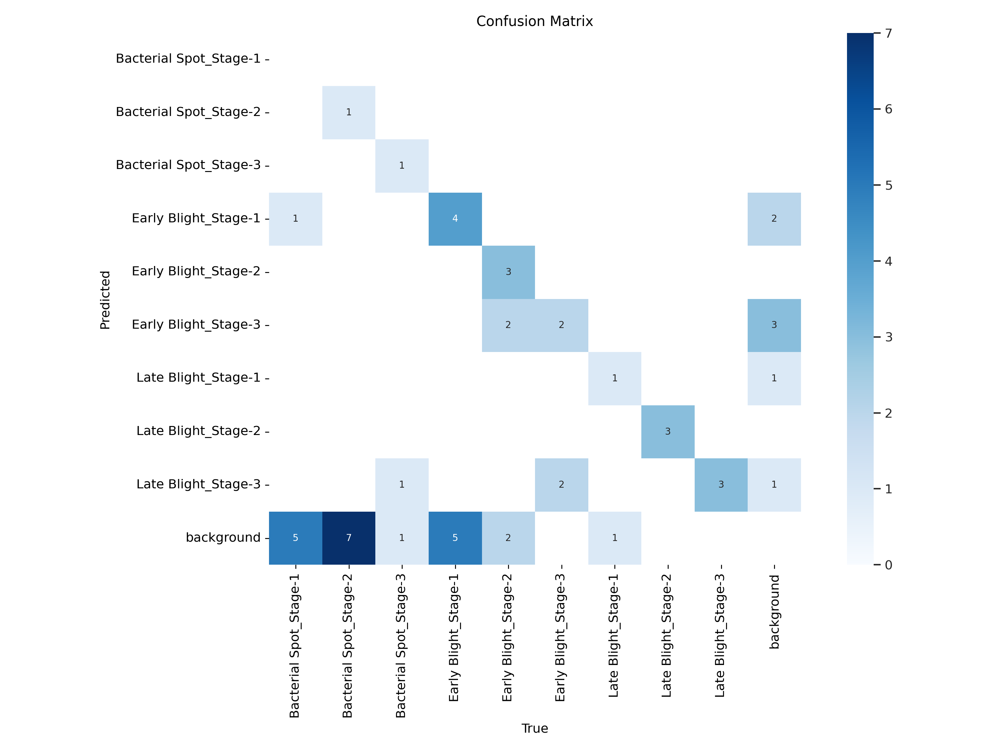

In [ ]:
from IPython.display import display, Image
Image(filename='runs/detect/train10/confusion_matrix.png', width=600)

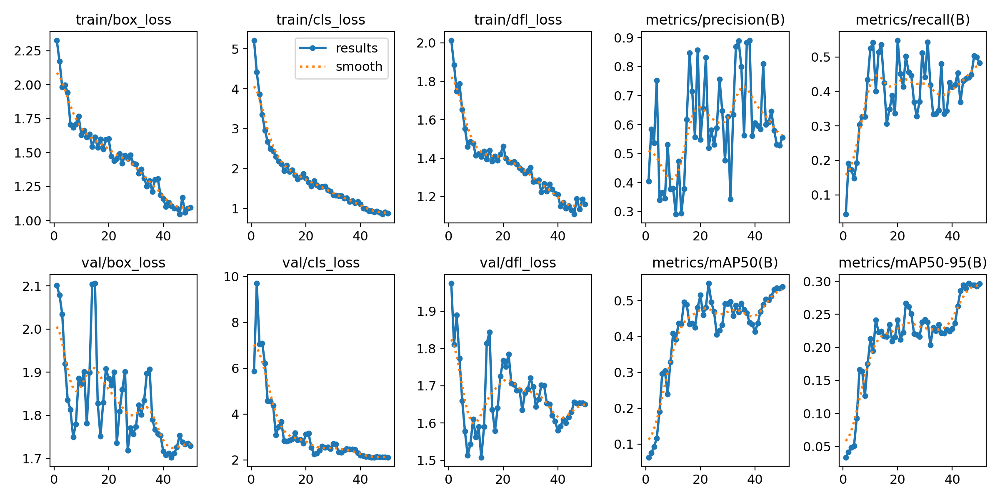

In [ ]:
Image(filename='runs/detect/train10/results.png', width=1200)

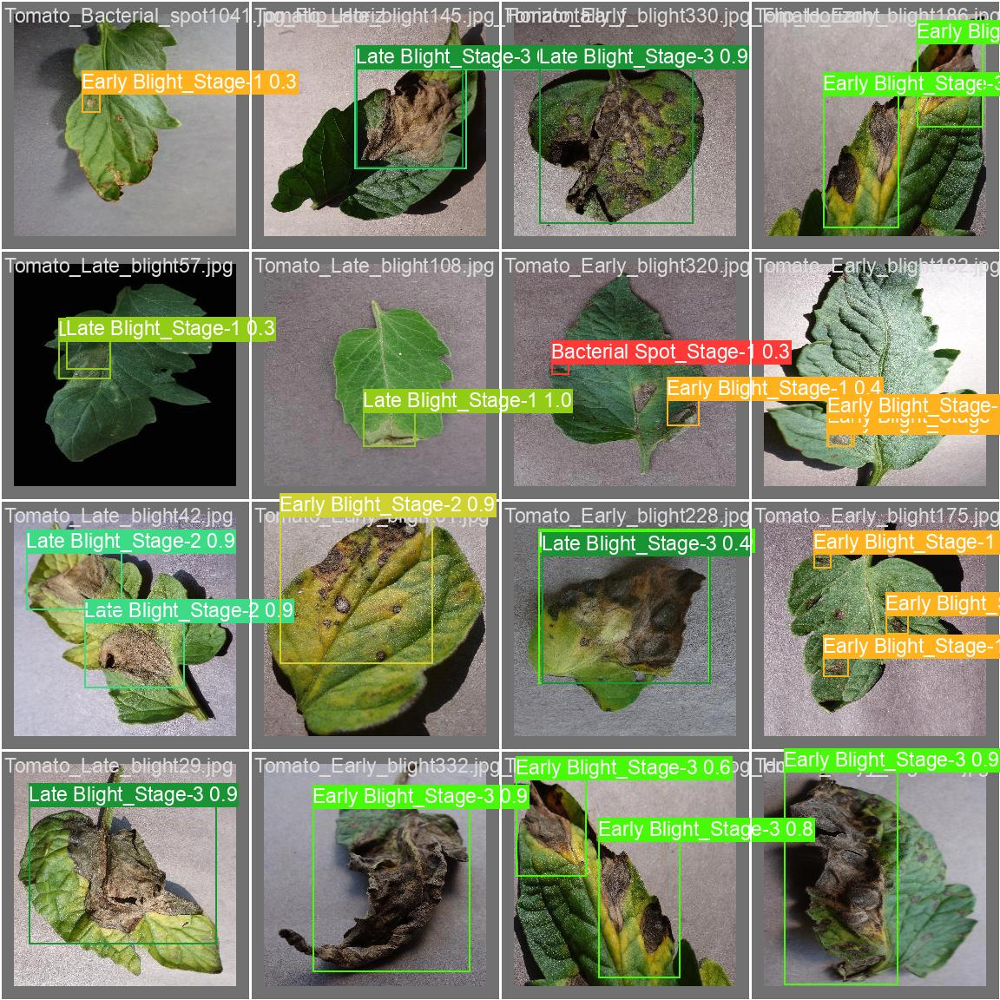

In [ ]:
Image(filename='runs/detect/train10/val_batch0_pred.jpg', width=1200)

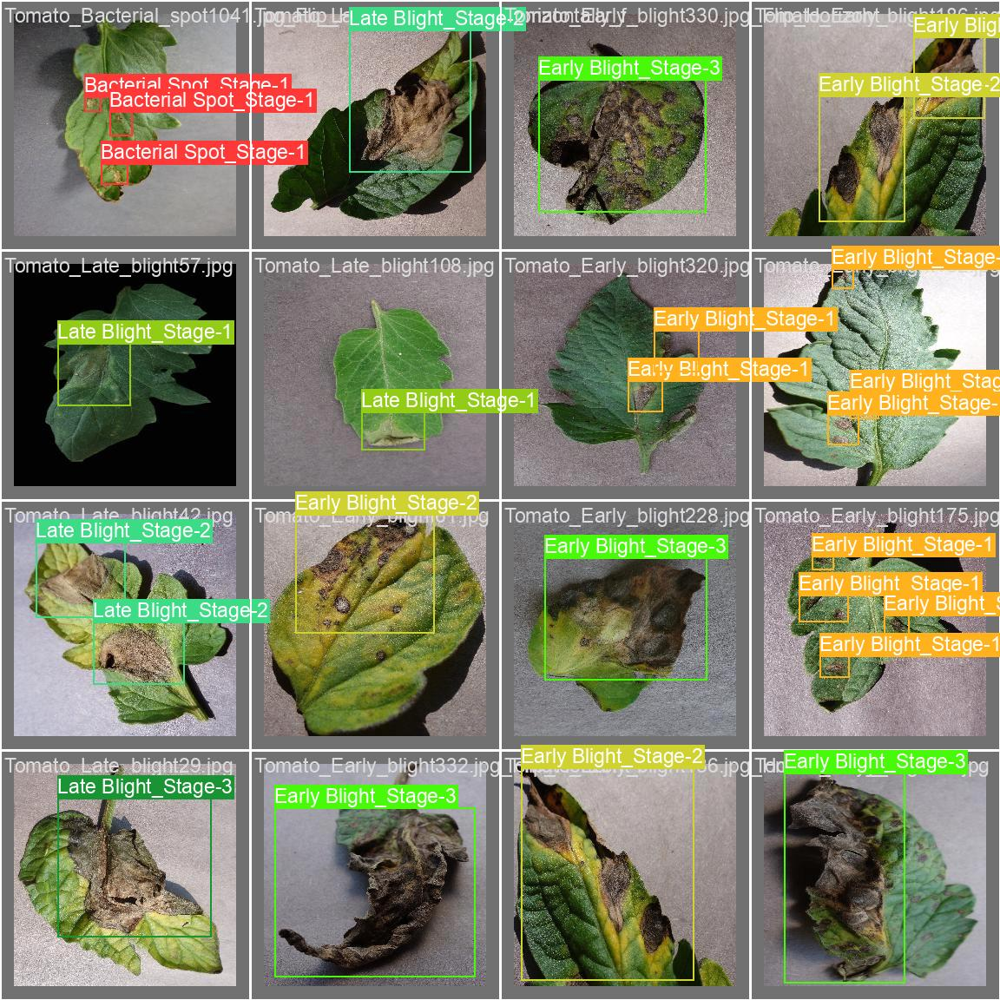

In [ ]:
Image(filename='runs/detect/train10/val_batch0_labels.jpg', width=1200)

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.8/750.8 kB 10.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
yolov8_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train10/weights/best.pt'

In [ ]:
from ultralytics import YOLO
from PIL import Image
import numpy as np

# Load the YOLOv8 models
leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train12/weights/best.pt'

leaf_detector = YOLO(leaf_detector_model_path)
disease_detector = YOLO(disease_detector_model_path)


In [ ]:
def calculate_iou(boxA, boxB):
    # Determine the coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # Compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # Compute the area of both the prediction and ground-truth rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    # Compute the intersection over union
    iou = interArea / float(boxAArea + boxBArea - interArea)

    return iou

# Function to classify the disease stage based on IoU
def classify_disease_stage(iou):
    if iou > 0.66:
        return "Stage 3"
    elif iou > 0.33:
        return "Stage 2"
    else:
        return "Stage 1"

In [ ]:
# Function to detect and classify disease stage
def detect_and_classify_disease_stage(image_path):
    # Detect leaves in the image
    leaf_results = leaf_detector(image_path)

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Move tensor to CPU and convert to NumPy array

        # Crop the leaf region from the image
        image = Image.open(image_path)
        leaf_region = image.crop((leaf_box[0], leaf_box[1], leaf_box[2], leaf_box[3]))
        leaf_region = np.array(leaf_region)

        # Detect diseases within the leaf region
        disease_results = disease_detector(leaf_region)

        total_disease_area = 0
        for disease in disease_results[0].boxes:
            disease_box = disease.xyxy[0].cpu().numpy()  # Move tensor to CPU and convert to NumPy array

            # Calculate IoU between the leaf box and each disease box
            iou = calculate_iou(leaf_box, disease_box)
            print(f"IoU between leaf and disease area: {iou:.2f}")

            # Sum the area of disease within the leaf
            disease_area = (disease_box[2] - disease_box[0]) * (disease_box[3] - disease_box[1])
            total_disease_area += disease_area

        # Calculate IoU of the leaf area with the total diseased area
        leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])
        iou = total_disease_area / leaf_area

        # Classify the disease stage based on IoU
        disease_stage = classify_disease_stage(iou)

        # Display results
        print(f"Detected Leaf Box: {leaf_box}")
        print(f"Total Disease IoU: {iou:.2f}")
        print(f"Disease Stage: {disease_stage}")
        return disease_stage


In [ ]:
# Main function to integrate all stages
def tomato_analysis_pipeline(image_path):
    # Stage I: Classification with custom InceptionV3
    predicted_class = classify_with_custom_inception(image_path)

    if predicted_class == 'Tomato_Healthy':
        display_image(image_path)
        print("HEALTHY PLANT")
        return

    elif predicted_class == 'Tomato_Stressed':
        display_image(image_path)
        print("STRESSED PLANT")
        return

    elif predicted_class == 'Tomato_Diseased':
        print("DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION")

        # Stage II & III: Leaf Detection, Disease Detection, and Stage Classification
        stage = detect_and_classify_disease_stage(image_path)
        print(f"Final Disease Stage: {stage}")


In [ ]:
from PIL import Image
from IPython.display import display
from ultralytics import YOLO

def detect_with_yolov8(yolov8_model_path, image_path):
  """
  Analyzes a tomato leaf image for disease using a YOLOv8 model and displays the results.

  Args:
      model_path (str): Path to the trained YOLOv8 model weights file.
      image_path (str): Path to the image to be analyzed.

  Returns:
      None
  """

  # Load the model
  yolov8_model = YOLO(yolov8_model_path)

  # Make predictions on the image
  results = yolov8_model(image_path)


  for i, r in enumerate(results):
    # Plot results image
    im_bgr = r.plot()  # BGR-order numpy array
    im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image

    # Convert image to displayable format in Colab
    display(im_rgb)

In [ ]:
def display_image(image_path):
    img = Image.open(image_path)
    display(img)

In [ ]:
# Main function to integrate both stages
def tomato_analysis_pipeline(image_path):
    # Stage 1: Classification with custom InceptionV3
    predicted_class = classify_with_custom_inception(image_path)

    if predicted_class == 'Tomato_Healthy':
        display_image(image_path)
        print("HEALTHY PLANT")
        return

    elif predicted_class == 'Tomato_Stressed':
        display_image(image_path)
        print("STRESSED PLANT")
        return

    elif predicted_class == 'Tomato_Diseased':
        print("DISEASED LEAF DETECTED: ACTIVATING STAGE II : DISEASE STAGE DETECTION")
        # Stage 2: Object Detection with YOLOv8
        detections = detect_with_yolov8(yolov8_model_path,image_path)
        # Process the detections and display results

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_Early_blight186.jpg_Horizontally_flip.jpg'

In [ ]:
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  4.1892e-08  3.6289e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_Early_blight186.jpg_Horizontally_flip.jpg: 256x256 1 Tomato_Leaf, 10.7ms
Speed: 1.0ms preprocess, 10.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_Stage-2, 7.3ms
Speed: 5.7ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
IoU between leaf and disease area: 0.03
Detected Leaf Box: [      2.045      7.4141      251.79         256]
Total Disease IoU: 0.03
Disease Stage: Stage 1
Final Disease Stage: Stage 1


In [ ]:
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import torch

# Function to calculate IoU
def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1_, y1_, x2_, y2_ = box2

    # Calculate intersection
    xi1 = max(x1, x1_)
    yi1 = max(y1, y1_)
    xi2 = min(x2, x2_)
    yi2 = min(y2, y2_)
    inter_area = max(0, xi2 - xi1 + 1) * max(0, yi2 - yi1 + 1)

    # Calculate union
    box1_area = (x2 - x1 + 1) * (y2 - y1 + 1)
    box2_area = (x2_ - x1_ + 1) * (y2_ - y1_ + 1)
    union_area = box1_area + box2_area - inter_area

    # Calculate IoU
    iou = inter_area / union_area
    return iou

In [ ]:
# Function to detect and classify disease stage

from PIL import Image
from IPython.display import display
from ultralytics import YOLO


def detect_and_classify_disease_stage(image_path):
    # Load the image
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')

    # Load YOLOv8 models
    leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
    disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/disease_detector/yolo_diseaseDetect_best.pt'

    leaf_model = YOLO(leaf_detector_model_path)
    disease_model = YOLO(disease_detector_model_path)

    # Stage 2: Leaf detection
    leaf_results = leaf_model(image_path)
    disease_stage = "Stage 1"  # Default stage

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Leaf bounding box coordinates

        # Crop the leaf region from the image
        cropped_leaf_image = image_rgb.crop(leaf_box)

        # Stage 3: Disease detection
        disease_results = disease_model(cropped_leaf_image)

        # Initialize variables to calculate total diseased area
        total_diseased_area = 0
        leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])

        # Draw bounding boxes on the original image
        draw = ImageDraw.Draw(image_rgb)
        draw.rectangle(leaf_box, outline="blue", width=3)  # Leaf bounding box

        for disease in disease_results[0].boxes:
            disease_box = disease.xyxy[0].cpu().numpy()
            draw.rectangle([leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1],
                            leaf_box[0] + disease_box[2], leaf_box[1] + disease_box[3]],
                           outline="red", width=3)  # Disease bounding box

            # Calculate disease area within the leaf box
            disease_area = (disease_box[2] - disease_box[0]) * (disease_box[3] - disease_box[1])
            total_diseased_area += disease_area

        # Calculate IoU between the leaf area and total diseased area
        iou = total_diseased_area / leaf_area

        # Determine disease stage based on IoU threshold
        if iou > 0.6:
            disease_stage = "Stage 3"
        elif iou > 0.2:
            disease_stage = "Stage 2"

        # Display the final stage for the detected leaf
        print(f"Detected leaf with disease stage: {disease_stage}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [ ]:
# Main function to integrate all stages
def tomato_analysis_pipeline(image_path):
    # Stage 1: Classification with custom InceptionV3
    predicted_class = classify_with_custom_inception(image_path)

    if predicted_class == 'Tomato_Healthy':
        display_image(image_path)
        print("HEALTHY PLANT")
        return

    elif predicted_class == 'Tomato_Stressed':
        display_image(image_path)
        print("STRESSED PLANT")
        return

    elif predicted_class == 'Tomato_Diseased':
        print("DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION")
        # Stage 2 & 3: Leaf detection, disease detection, and stage classification
        detect_and_classify_disease_stage(image_path)

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_Early_blight186.jpg_Horizontally_flip.jpg'

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
[[          1  4.1892e-08  3.6289e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_Early_blight186.jpg_Horizontally_flip.jpg: 256x256 1 Tomato_Leaf, 9.2ms
Speed: 0.7ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Stage-2s, 1 Early Blight_Stage-3, 7.7ms
Speed: 0.7ms preprocess, 7.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


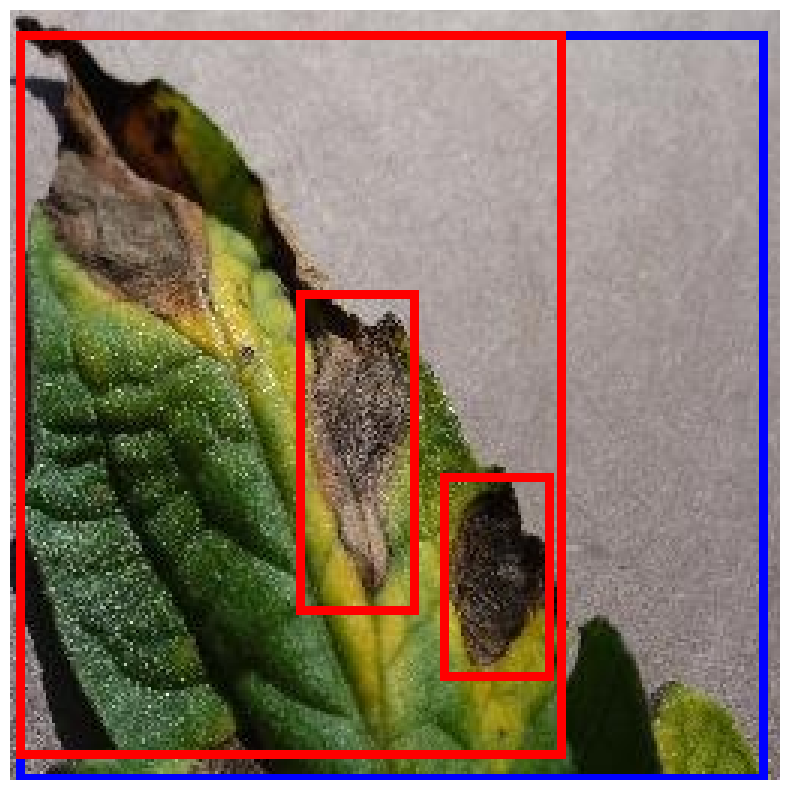

In [ ]:
tomato_analysis_pipeline(image_path)

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_53.jpg'

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  2.5532e-12   4.722e-23]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_53.jpg: 192x256 1 Tomato_Leaf, 8.2ms
Speed: 0.8ms preprocess, 8.2ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)

0: 192x256 1 Late Blight_Stage-1, 1 Late Blight_Stage-2, 12.3ms
Speed: 1.3ms preprocess, 12.3ms inference, 1.7ms postprocess per image at shape (1, 3, 192, 256)
Detected leaf with disease stage: Stage 2


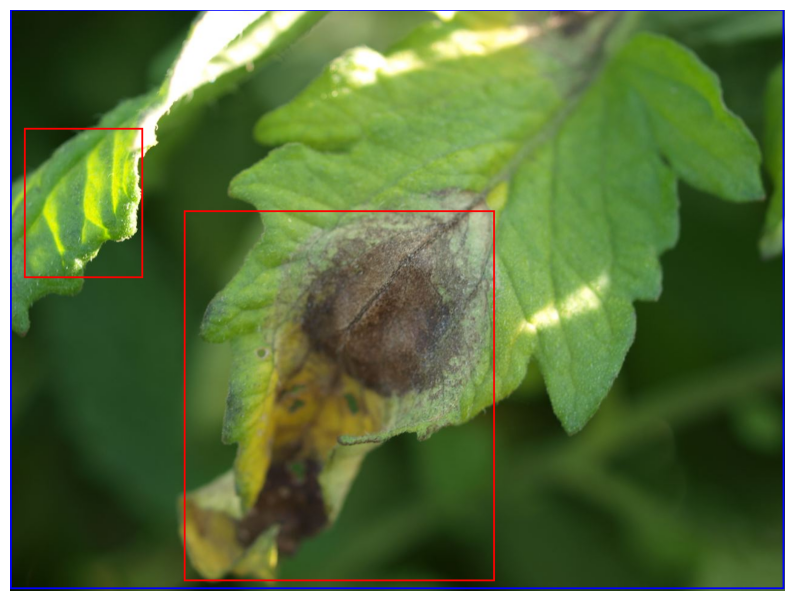

In [ ]:
tomato_analysis_pipeline(image_path)

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Late_blight108.jpg'

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
[[    0.99565   0.0043506  6.1755e-12]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Late_blight108.jpg: 256x256 1 Tomato_Leaf, 9.3ms
Speed: 0.7ms preprocess, 9.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_Stage-1, 94.0ms
Speed: 0.8ms preprocess, 94.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


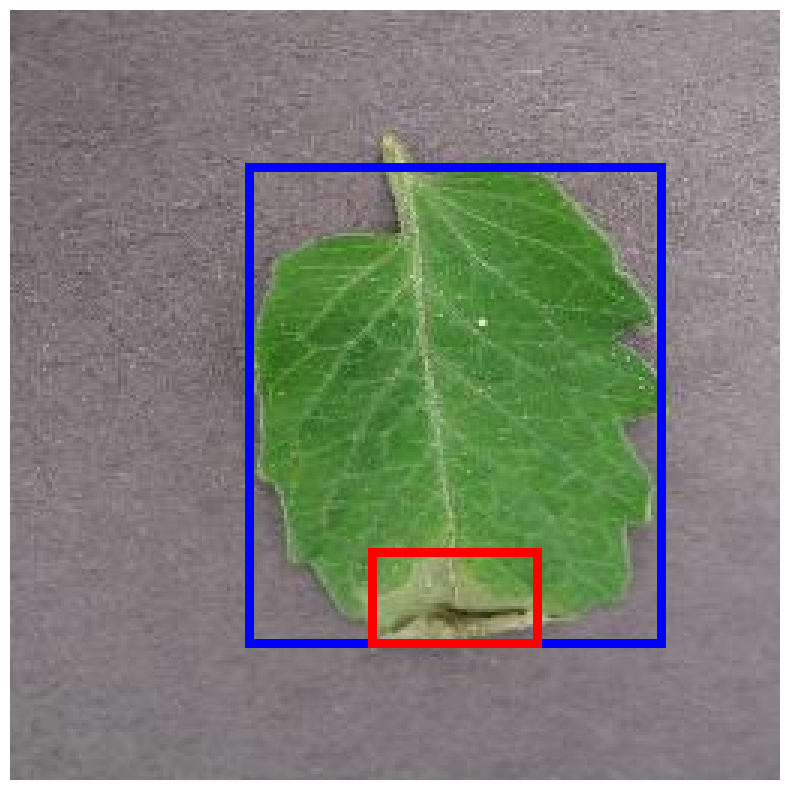

In [ ]:
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
[[          1  1.8544e-08  9.1875e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg: 256x256 1 Tomato_Leaf, 8.1ms
Speed: 0.7ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)

0: 256x192 9 Septoria Spot_Stage-1s, 68.5ms
Speed: 0.6ms preprocess, 68.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 1


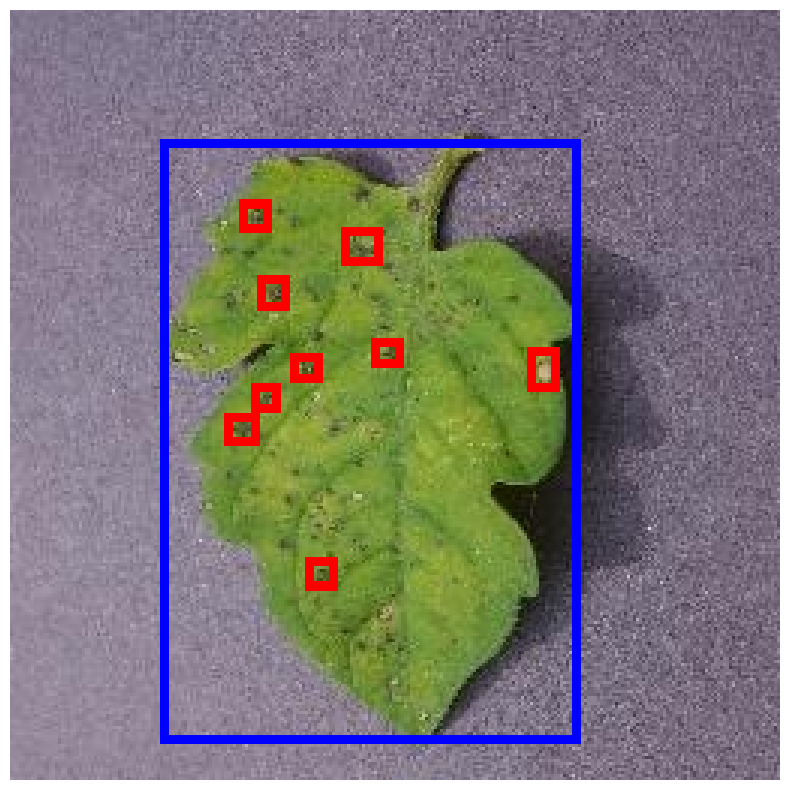

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  7.1642e-17  1.5658e-20]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II: LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg: 256x256 1 Tomato_Leaf, 8.7ms
Speed: 0.8ms preprocess, 8.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Septoria Spot_Stage-2s, 7.1ms
Speed: 0.7ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


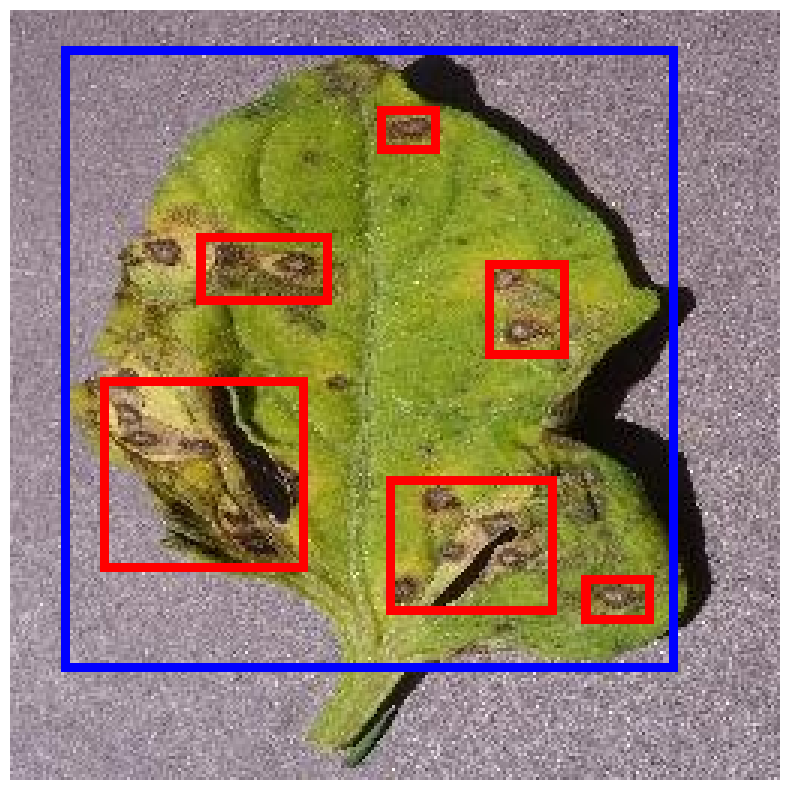

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg'
tomato_analysis_pipeline(image_path)

In [ ]:
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import torch

# Function to calculate IoU
def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1_, y1_, x2_, y2_ = box2

    # Calculate intersection
    xi1 = max(x1, x1_)
    yi1 = max(y1, y1_)
    xi2 = min(x2, x2_)
    yi2 = min(y2, y2_)
    inter_area = max(0, xi2 - xi1 + 1) * max(0, yi2 - yi1 + 1)

    # Calculate union
    box1_area = (x2 - x1 + 1) * (y2 - y1 + 1)
    box2_area = (x2_ - x1_ + 1) * (y2_ - y1_ + 1)
    union_area = box1_area + box2_area - inter_area

    # Calculate IoU
    iou = inter_area / union_area
    return iou

# Function to detect and classify disease stage

from PIL import Image
from IPython.display import display
from ultralytics import YOLO

def detect_and_classify_disease_stage(image_path):
    # Load the image
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')

    # Load YOLOv8 models
    leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
    disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/disease_detector/yolo_diseaseDetect_best.pt'

    leaf_model = YOLO(leaf_detector_model_path)
    disease_model = YOLO(disease_detector_model_path)

    # Stage 2: Leaf detection
    leaf_results = leaf_model(image_path)
    disease_stage = "Stage 1"  # Default stage

    draw = ImageDraw.Draw(image_rgb)
    font = ImageFont.load_default()

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Leaf bounding box coordinates

        # Draw leaf bounding box
        draw.rectangle(leaf_box, outline="white", width=3)
        draw.text((leaf_box[0], leaf_box[1] - 10), "LEAF AREA", fill="white", font=font)

        # Crop the leaf region from the image
        cropped_leaf_image = image_rgb.crop(leaf_box)

        # Stage 3: Disease detection
        disease_results = disease_model(cropped_leaf_image)

        # Initialize variables to calculate total diseased area
        total_diseased_area = 0
        leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])

        for disease in disease_results[0].boxes:
            disease_box = disease.xyxy[0].cpu().numpy()
            disease_label = disease.cls.cpu().numpy()  # Disease class label
            disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label

            # Draw bounding box for the disease
            draw.rectangle([leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1],
                            leaf_box[0] + disease_box[2], leaf_box[1] + disease_box[3]],
                           outline="red", width=2)
            draw.text((leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1] - 10),
                      f"{disease_name}", fill="red", font=font)

            # Calculate disease area within the leaf box
            disease_area = (disease_box[2] - disease_box[0]) * (disease_box[3] - disease_box[1])
            total_diseased_area += disease_area

        # Calculate IoU between the leaf area and total diseased area
        iou = total_diseased_area / leaf_area

        # Determine disease stage based on IoU threshold
        if iou > 0.5:
            disease_stage = "Stage 3"
        elif iou > 0.2:
            disease_stage = "Stage 2"

        # Overlay the disease stage prominently below the image
        draw.text((image_rgb.width // 2 - 50, image_rgb.height - 30),
                  f"Disease at {disease_stage}", fill="yellow", font=font)

        # Display the final stage for the detected leaf
        print(f"Detected leaf with disease stage: {disease_stage}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

# Main function to integrate all stages
def tomato_analysis_pipeline(image_path):
    # Stage 1: Classification with custom InceptionV3
    predicted_class = classify_with_custom_inception(image_path)

    if predicted_class == 'Tomato_Healthy':
        display_image(image_path)
        print("HEALTHY PLANT")
        return

    elif predicted_class == 'Tomato_Stressed':
        display_image(image_path)
        print("STRESSED PLANT")
        return

    elif predicted_class == 'Tomato_Diseased':
        print("DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION")
        # Stage 2 & 3: Leaf detection, disease detection, and stage classification
        detect_and_classify_disease_stage(image_path)


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  1.8544e-08  9.1875e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg: 256x256 1 Tomato_Leaf, 9.3ms
Speed: 0.7ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x192 6 Septoria Spot_Stage-1s, 7.7ms
Speed: 0.5ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 1


<ipython-input-64-e43a8885d281>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


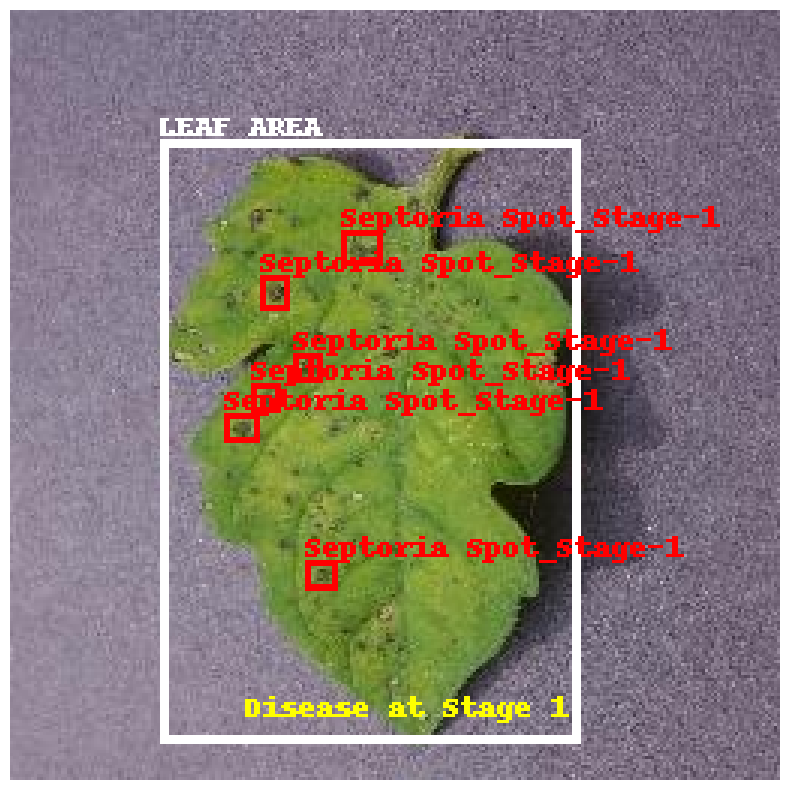

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
[[          1  7.1642e-17  1.5658e-20]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg: 256x256 1 Tomato_Leaf, 7.7ms
Speed: 0.6ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Septoria Spot_Stage-2s, 7.1ms
Speed: 0.7ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-64-e43a8885d281>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


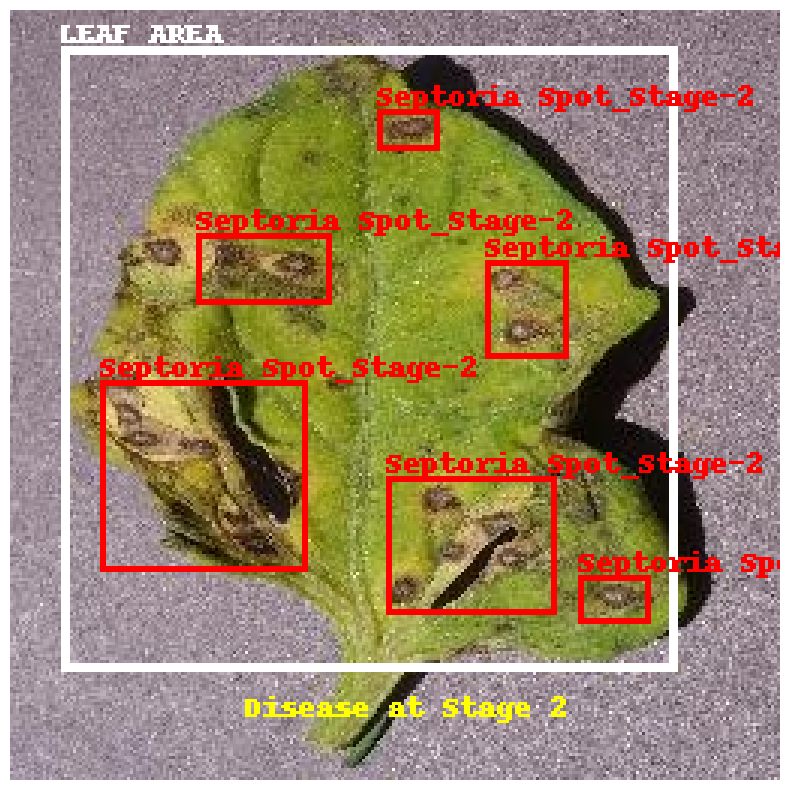

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  2.5532e-12   4.722e-23]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_53.jpg: 192x256 1 Tomato_Leaf, 14.8ms
Speed: 1.3ms preprocess, 14.8ms inference, 2.0ms postprocess per image at shape (1, 3, 192, 256)

0: 192x256 2 Late Blight_Stage-1s, 1 Late Blight_Stage-2, 9.9ms
Speed: 1.0ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 192, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-64-e43a8885d281>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


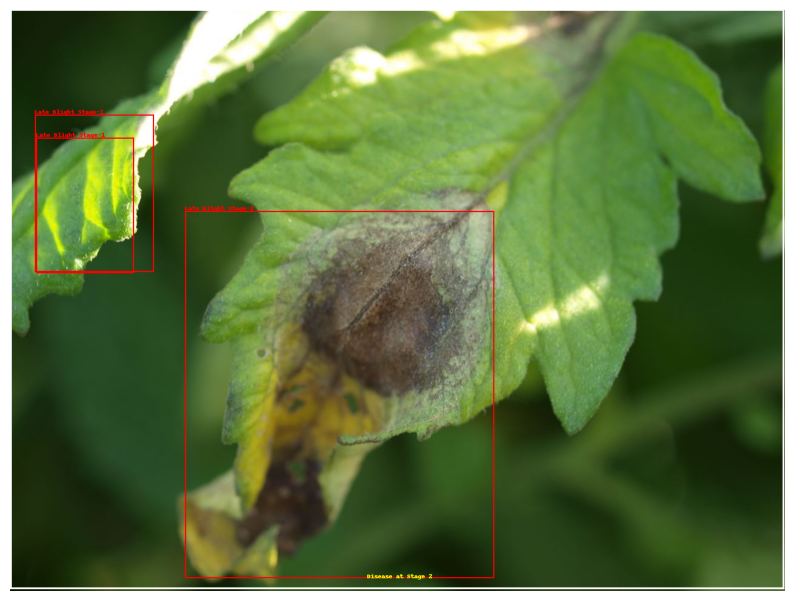

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_53.jpg'
tomato_analysis_pipeline(image_path)

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_leaf_yellow_16.jpg'

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
[[          1  1.8544e-08  9.1875e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg: 256x256 1 Tomato_Leaf, 9.2ms
Speed: 0.7ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x192 6 Septoria Spot_Stage-1s, 7.7ms
Speed: 0.6ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 1


<ipython-input-56-256b1b9bc553>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


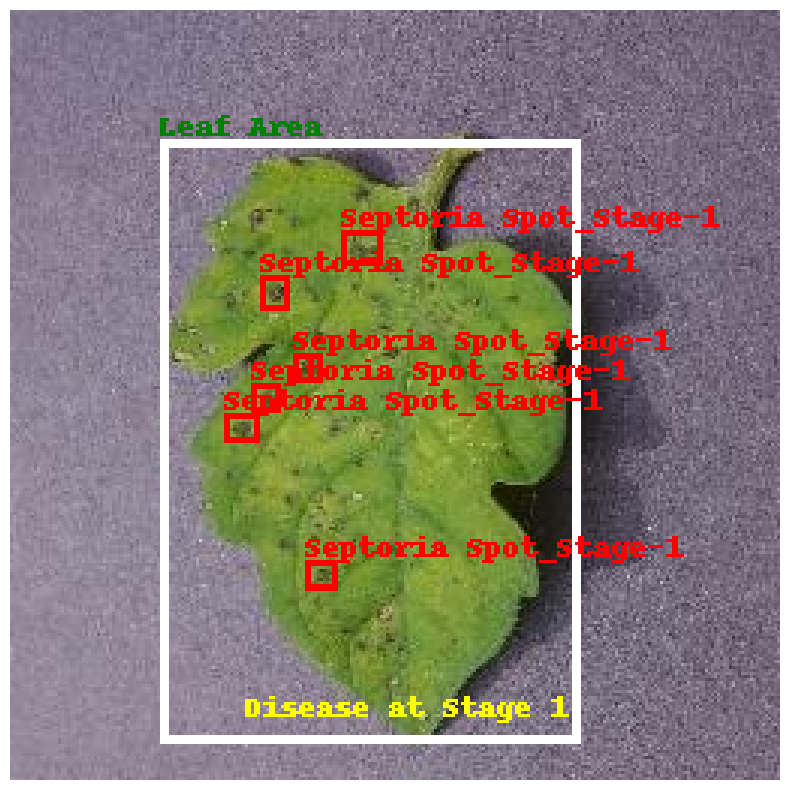

In [ ]:
from PIL import Image
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  1.8428e-16  4.8877e-17]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Bacterial_spot270.jpg: 256x256 1 Tomato_Leaf, 7.9ms
Speed: 0.7ms preprocess, 7.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_Stage-3, 11.1ms
Speed: 0.9ms preprocess, 11.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


<ipython-input-64-e43a8885d281>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


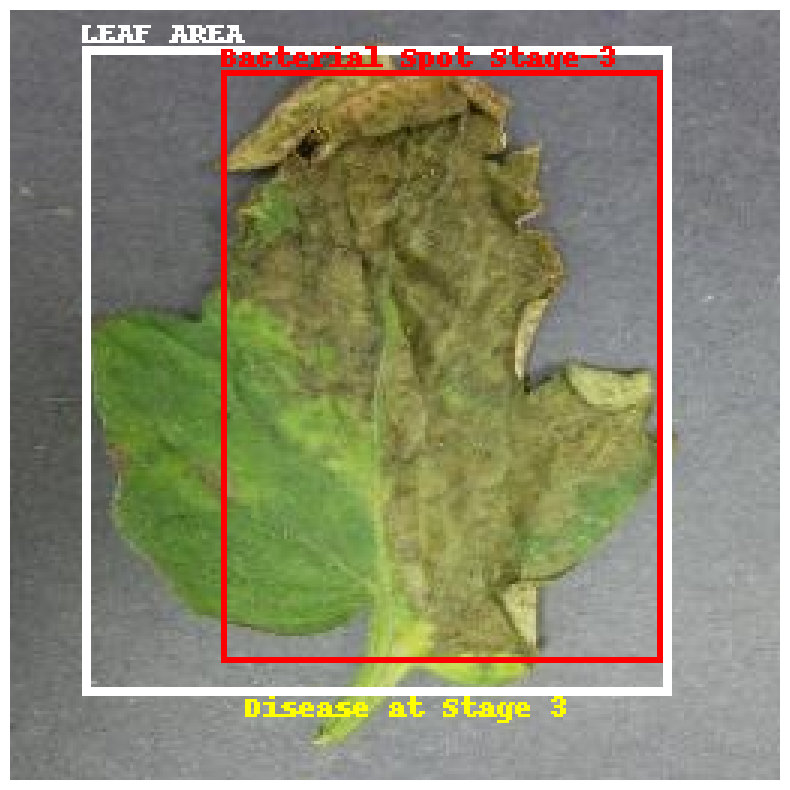

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Bacterial_spot270.jpg'
tomato_analysis_pipeline(image_path)

1/1 [==============================] - 2s 2s/step
[[          1  1.8543e-08  9.1873e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg: 256x256 1 Tomato_Leaf, 279.7ms
Speed: 7.7ms preprocess, 279.7ms inference, 32.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x192 4 Septoria Spot_As, 115.9ms
Speed: 11.3ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 1


<ipython-input-17-cb6ceaa99183>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


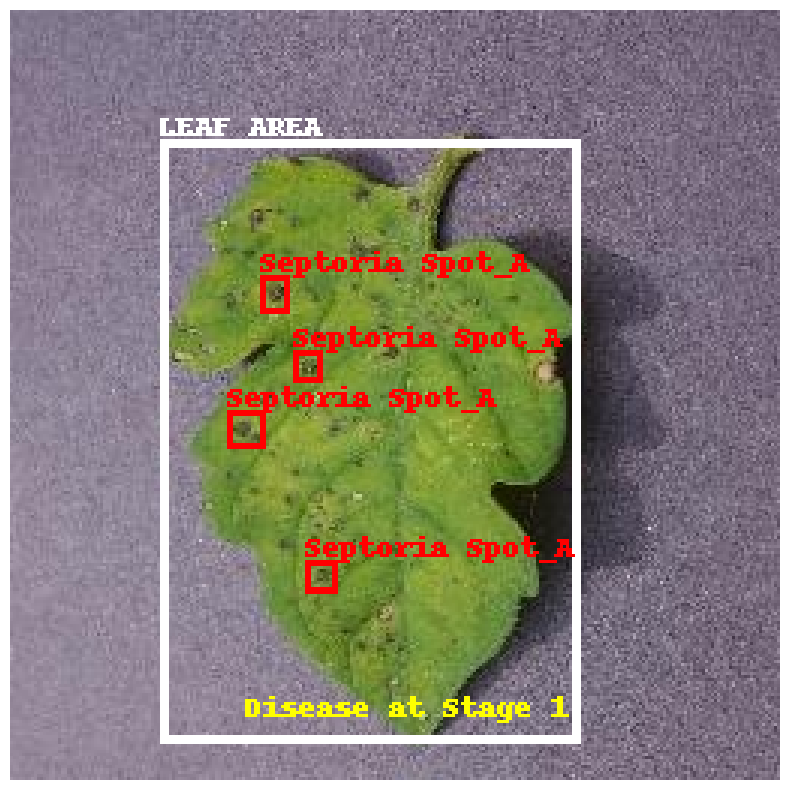

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot59.jpg'
tomato_analysis_pipeline(image_path)

1/1 [==============================] - 2s 2s/step
[[          1  7.1642e-17  1.5658e-20]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg: 256x256 1 Tomato_Leaf, 265.8ms
Speed: 0.9ms preprocess, 265.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Septoria Spot_Bs, 182.3ms
Speed: 1.1ms preprocess, 182.3ms inference, 4.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-17-cb6ceaa99183>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


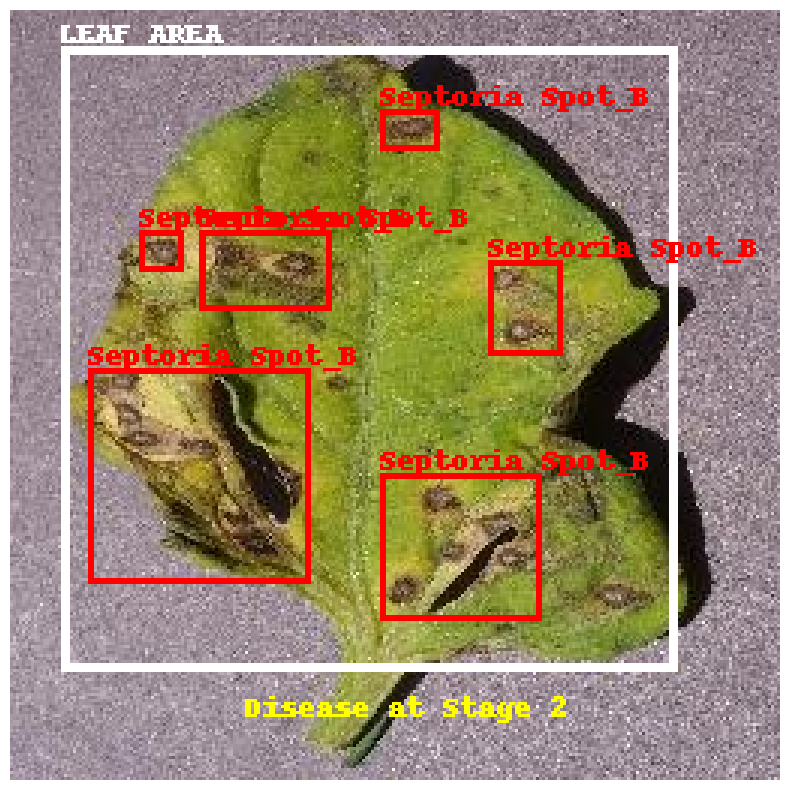

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot918.jpg'
tomato_analysis_pipeline(image_path)

1/1 [==============================] - 2s 2s/step
[[          1  2.9949e-09  2.6619e-16]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Late_blight42.jpg: 256x256 1 Tomato_Leaf, 256.1ms
Speed: 0.8ms preprocess, 256.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Late Blight_Bs, 190.4ms
Speed: 1.1ms preprocess, 190.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-17-cb6ceaa99183>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


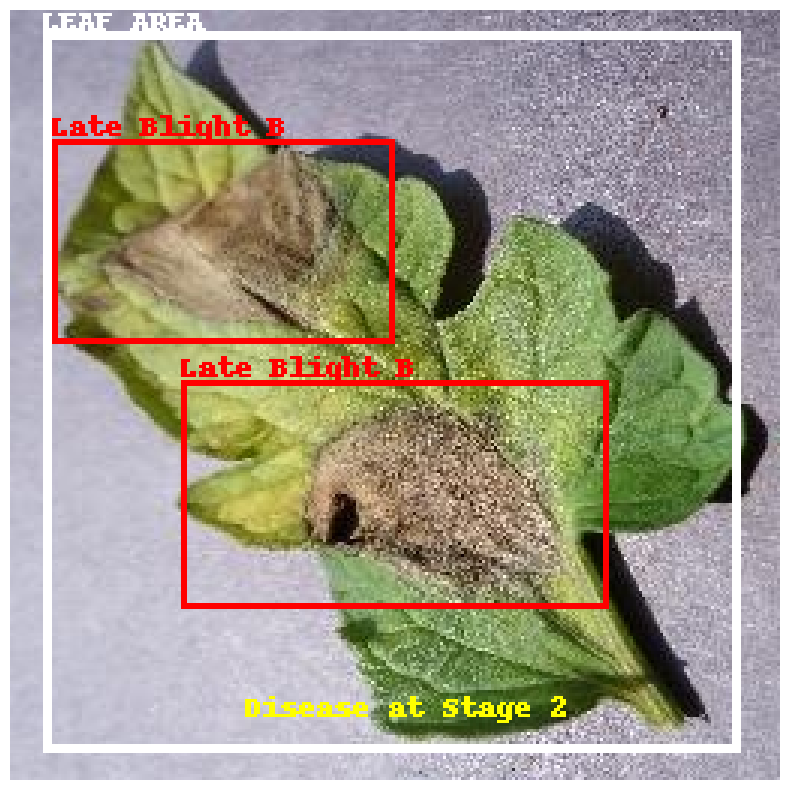

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Late_blight42.jpg'
tomato_analysis_pipeline(image_path)

1/1 [==============================] - 2s 2s/step
[[    0.99844    0.001559  1.1312e-16]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Early_blight186.jpg: 256x256 1 Tomato_Leaf, 168.7ms
Speed: 0.9ms preprocess, 168.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Early Blight_Bs, 1 Early Blight_C, 128.8ms
Speed: 1.8ms preprocess, 128.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-23-693374b388c7>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


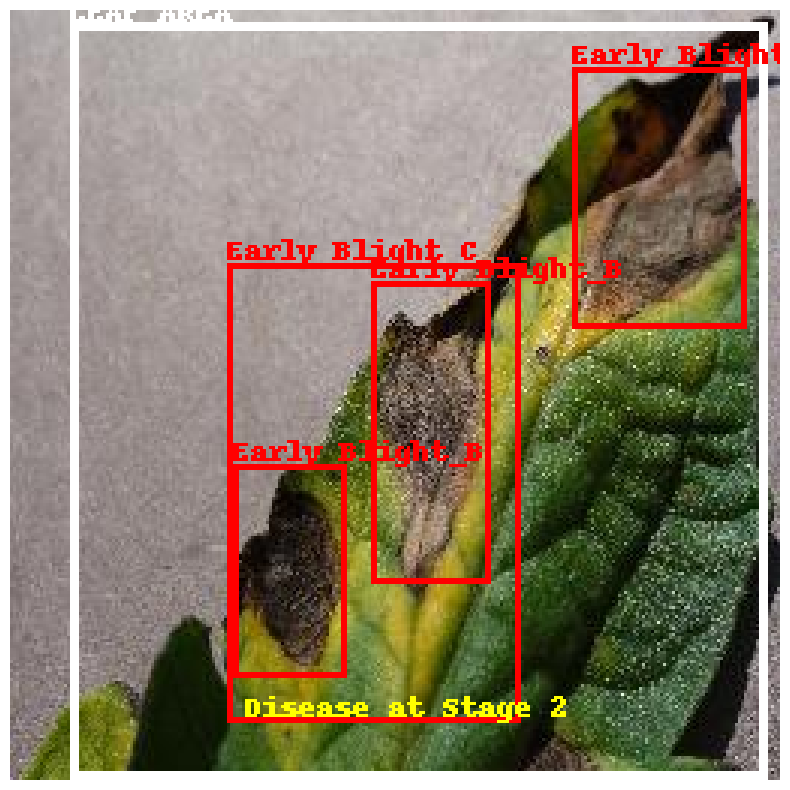

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Early_blight186.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  6.8729e-11  1.9363e-08]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_6.jpg: 224x256 2 Tomato_Leafs, 106.0ms
Speed: 1.5ms preprocess, 106.0ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)

0: 256x160 2 Late Blight_Cs, 84.9ms
Speed: 0.9ms preprocess, 84.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)
Detected leaf with disease stage: Stage 2

0: 256x192 2 Late Blight_Bs, 107.4ms
Speed: 1.7ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 2


<ipython-input-12-693374b388c7>:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


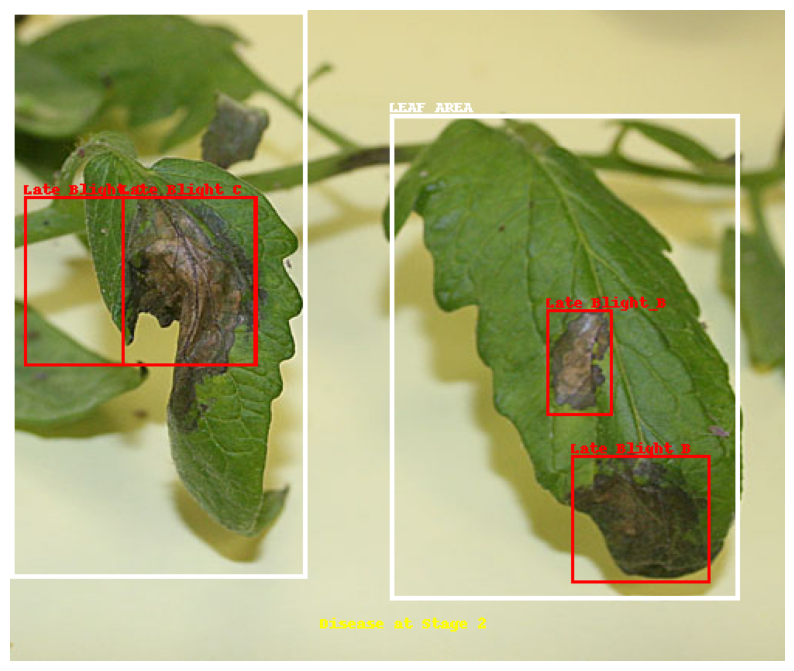

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_6.jpg'
tomato_analysis_pipeline(image_path)

In [ ]:
def detect_and_classify_disease_stage(image_path):
    # Load the image
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')

    # Load YOLOv8 models
    leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
    disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/disease_detector/yolo_diseaseDetect_best.pt'

    leaf_model = YOLO(leaf_detector_model_path)
    disease_model = YOLO(disease_detector_model_path)

    # Stage 2: Leaf detection
    leaf_results = leaf_model(image_path)

    draw = ImageDraw.Draw(image_rgb)
    font = ImageFont.load_default()

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Leaf bounding box coordinates

        # Draw leaf bounding box
        draw.rectangle(leaf_box, outline="white", width=3)
        draw.text((leaf_box[0], leaf_box[1] - 10), "LEAF AREA", fill="white", font=font)

        # Crop the leaf region from the image
        cropped_leaf_image = image_rgb.crop(leaf_box)

        # Stage 3: Disease detection
        disease_results = disease_model(cropped_leaf_image)

        # Initialize variables to calculate total diseased area
        total_diseased_area = 0
        leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])

        for disease in disease_results[0].boxes:
            disease_box = disease.xyxy[0].cpu().numpy()
            disease_label = disease.cls.cpu().numpy()  # Disease class label
            disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label

            # Draw bounding box for the disease
            draw.rectangle([leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1],
                            leaf_box[0] + disease_box[2], leaf_box[1] + disease_box[3]],
                           outline="red", width=2)
            draw.text((leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1] - 10),
                      f"{disease_name}", fill="red", font=font)

            # Calculate disease area within the leaf box
            disease_area = (disease_box[2] - disease_box[0]) * (disease_box[3] - disease_box[1])
            total_diseased_area += disease_area

        # Calculate IoU between the leaf area and total diseased area
        iou = total_diseased_area / leaf_area

        # Determine disease stage based on IoU threshold
        if iou > 0.4:
            disease_stage = "Stage 3"
        elif iou > 0.15:
            disease_stage = "Stage 2"
        else:
            disease_stage = "Stage 1"

        # Overlay the disease stage near the detected leaf
        draw.text((leaf_box[0], leaf_box[3] + 10),
                  f"Disease Stage: {disease_stage}", fill="yellow", font=font)

        # Display the final stage for the detected leaf
        print(f"Detected leaf with disease stage: {disease_stage}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
[[          1  6.8729e-11  1.9363e-08]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_6.jpg: 224x256 2 Tomato_Leafs, 101.4ms
Speed: 2.1ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)

0: 256x160 2 Late Blight_Cs, 79.7ms
Speed: 0.9ms preprocess, 79.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)
Detected leaf with disease stage: Stage 2

0: 256x192 2 Late Blight_Bs, 95.4ms
Speed: 1.1ms preprocess, 95.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 1


<ipython-input-28-93c13f9adf99>:39: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


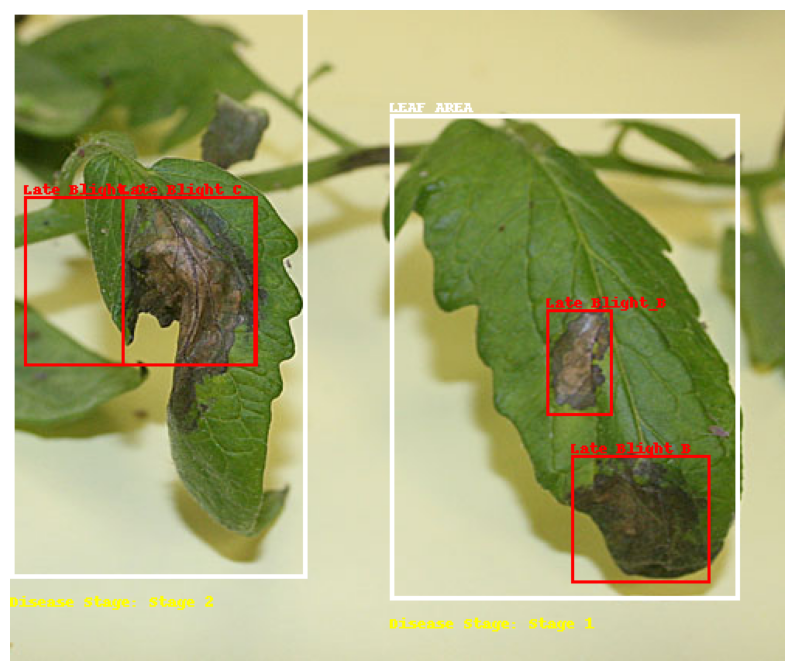

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_leaf_late_blight_6.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
[[    0.99965  0.00034854  1.5441e-16]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Early_blight_leaf_37.jpg: 256x224 1 Tomato_Leaf, 105.4ms
Speed: 1.2ms preprocess, 105.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)

0: 256x224 2 Early Blight_Bs, 1 Late Blight_C, 158.3ms
Speed: 1.4ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


<ipython-input-21-82d79aa97f11>:39: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


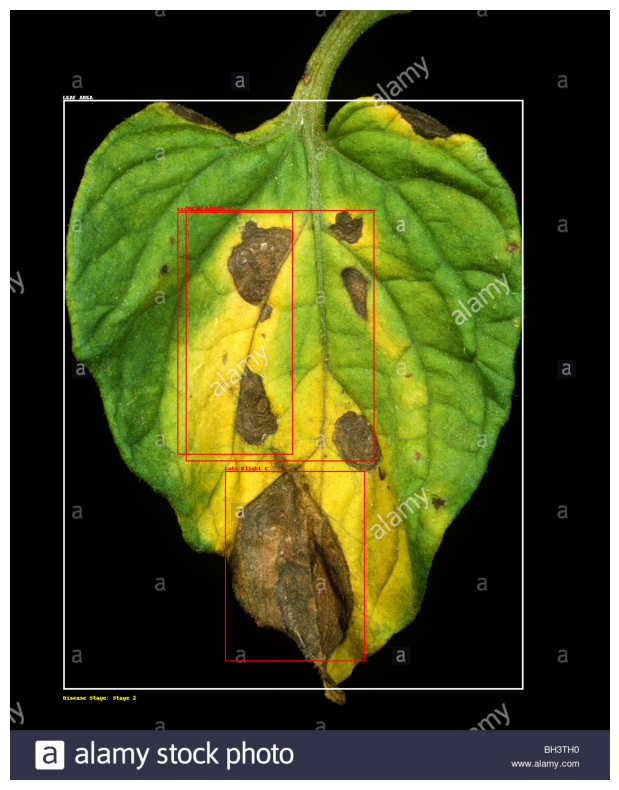

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Early_blight_leaf_37.jpg'
tomato_analysis_pipeline(image_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
[[          1   1.125e-29  4.2633e-28]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II & STAGE III : LEAF DETECTION, DISEASE DETECTION, AND STAGE CLASSIFICATION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot11.jpg: 256x256 1 Tomato_Leaf, 119.8ms
Speed: 1.1ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x192 2 Septoria Spot_Cs, 86.0ms
Speed: 1.3ms preprocess, 86.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)
Detected leaf with disease stage: Stage 2


<ipython-input-28-93c13f9adf99>:39: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


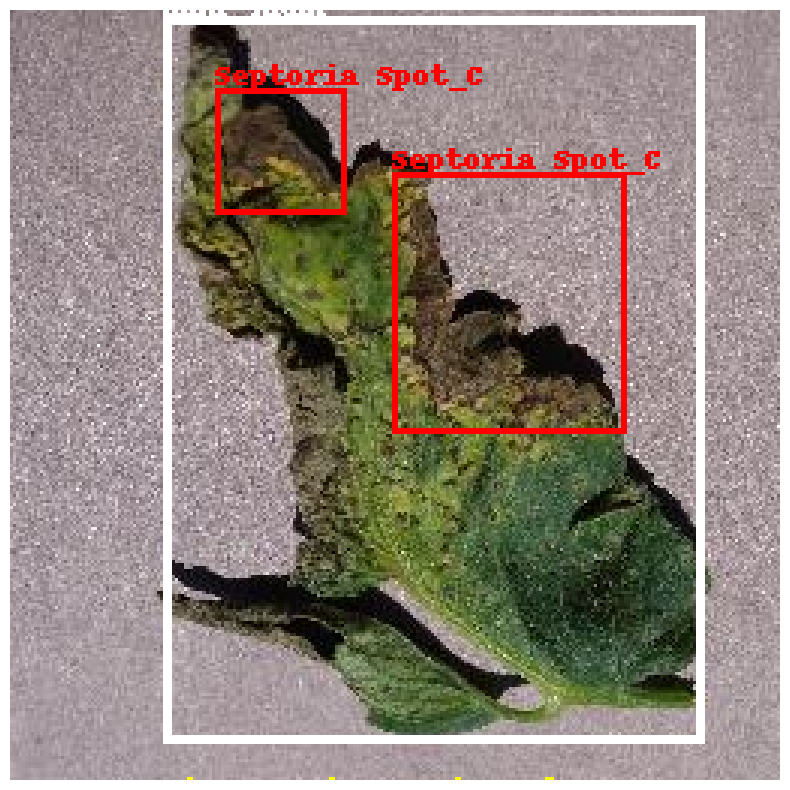

In [ ]:
image_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/Test Images/Tomato_Septoria_leaf_spot11.jpg'
tomato_analysis_pipeline(image_path)

Processing Tomato_Septoria_leaf_spot72.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot72.jpg: 256x256 1 Tomato_Leaf, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_Cs, 160.6ms
Speed: 1.2ms preprocess, 160.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-32-9e62b76261d0>:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


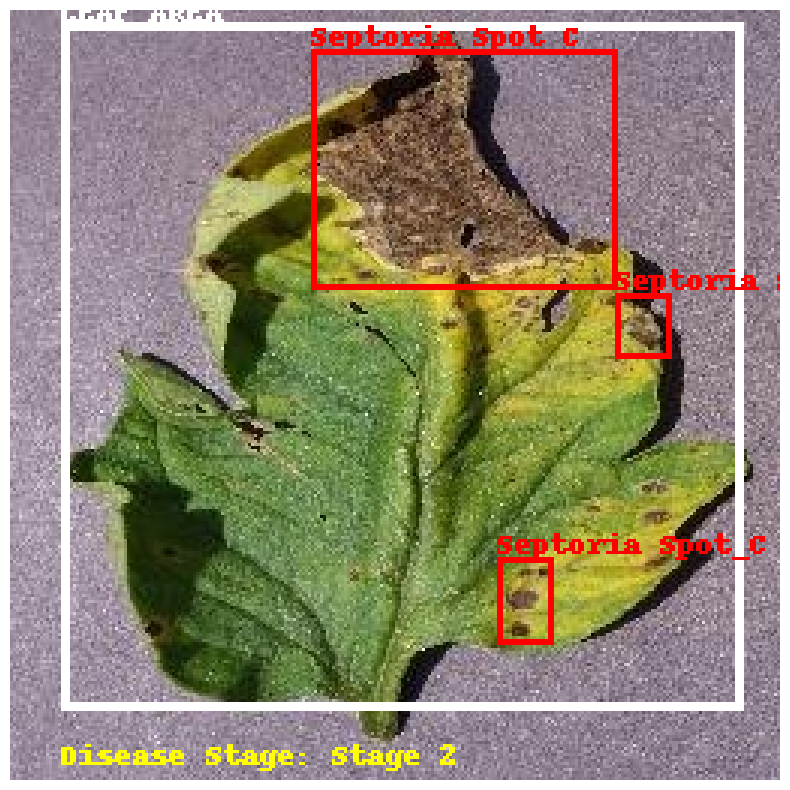

Processing Tomato_Late_blight81.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight81.jpg: 256x256 1 Tomato_Leaf, 197.9ms
Speed: 2.0ms preprocess, 197.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_B, 108.0ms
Speed: 1.6ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


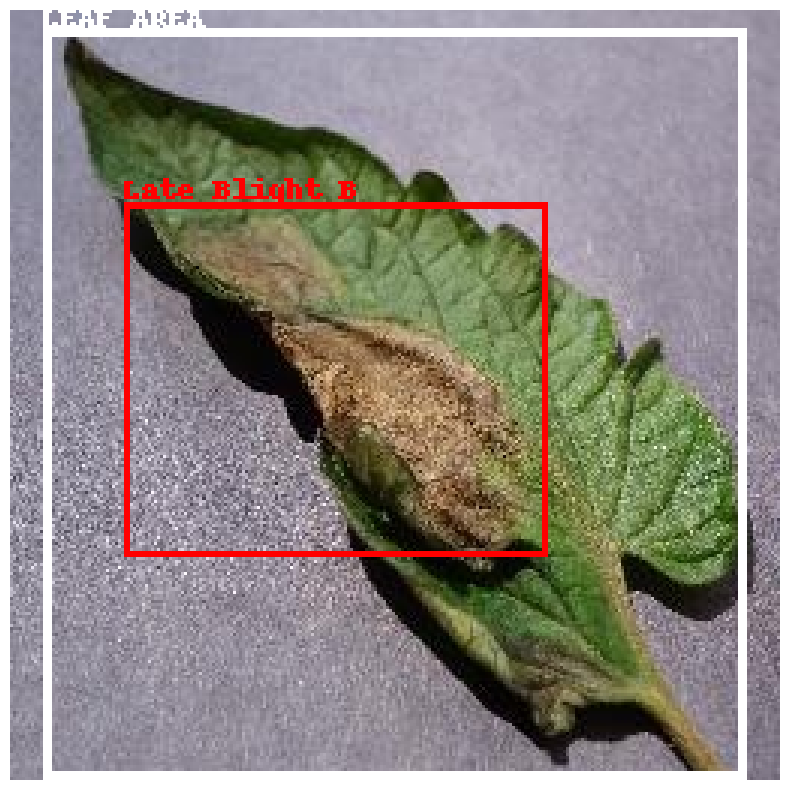

Processing Tomato_Septoria_leaf_spot16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot16.jpg: 256x256 1 Tomato_Leaf, 108.7ms
Speed: 0.7ms preprocess, 108.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_As, 109.3ms
Speed: 1.1ms preprocess, 109.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


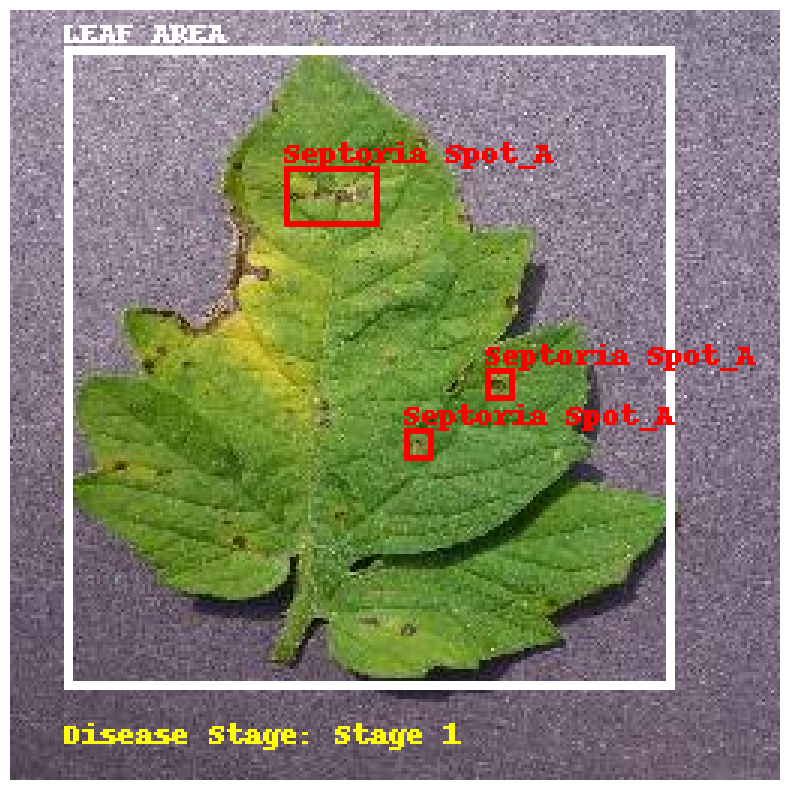

Processing Tomato_Septoria_leaf_spot53.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot53.jpg: 256x256 1 Tomato_Leaf, 107.4ms
Speed: 1.0ms preprocess, 107.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Septoria Spot_As, 108.7ms
Speed: 1.1ms preprocess, 108.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


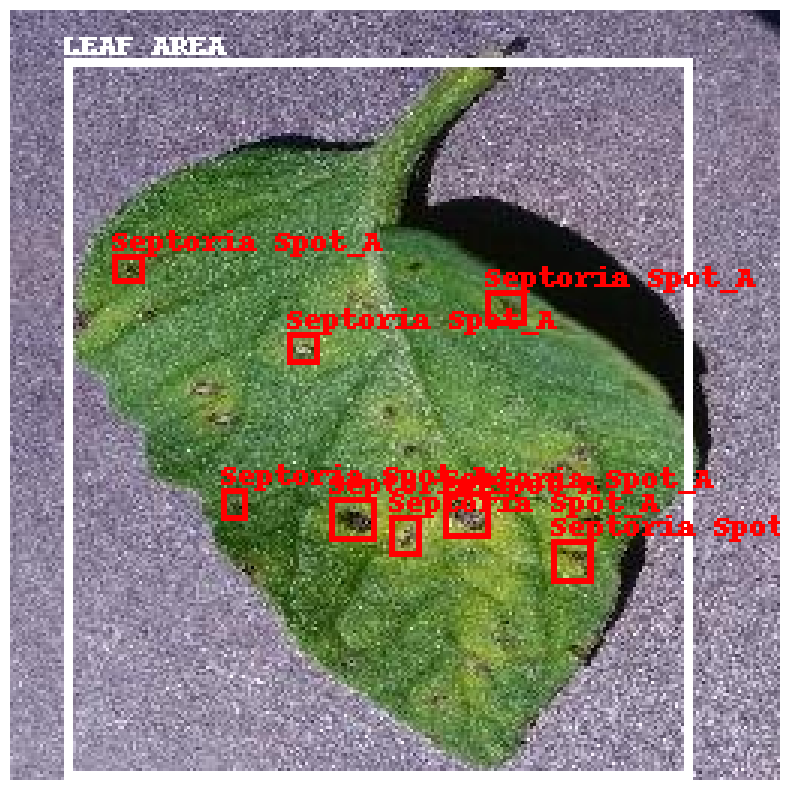

Processing Tomato_Septoria_leaf_spot432.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot432.jpg: 256x256 1 Tomato_Leaf, 170.7ms
Speed: 0.9ms preprocess, 170.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 154.9ms
Speed: 1.1ms preprocess, 154.9ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 3


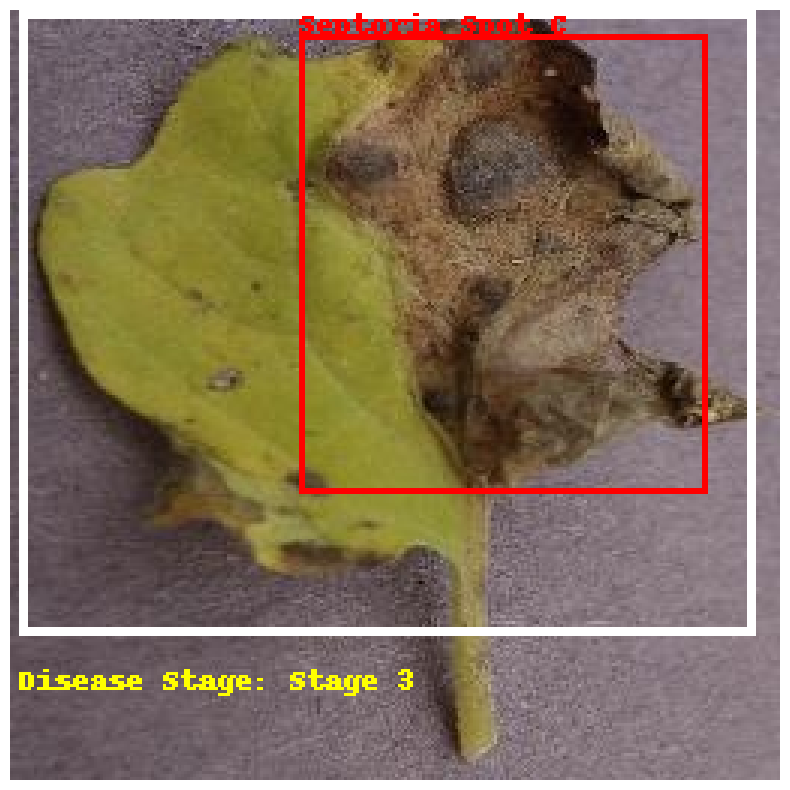

Processing Tomato_Late_blight571.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight571.jpg: 256x256 1 Tomato_Leaf, 191.0ms
Speed: 0.9ms preprocess, 191.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 117.9ms
Speed: 2.1ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


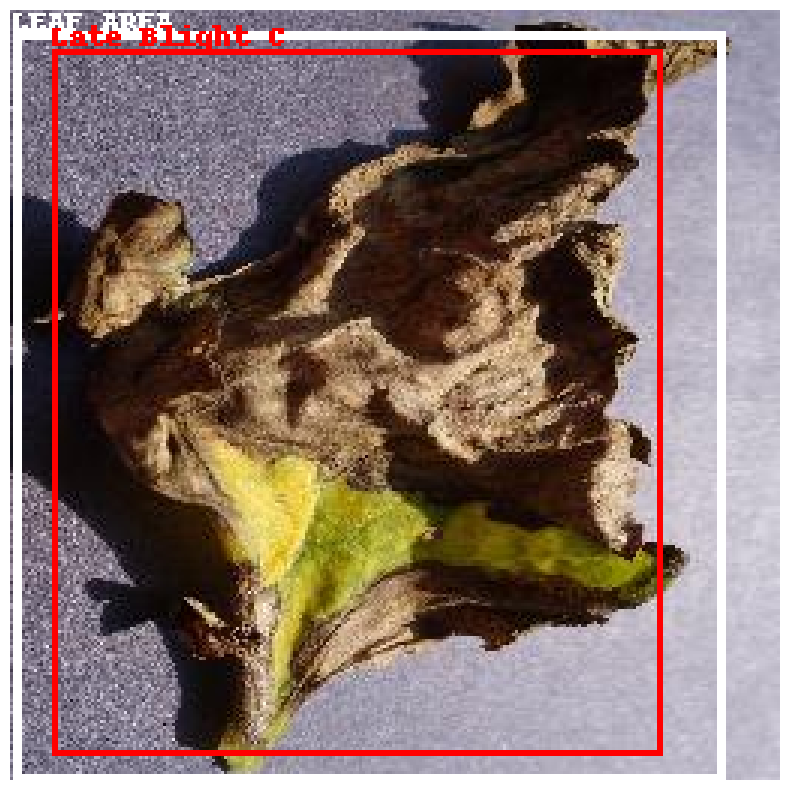

Processing Tomato_Late_blight47.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight47.jpg: 256x256 1 Tomato_Leaf, 110.5ms
Speed: 1.1ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 (no detections), 118.0ms
Speed: 1.1ms preprocess, 118.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


IndexError: list index out of range

In [ ]:
import os
import numpy as np
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, precision_recall_fscore_support
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

def evaluate_pipeline_on_test_images(test_folder):
    ground_truth_stages = []
    predicted_stages = []

    # Iterate over each image in the test folder
    for filename in os.listdir(test_folder):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            image_path = os.path.join(test_folder, filename)
            print(f"Processing {filename}...")

            # Use the pipeline function to get predictions
            image_ground_truth, image_predicted = detect_and_classify_disease_stage(image_path)

            # Collect the ground truth and predicted stages
            ground_truth_stages.extend(image_ground_truth)
            predicted_stages.extend(image_predicted)

    # Evaluate performance
    accuracy = accuracy_score(ground_truth_stages, predicted_stages)
    conf_matrix = confusion_matrix(ground_truth_stages, predicted_stages, labels=['Stage 1', 'Stage 2', 'Stage 3'])
    report = classification_report(ground_truth_stages, predicted_stages, target_names=['Stage 1', 'Stage 2', 'Stage 3'])

    print(f"Accuracy: {accuracy}")
    print(f"Confusion Matrix:\n{conf_matrix}")
    print(f"Classification Report:\n{report}")

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=['Stage 1', 'Stage 2', 'Stage 3'], yticklabels=['Stage 1', 'Stage 2', 'Stage 3'])
    plt.xlabel('Predicted Stage')
    plt.ylabel('True Stage')
    plt.title('Confusion Matrix')
    plt.show()

def detect_and_classify_disease_stage(image_path):
    # Load the image
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')

    # Load YOLOv8 models
    leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
    disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/disease_detector/yolo_diseaseDetect_best.pt'

    leaf_model = YOLO(leaf_detector_model_path)
    disease_model = YOLO(disease_detector_model_path)

    # Stage 2: Leaf detection
    leaf_results = leaf_model(image_path)

    draw = ImageDraw.Draw(image_rgb)
    font = ImageFont.load_default()

    ground_truth_stages = []
    predicted_stages = []

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Leaf bounding box coordinates

        # Draw leaf bounding box
        draw.rectangle(leaf_box, outline="white", width=3)
        draw.text((leaf_box[0], leaf_box[1] - 10), "LEAF AREA", fill="white", font=font)

        # Crop the leaf region from the image
        cropped_leaf_image = image_rgb.crop(leaf_box)

        # Stage 3: Disease detection
        disease_results = disease_model(cropped_leaf_image)

        disease_classes = []
        for disease in disease_results[0].boxes:
            disease_label = disease.cls.cpu().numpy()  # Disease class label
            disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label

            # Record the disease class name
            disease_classes.append(disease_name)

            # Draw bounding box for the disease
            disease_box = disease.xyxy[0].cpu().numpy()
            draw.rectangle([leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1],
                            leaf_box[0] + disease_box[2], leaf_box[1] + disease_box[3]],
                           outline="red", width=2)
            draw.text((leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1] - 10),
                      f"{disease_name}", fill="red", font=font)

        # Determine dominant disease class
        dominant_disease_class = Counter(disease_classes).most_common(1)[0][0]

        # Extract ground truth stage
        ground_truth_stage = 'Stage ' + dominant_disease_class.split('_')[-1].replace('A', '1').replace('B', '2').replace('C', '3')
        ground_truth_stages.append(ground_truth_stage)

        # Calculate IoU between the leaf area and total diseased area
        total_diseased_area = sum((d.xyxy[0][2] - d.xyxy[0][0]) * (d.xyxy[0][3] - d.xyxy[0][1]) for d in disease_results[0].boxes)
        leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])
        iou = total_diseased_area / leaf_area

        # Determine disease stage based on IoU threshold
        if iou > 0.4:
            disease_stage = "Stage 3"
        elif iou > 0.15:
            disease_stage = "Stage 2"
        else:
            disease_stage = "Stage 1"

        # Record the predicted stage
        predicted_stages.append(disease_stage)

        # Overlay the disease stage near the detected leaf
        draw.text((leaf_box[0], leaf_box[3] + 10),
                  f"Disease Stage: {disease_stage}", fill="yellow", font=font)

        # Display the final stage for the detected leaf
        print(f"Detected leaf with disease stage: {disease_stage}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

    return ground_truth_stages, predicted_stages

# Define the path to your test images folder
test_folder = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES'

# Run the evaluation
evaluate_pipeline_on_test_images(test_folder)


Processing Tomato_Septoria_leaf_spot72.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot72.jpg: 256x256 1 Tomato_Leaf, 188.2ms
Speed: 0.9ms preprocess, 188.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_Cs, 173.8ms
Speed: 1.2ms preprocess, 173.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-33-16562969b4d8>:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


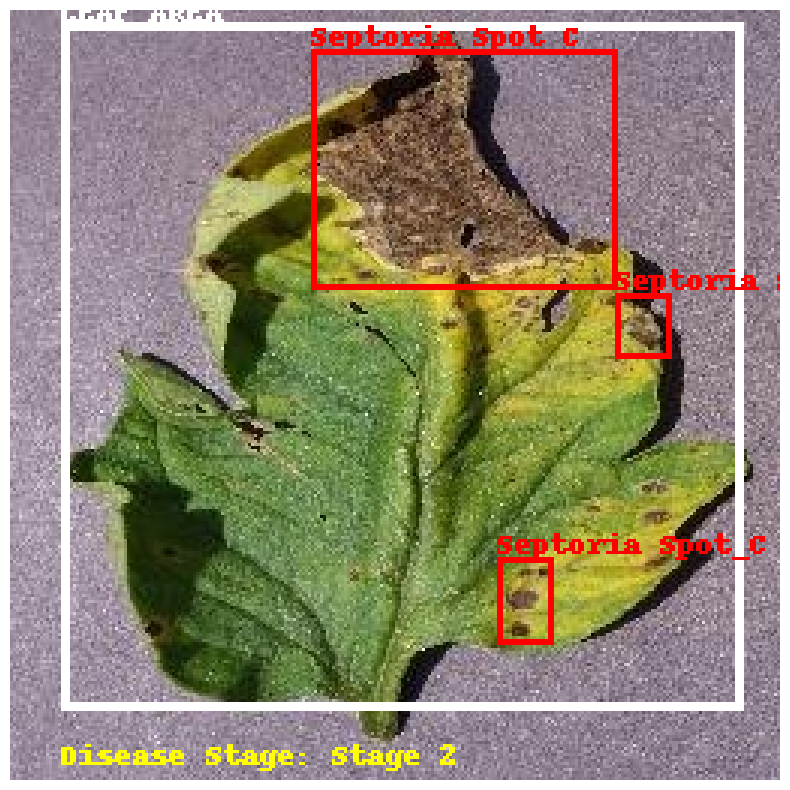

Processing Tomato_Late_blight81.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight81.jpg: 256x256 1 Tomato_Leaf, 106.0ms
Speed: 0.7ms preprocess, 106.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_B, 108.1ms
Speed: 2.3ms preprocess, 108.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


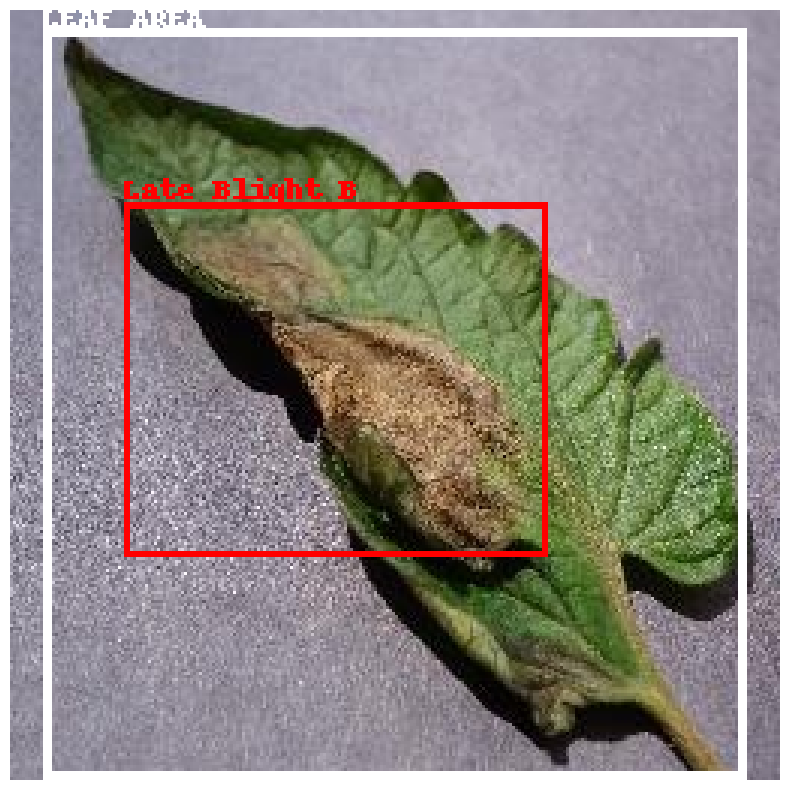

Processing Tomato_Septoria_leaf_spot16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot16.jpg: 256x256 1 Tomato_Leaf, 105.6ms
Speed: 1.4ms preprocess, 105.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_As, 108.6ms
Speed: 2.6ms preprocess, 108.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


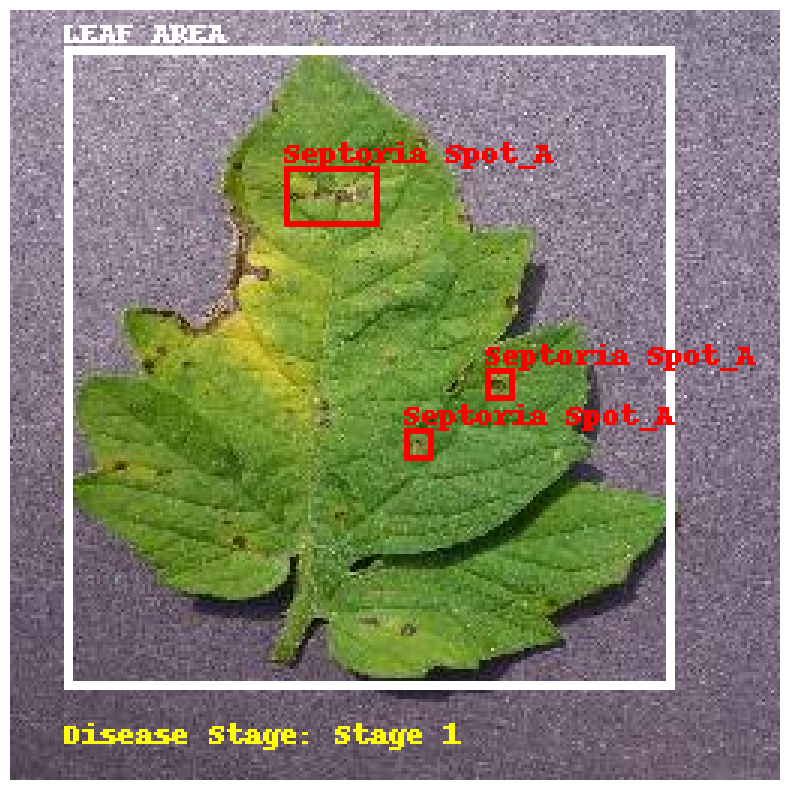

Processing Tomato_Septoria_leaf_spot53.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot53.jpg: 256x256 1 Tomato_Leaf, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Septoria Spot_As, 120.3ms
Speed: 1.1ms preprocess, 120.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


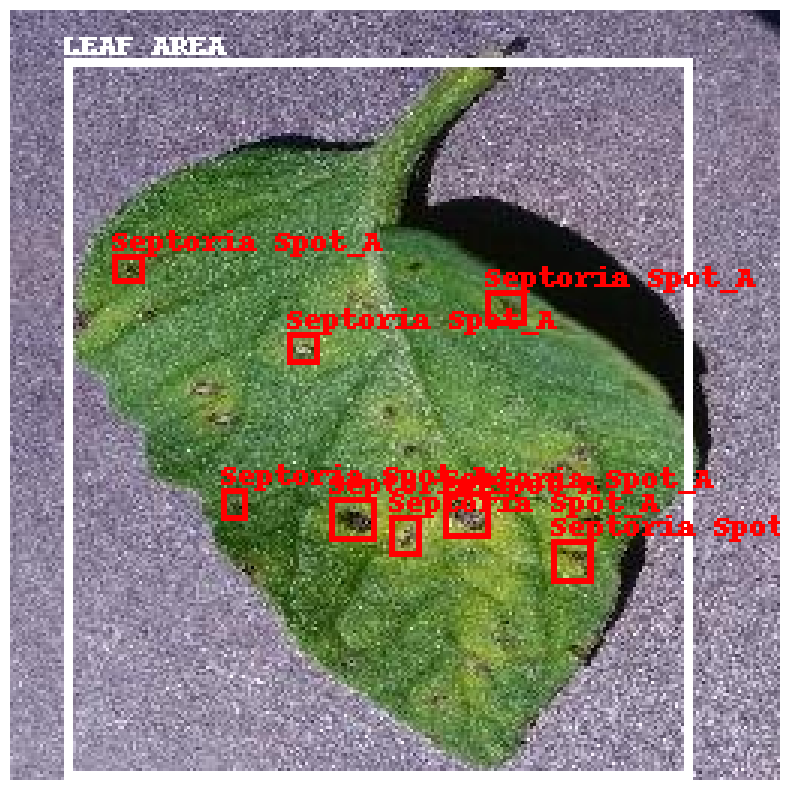

Processing Tomato_Septoria_leaf_spot432.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot432.jpg: 256x256 1 Tomato_Leaf, 164.8ms
Speed: 0.9ms preprocess, 164.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 156.9ms
Speed: 1.2ms preprocess, 156.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 3


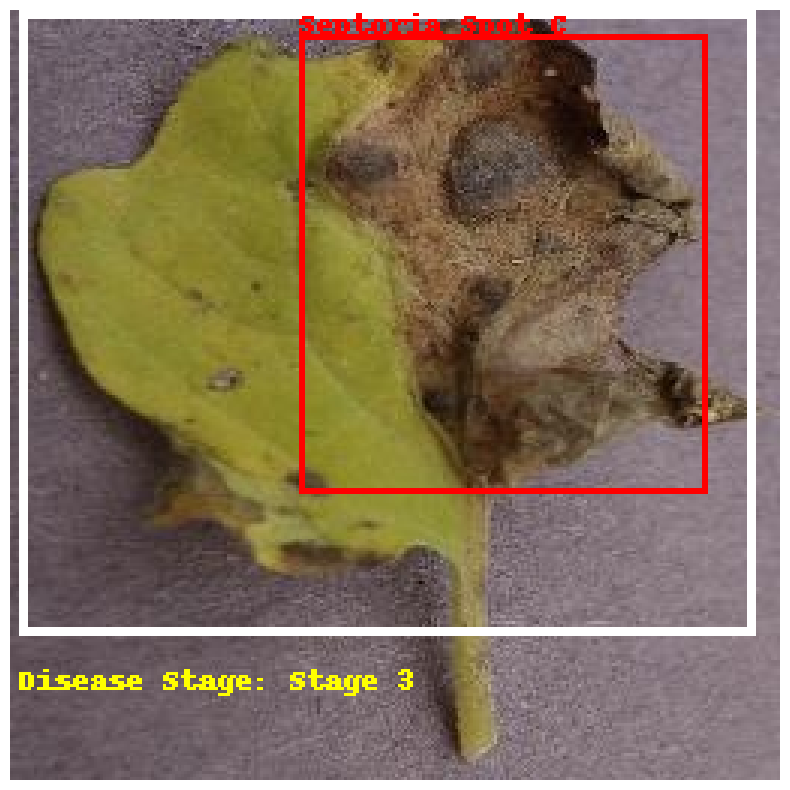

Processing Tomato_Late_blight571.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight571.jpg: 256x256 1 Tomato_Leaf, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 113.5ms
Speed: 1.5ms preprocess, 113.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


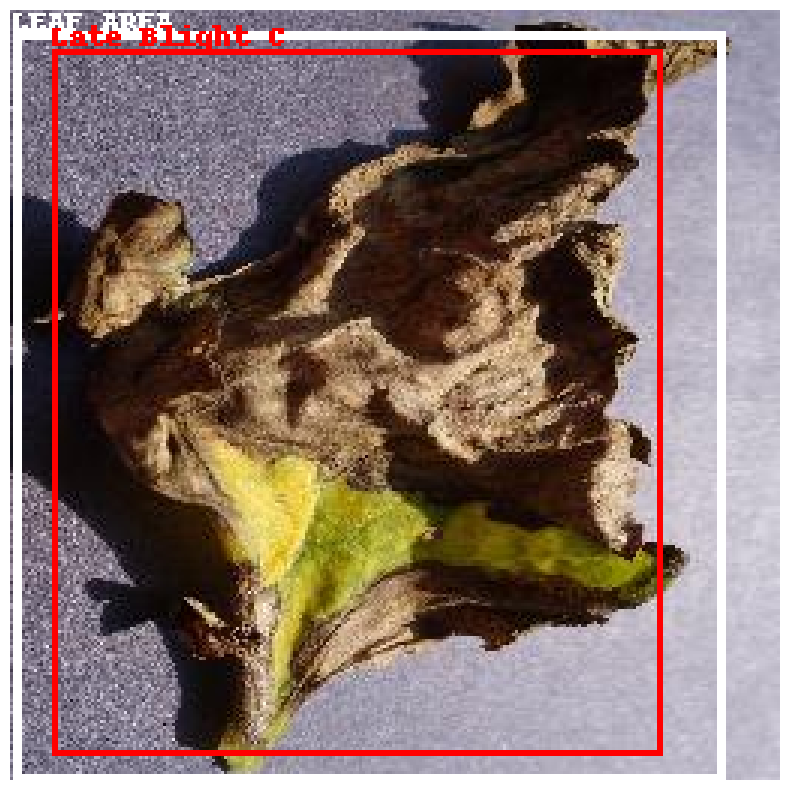

Processing Tomato_Late_blight47.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight47.jpg: 256x256 1 Tomato_Leaf, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 (no detections), 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)
No disease detected in this leaf.


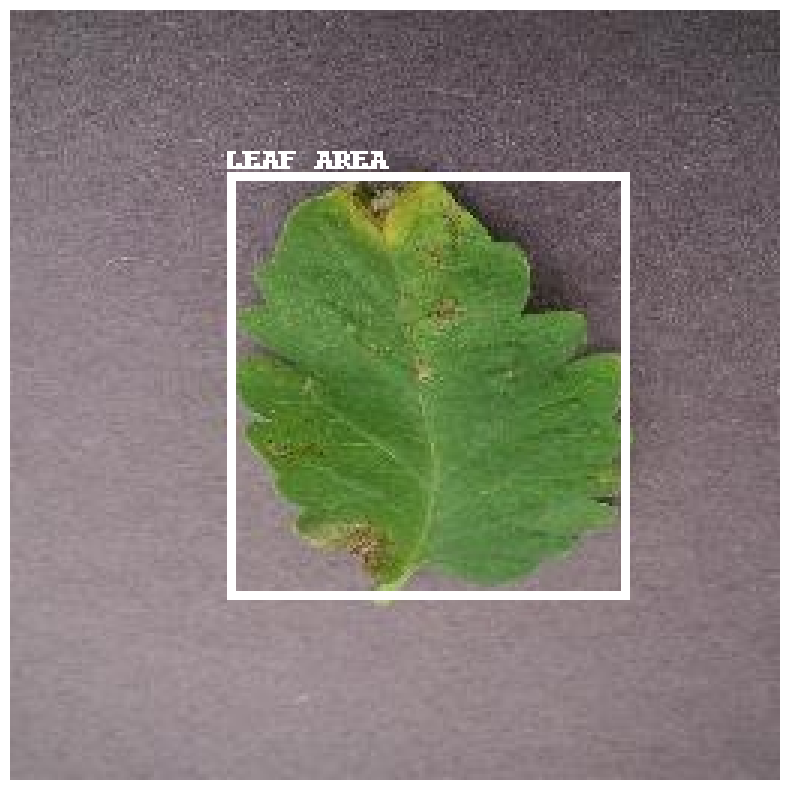

Processing Tomato_Late_blight155.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight155.jpg: 256x256 1 Tomato_Leaf, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 117.2ms
Speed: 1.3ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


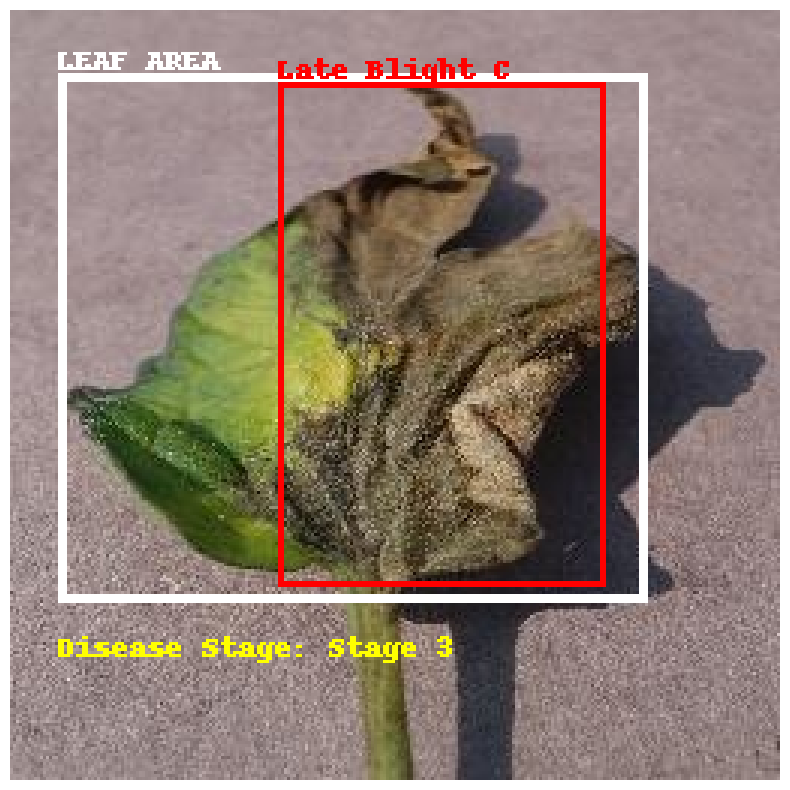

Processing Tomato_Early_blight37.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight37.jpg: 256x256 1 Tomato_Leaf, 173.3ms
Speed: 0.9ms preprocess, 173.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 5 Early Blight_As, 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


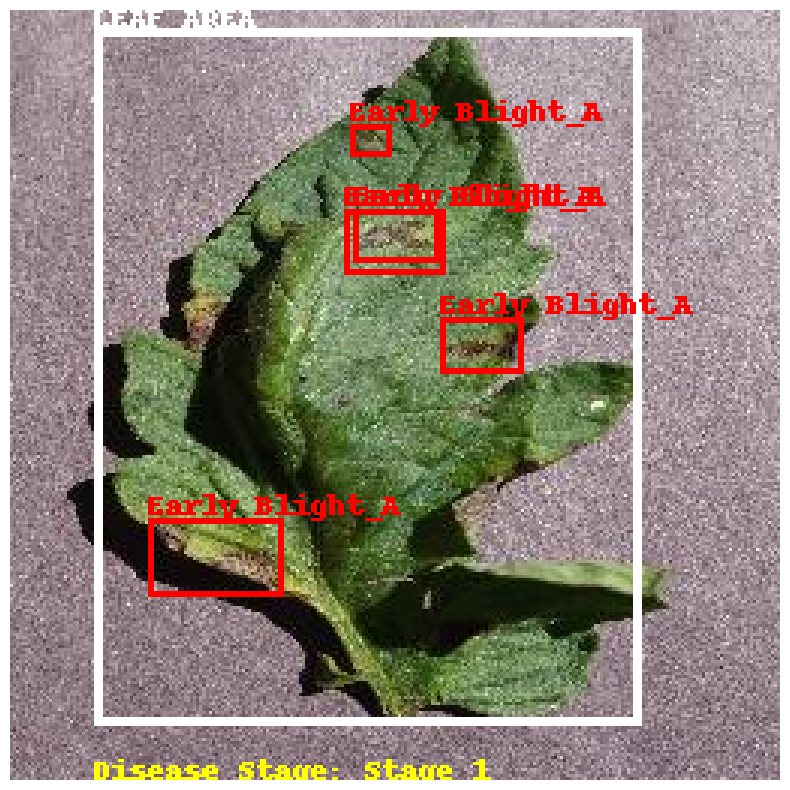

Processing Tomato_Early_blight228.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight228.jpg: 256x256 1 Tomato_Leaf, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Cs, 121.6ms
Speed: 1.2ms preprocess, 121.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


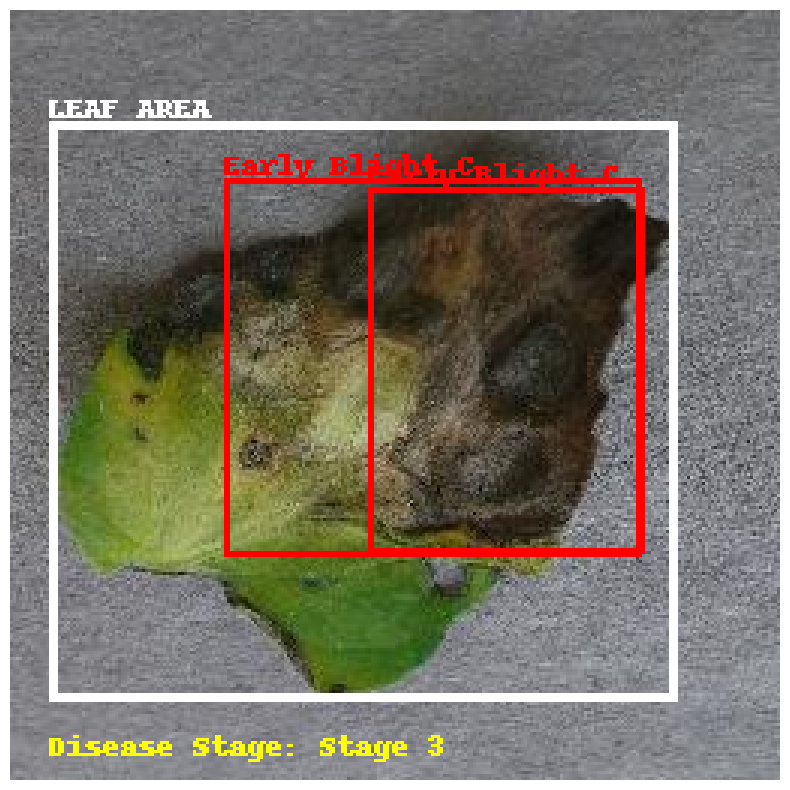

Processing Tomato_Early_blight62.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight62.jpg: 256x256 1 Tomato_Leaf, 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Early Blight_Bs, 125.4ms
Speed: 1.8ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


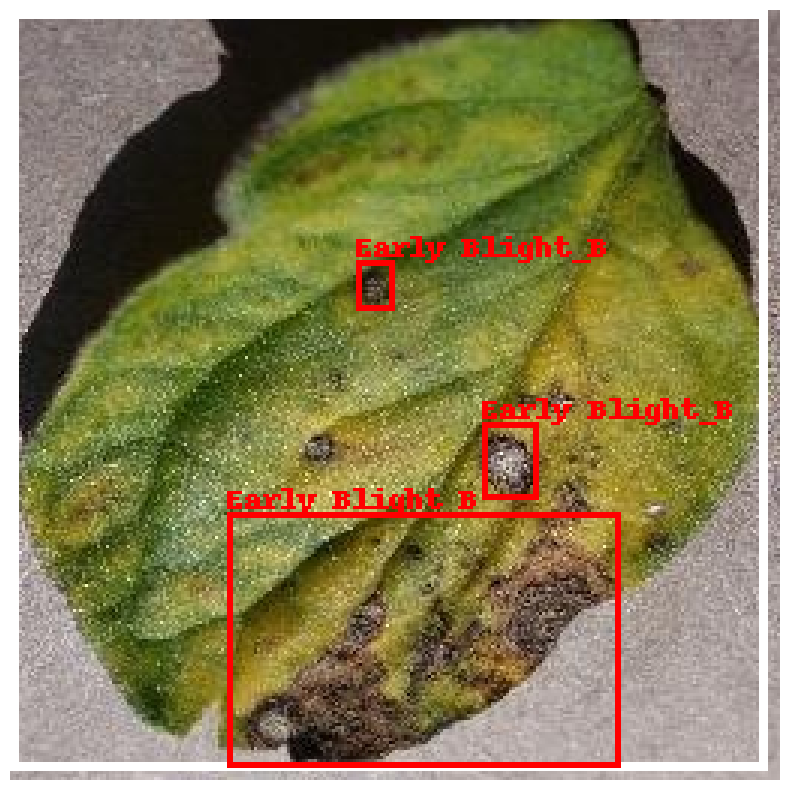

Processing Tomato_Bacterial_spot895.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot895.jpg: 256x256 1 Tomato_Leaf, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 169.9ms
Speed: 1.2ms preprocess, 169.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


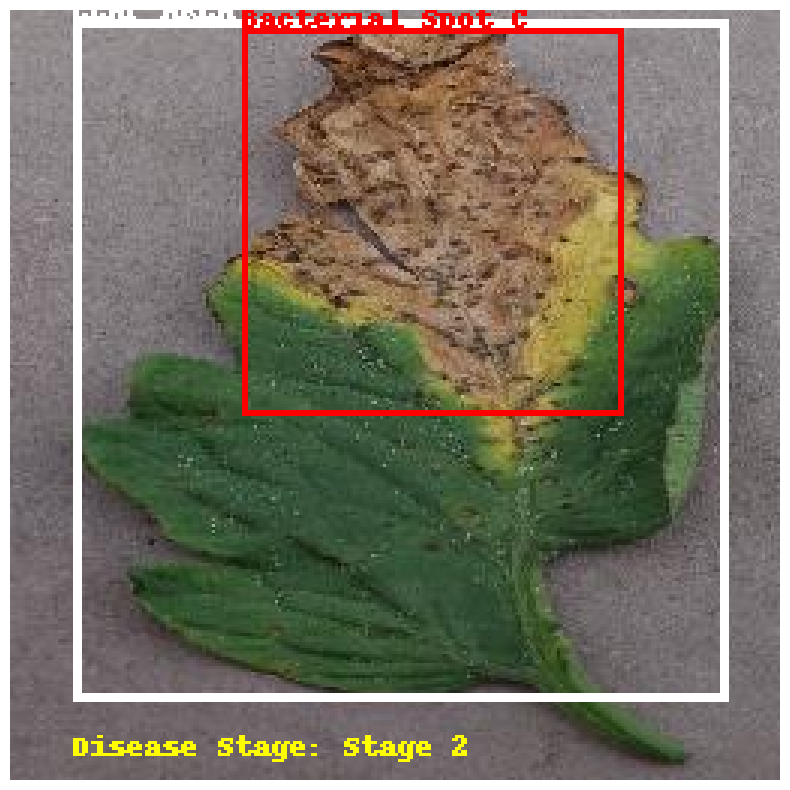

Processing Tomato_Early_blight16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight16.jpg: 256x256 1 Tomato_Leaf, 196.5ms
Speed: 1.0ms preprocess, 196.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 129.2ms
Speed: 2.2ms preprocess, 129.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


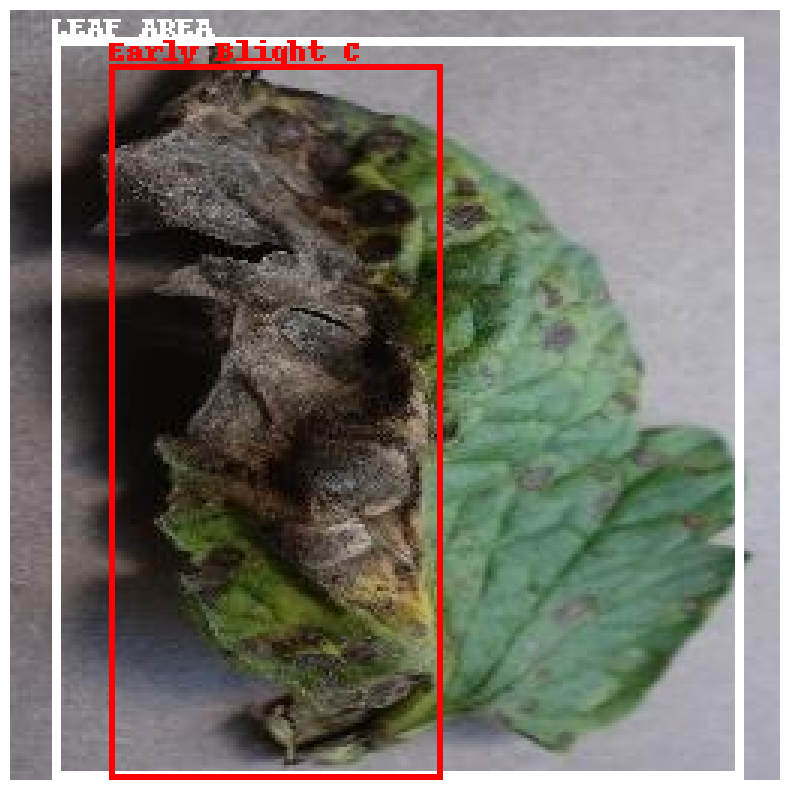

Processing Tomato_Bacterial_spot345.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot345.jpg: 256x256 1 Tomato_Leaf, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 125.2ms
Speed: 1.1ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


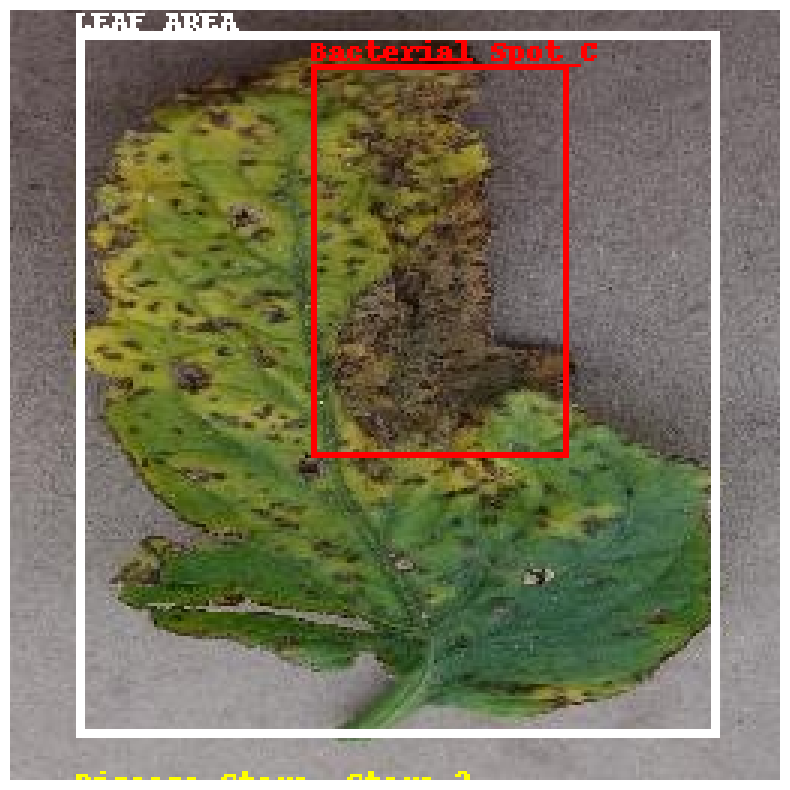

Processing Tomato_Bacterial_spot9.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot9.jpg: 256x256 1 Tomato_Leaf, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Bacterial Spot_As, 120.3ms
Speed: 1.2ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


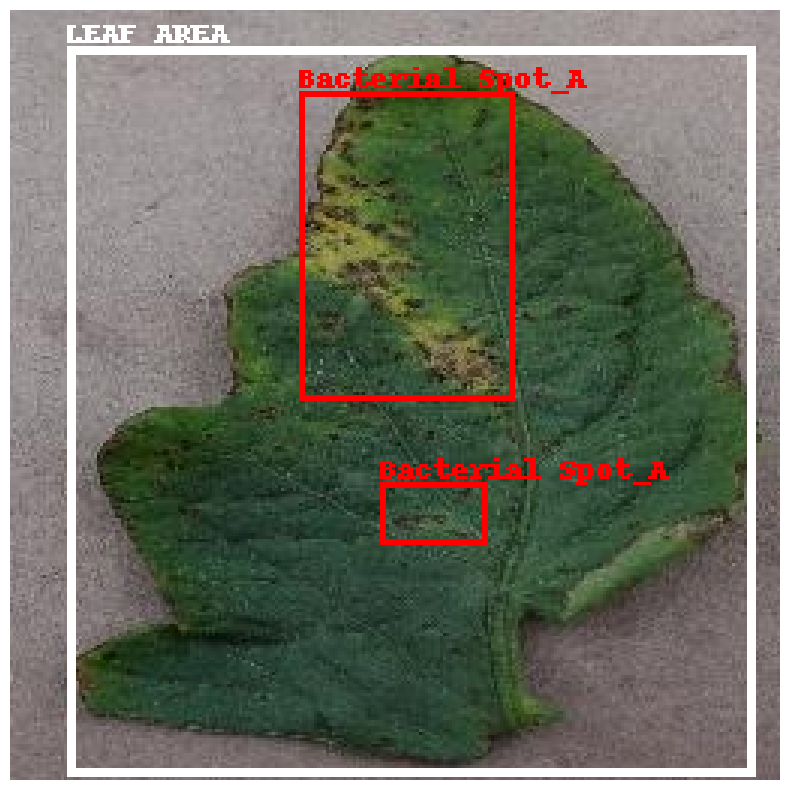

Processing Tomato_Early_blight175.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight175.jpg: 256x256 1 Tomato_Leaf, 183.6ms
Speed: 0.8ms preprocess, 183.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Early Blight_As, 195.4ms
Speed: 2.0ms preprocess, 195.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


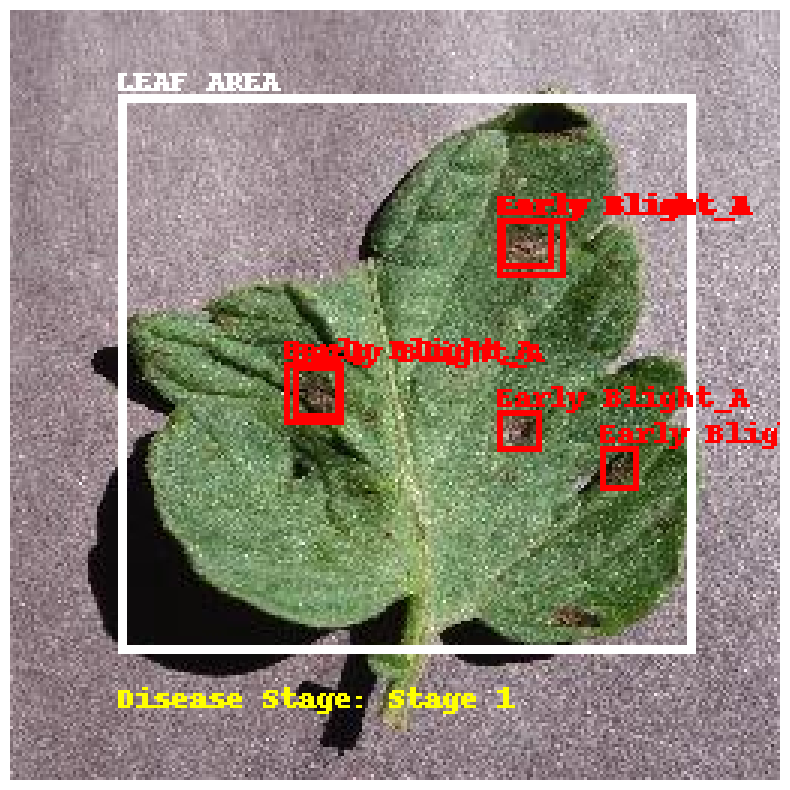

Accuracy: 0.8
Confusion Matrix:
[[5 0 0]
 [0 2 0]
 [0 3 5]]
Classification Report:
              precision    recall  f1-score   support

     Stage 1       1.00      1.00      1.00         5
     Stage 2       0.40      1.00      0.57         2
     Stage 3       1.00      0.62      0.77         8

    accuracy                           0.80        15
   macro avg       0.80      0.88      0.78        15
weighted avg       0.92      0.80      0.82        15



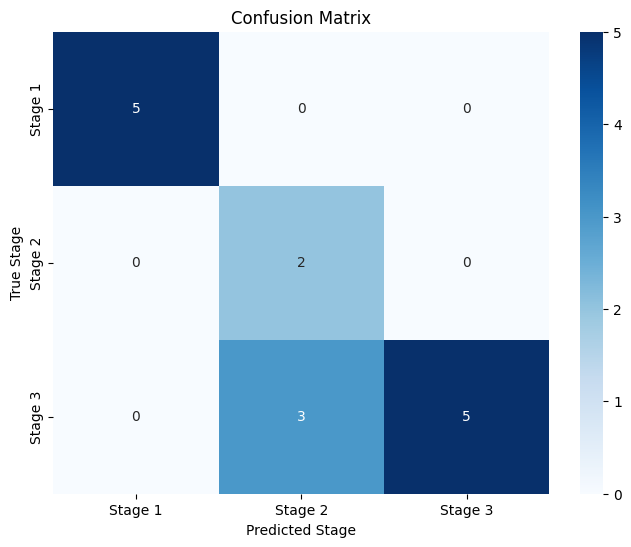

In [ ]:
import os
import numpy as np
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, precision_recall_fscore_support
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

def evaluate_pipeline_on_test_images(test_folder):
    ground_truth_stages = []
    predicted_stages = []

    # Iterate over each image in the test folder
    for filename in os.listdir(test_folder):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            image_path = os.path.join(test_folder, filename)
            print(f"Processing {filename}...")

            # Use the pipeline function to get predictions
            image_ground_truth, image_predicted = detect_and_classify_disease_stage(image_path)

            # Collect the ground truth and predicted stages
            ground_truth_stages.extend(image_ground_truth)
            predicted_stages.extend(image_predicted)

    # Evaluate performance
    accuracy = accuracy_score(ground_truth_stages, predicted_stages)
    conf_matrix = confusion_matrix(ground_truth_stages, predicted_stages, labels=['Stage 1', 'Stage 2', 'Stage 3'])
    report = classification_report(ground_truth_stages, predicted_stages, target_names=['Stage 1', 'Stage 2', 'Stage 3'])

    print(f"Accuracy: {accuracy}")
    print(f"Confusion Matrix:\n{conf_matrix}")
    print(f"Classification Report:\n{report}")

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=['Stage 1', 'Stage 2', 'Stage 3'], yticklabels=['Stage 1', 'Stage 2', 'Stage 3'])
    plt.xlabel('Predicted Stage')
    plt.ylabel('True Stage')
    plt.title('Confusion Matrix')
    plt.show()

def detect_and_classify_disease_stage(image_path):
    # Load the image
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')

    # Load YOLOv8 models
    leaf_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/train14/weights/best.pt'
    disease_detector_model_path = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/runs/detect/disease_detector/yolo_diseaseDetect_best.pt'

    leaf_model = YOLO(leaf_detector_model_path)
    disease_model = YOLO(disease_detector_model_path)

    # Stage 2: Leaf detection
    leaf_results = leaf_model(image_path)

    draw = ImageDraw.Draw(image_rgb)
    font = ImageFont.load_default()

    ground_truth_stages = []
    predicted_stages = []

    for leaf in leaf_results[0].boxes:
        leaf_box = leaf.xyxy[0].cpu().numpy()  # Leaf bounding box coordinates

        # Draw leaf bounding box
        draw.rectangle(leaf_box, outline="white", width=3)
        draw.text((leaf_box[0], leaf_box[1] - 10), "LEAF AREA", fill="white", font=font)

        # Crop the leaf region from the image
        cropped_leaf_image = image_rgb.crop(leaf_box)

        # Stage 3: Disease detection
        disease_results = disease_model(cropped_leaf_image)

        disease_classes = []
        for disease in disease_results[0].boxes:
            disease_label = disease.cls.cpu().numpy()  # Disease class label
            disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label

            # Record the disease class name
            disease_classes.append(disease_name)

            # Draw bounding box for the disease
            disease_box = disease.xyxy[0].cpu().numpy()
            draw.rectangle([leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1],
                            leaf_box[0] + disease_box[2], leaf_box[1] + disease_box[3]],
                           outline="red", width=2)
            draw.text((leaf_box[0] + disease_box[0], leaf_box[1] + disease_box[1] - 10),
                      f"{disease_name}", fill="red", font=font)

        # Determine dominant disease class if any disease is detected
        if disease_classes:
            dominant_disease_class = Counter(disease_classes).most_common(1)[0][0]

            # Extract ground truth stage
            ground_truth_stage = 'Stage ' + dominant_disease_class.split('_')[-1].replace('A', '1').replace('B', '2').replace('C', '3')
            ground_truth_stages.append(ground_truth_stage)

            # Calculate IoU between the leaf area and total diseased area
            total_diseased_area = sum((d.xyxy[0][2] - d.xyxy[0][0]) * (d.xyxy[0][3] - d.xyxy[0][1]) for d in disease_results[0].boxes)
            leaf_area = (leaf_box[2] - leaf_box[0]) * (leaf_box[3] - leaf_box[1])
            iou = total_diseased_area / leaf_area

            # Determine disease stage based on IoU threshold
            if iou > 0.4:
                disease_stage = "Stage 3"
            elif iou > 0.15:
                disease_stage = "Stage 2"
            else:
                disease_stage = "Stage 1"

            # Record the predicted stage
            predicted_stages.append(disease_stage)

            # Overlay the disease stage near the detected leaf
            draw.text((leaf_box[0], leaf_box[3] + 10),
                      f"Disease Stage: {disease_stage}", fill="yellow", font=font)

            # Display the final stage for the detected leaf
            print(f"Detected leaf with disease stage: {disease_stage}")
        else:
            print("No disease detected in this leaf.")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

    return ground_truth_stages, predicted_stages

# Define the path to your test images folder
test_folder = '/content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES'

# Run the evaluation
evaluate_pipeline_on_test_images(test_folder)


Processing Tomato_Septoria_leaf_spot72.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot72.jpg: 256x256 1 Tomato_Leaf, 184.1ms
Speed: 1.1ms preprocess, 184.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_Cs, 174.9ms
Speed: 1.2ms preprocess, 174.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-33-16562969b4d8>:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


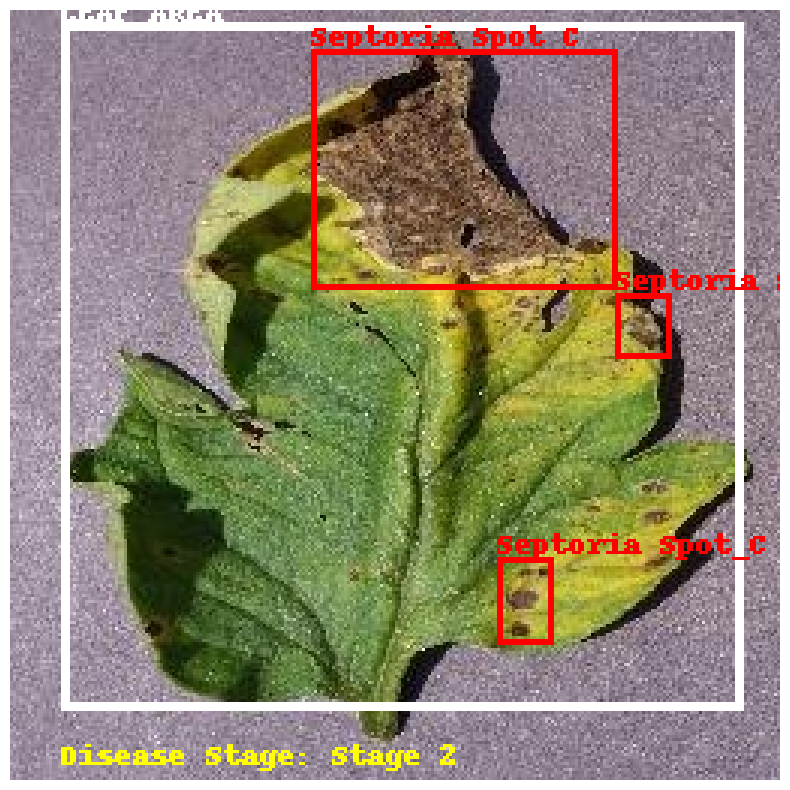

Processing Tomato_Late_blight81.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight81.jpg: 256x256 1 Tomato_Leaf, 170.3ms
Speed: 0.9ms preprocess, 170.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_B, 109.9ms
Speed: 1.1ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


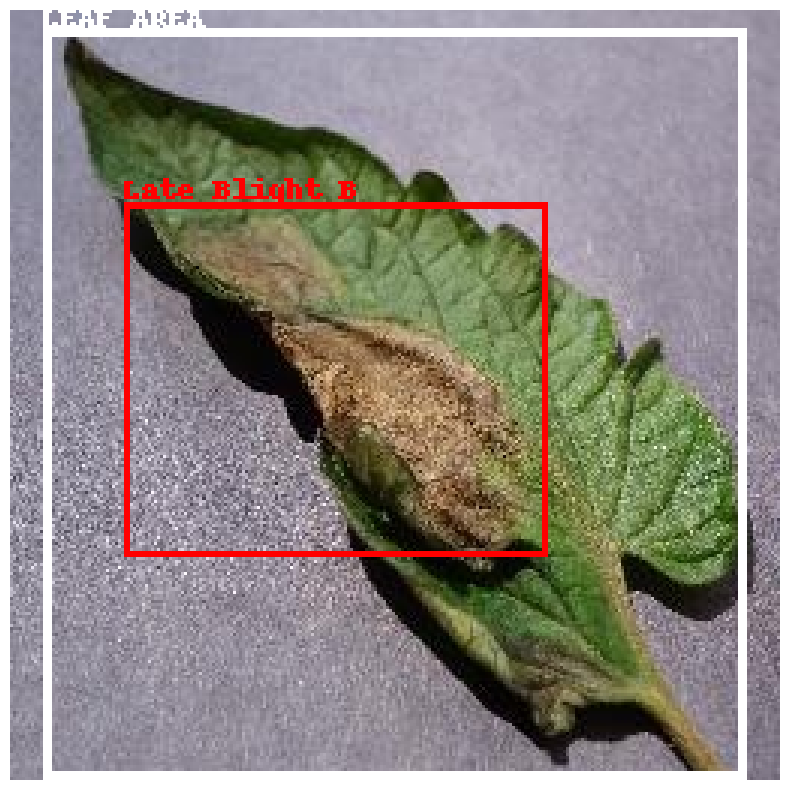

Processing Tomato_Septoria_leaf_spot16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot16.jpg: 256x256 1 Tomato_Leaf, 111.1ms
Speed: 1.2ms preprocess, 111.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_As, 122.1ms
Speed: 1.3ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


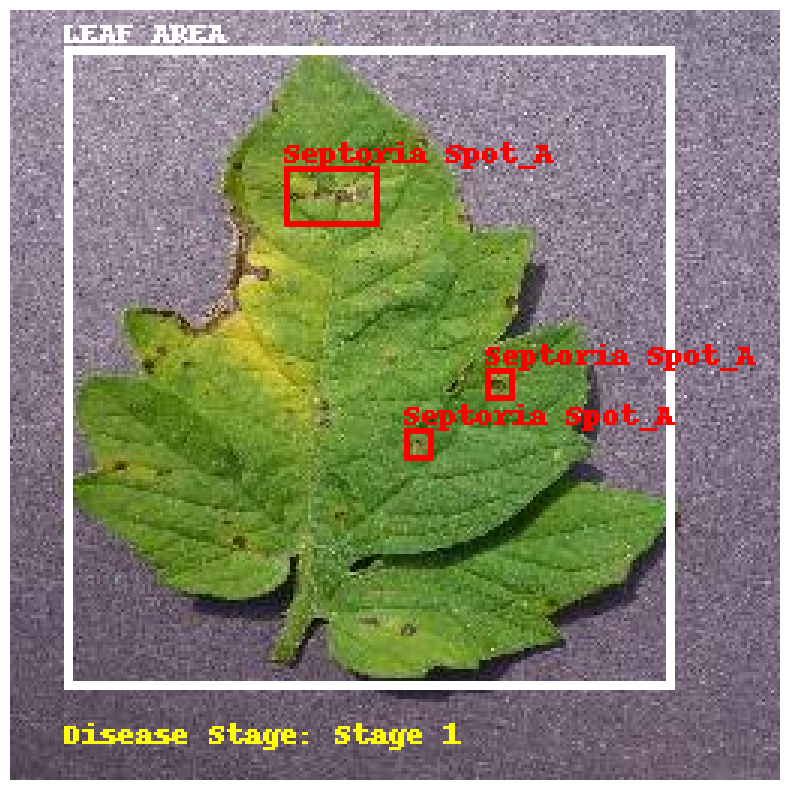

Processing Tomato_Septoria_leaf_spot53.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot53.jpg: 256x256 1 Tomato_Leaf, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Septoria Spot_As, 105.4ms
Speed: 1.8ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


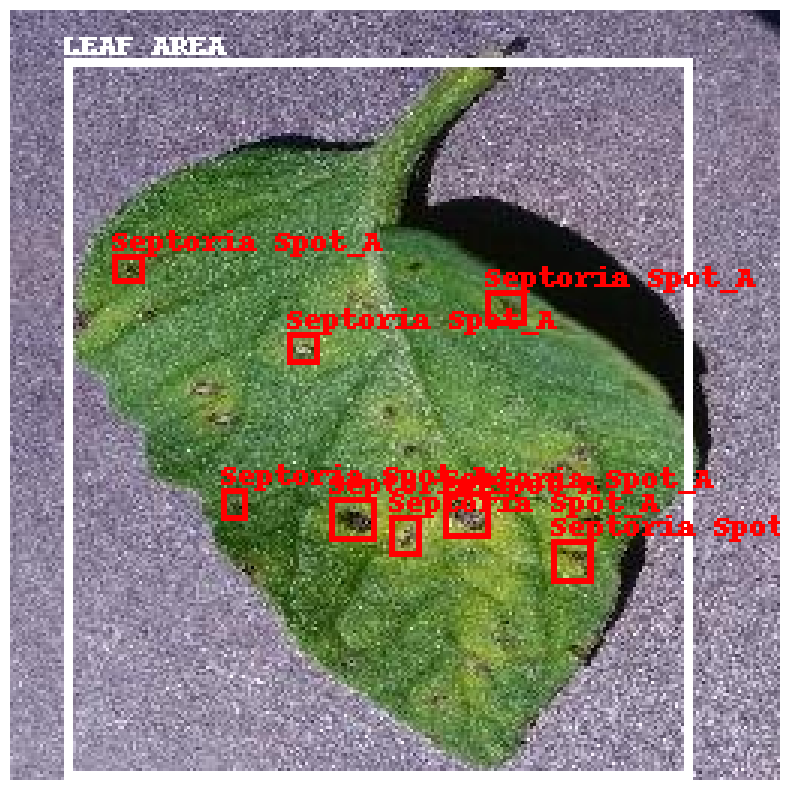

Processing Tomato_Septoria_leaf_spot432.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot432.jpg: 256x256 1 Tomato_Leaf, 181.0ms
Speed: 0.8ms preprocess, 181.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 151.2ms
Speed: 1.1ms preprocess, 151.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 3


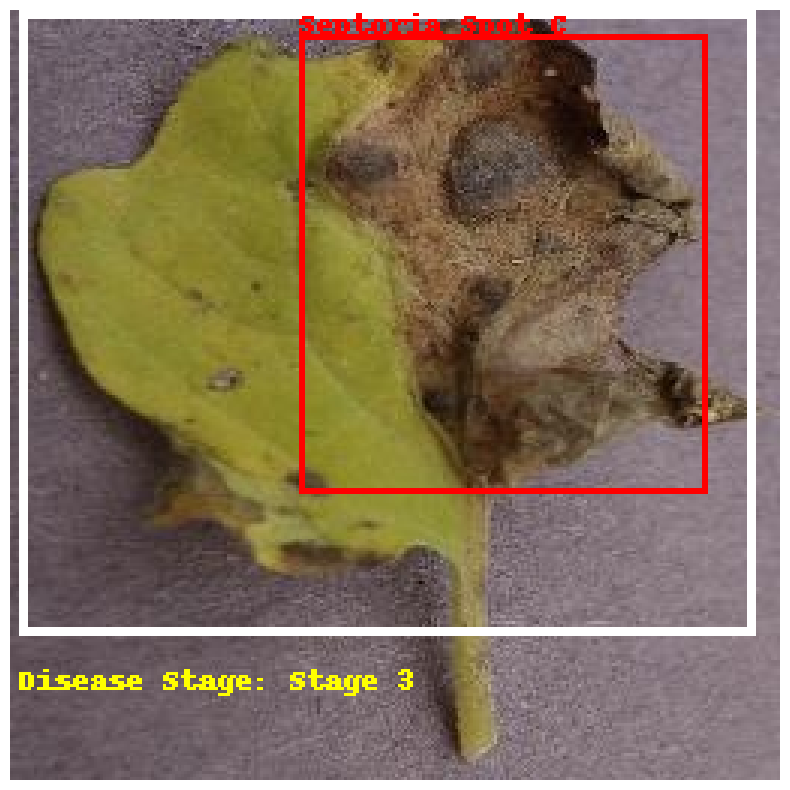

Processing Tomato_Late_blight571.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight571.jpg: 256x256 1 Tomato_Leaf, 193.7ms
Speed: 0.9ms preprocess, 193.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 122.5ms
Speed: 1.1ms preprocess, 122.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


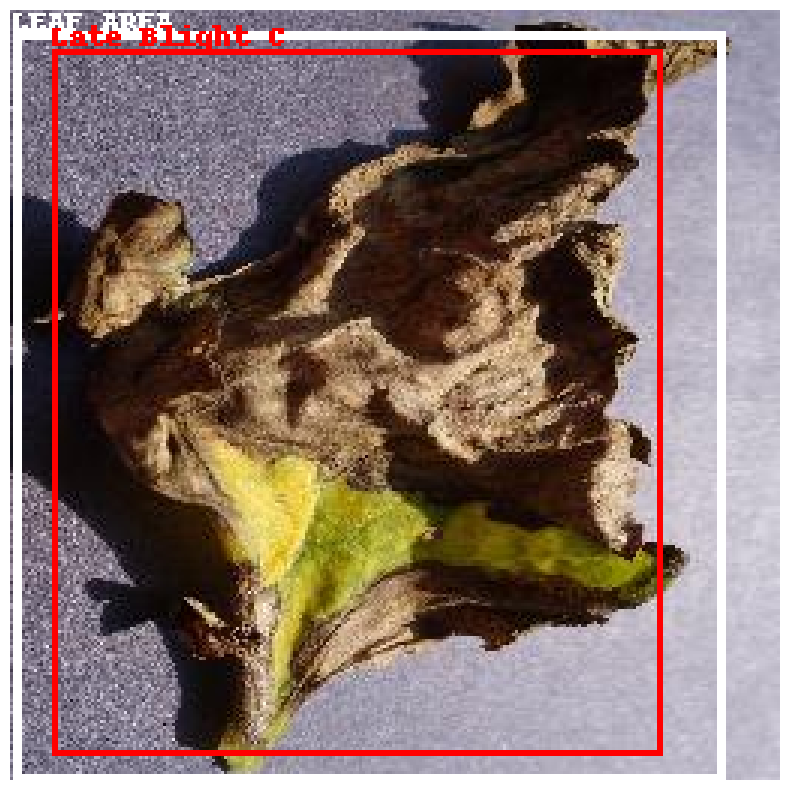

Processing Tomato_Late_blight47.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight47.jpg: 256x256 1 Tomato_Leaf, 110.9ms
Speed: 2.2ms preprocess, 110.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 (no detections), 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)
No disease detected in this leaf.


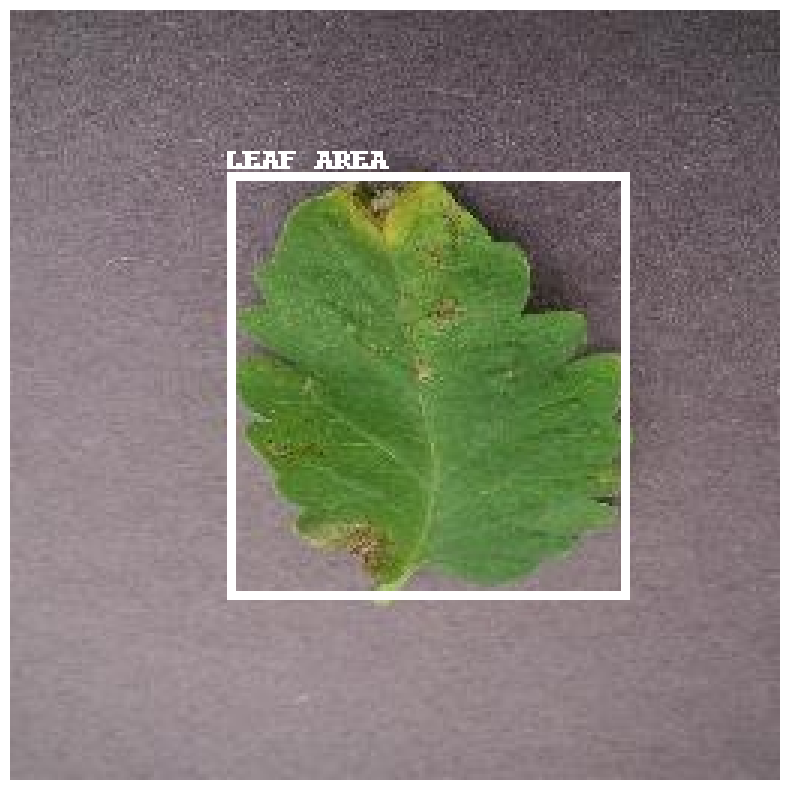

Processing Tomato_Late_blight155.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight155.jpg: 256x256 1 Tomato_Leaf, 118.7ms
Speed: 0.8ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 122.2ms
Speed: 1.2ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


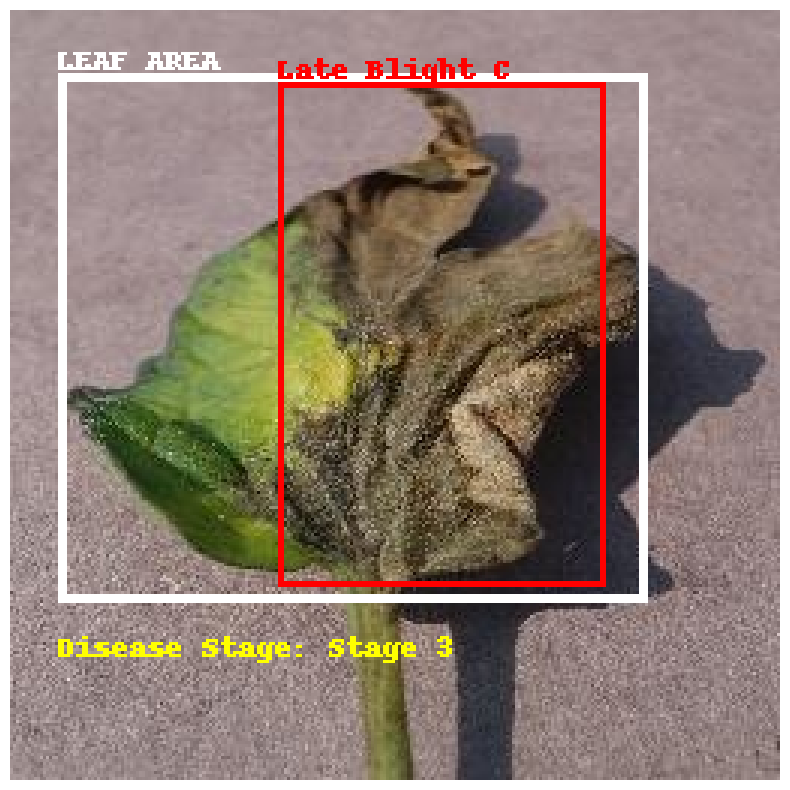

Processing Tomato_Early_blight37.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight37.jpg: 256x256 1 Tomato_Leaf, 194.5ms
Speed: 0.9ms preprocess, 194.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 5 Early Blight_As, 169.1ms
Speed: 1.4ms preprocess, 169.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


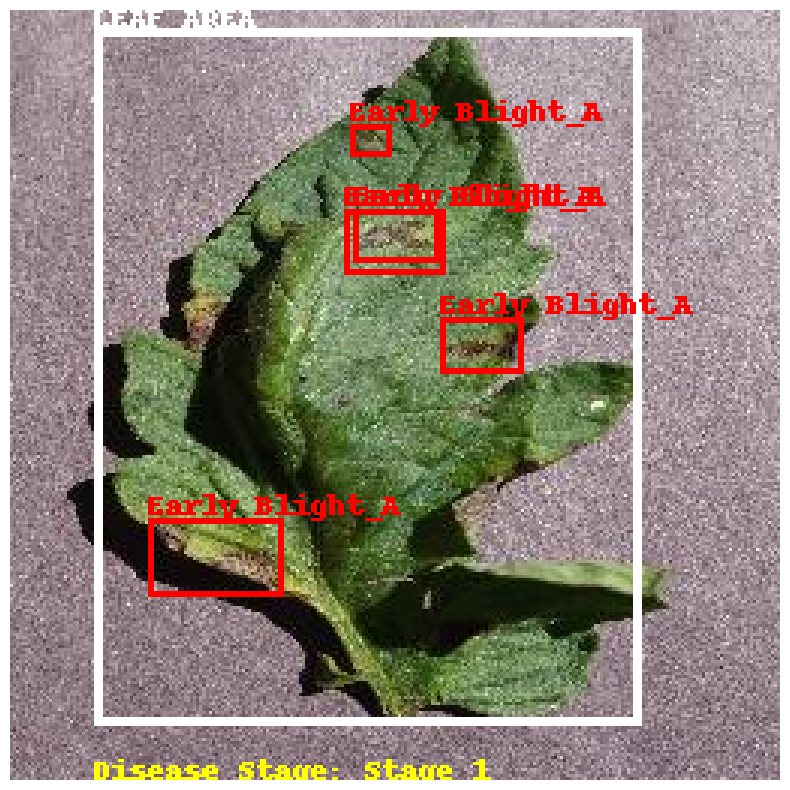

Processing Tomato_Early_blight228.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight228.jpg: 256x256 1 Tomato_Leaf, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Cs, 123.9ms
Speed: 1.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


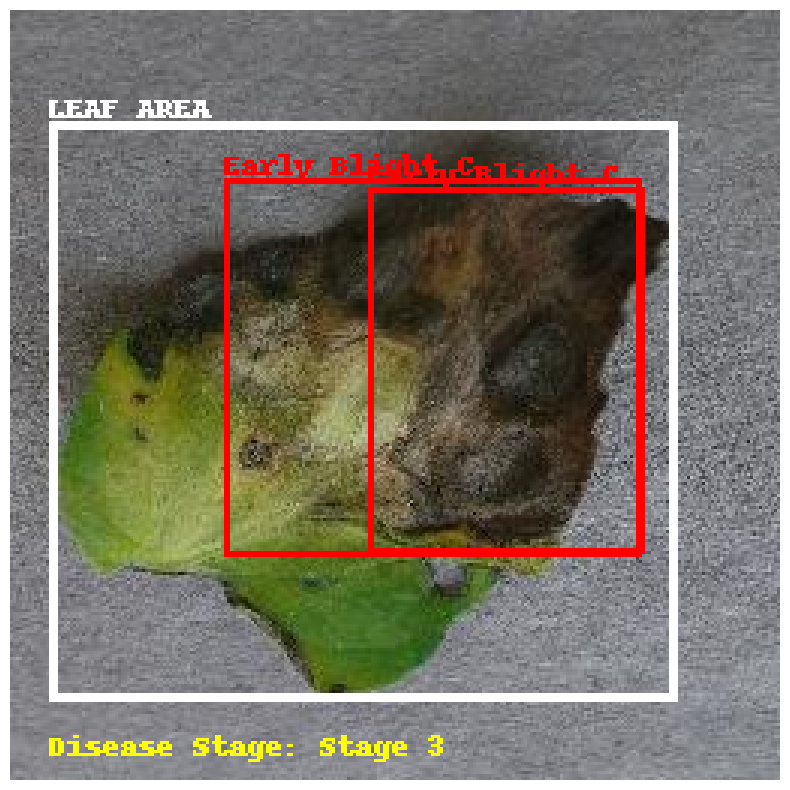

Processing Tomato_Early_blight62.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight62.jpg: 256x256 1 Tomato_Leaf, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Early Blight_Bs, 123.5ms
Speed: 1.6ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


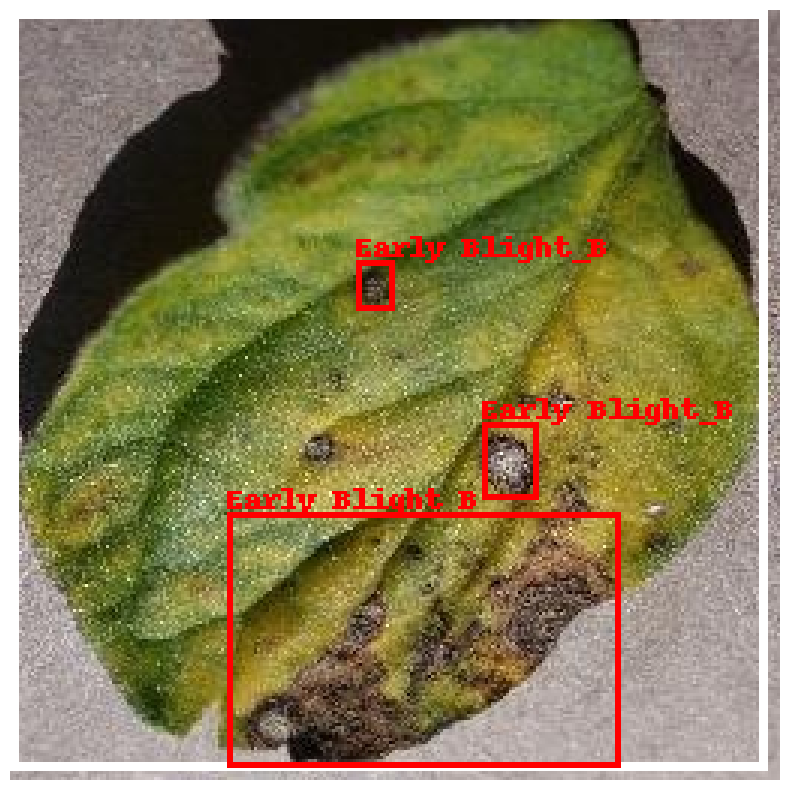

Processing Tomato_Bacterial_spot895.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot895.jpg: 256x256 1 Tomato_Leaf, 124.9ms
Speed: 0.8ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


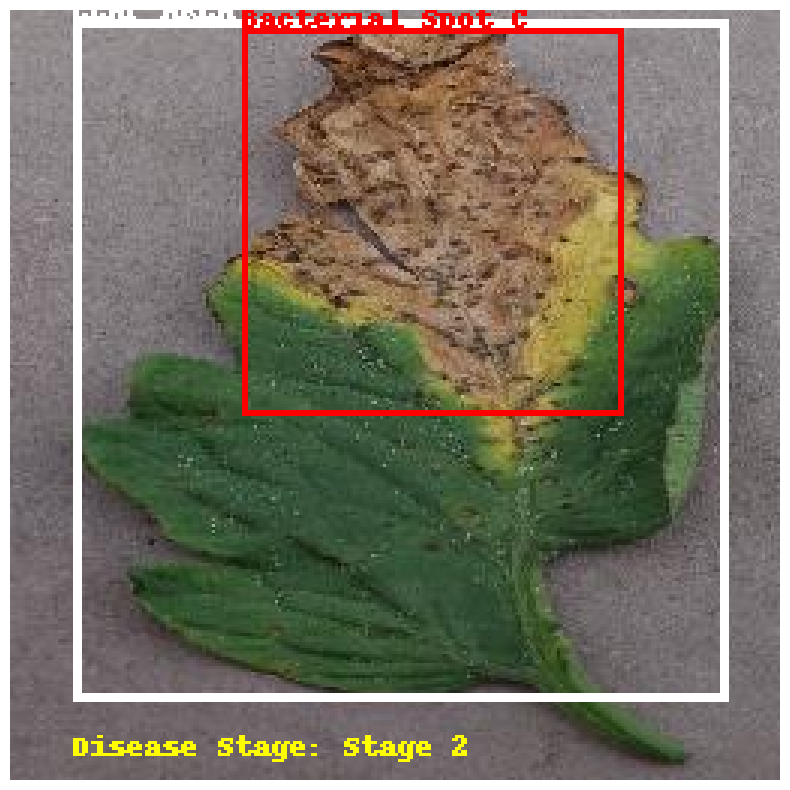

Processing Tomato_Early_blight16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight16.jpg: 256x256 1 Tomato_Leaf, 186.7ms
Speed: 0.9ms preprocess, 186.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 169.4ms
Speed: 1.2ms preprocess, 169.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


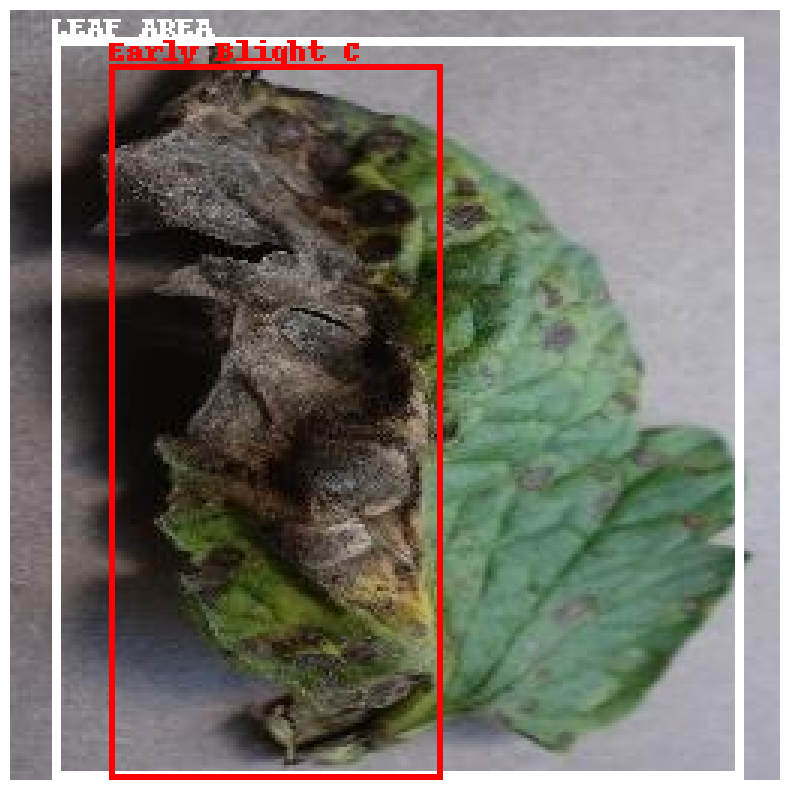

Processing Tomato_Bacterial_spot345.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot345.jpg: 256x256 1 Tomato_Leaf, 178.6ms
Speed: 0.9ms preprocess, 178.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 123.1ms
Speed: 1.2ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


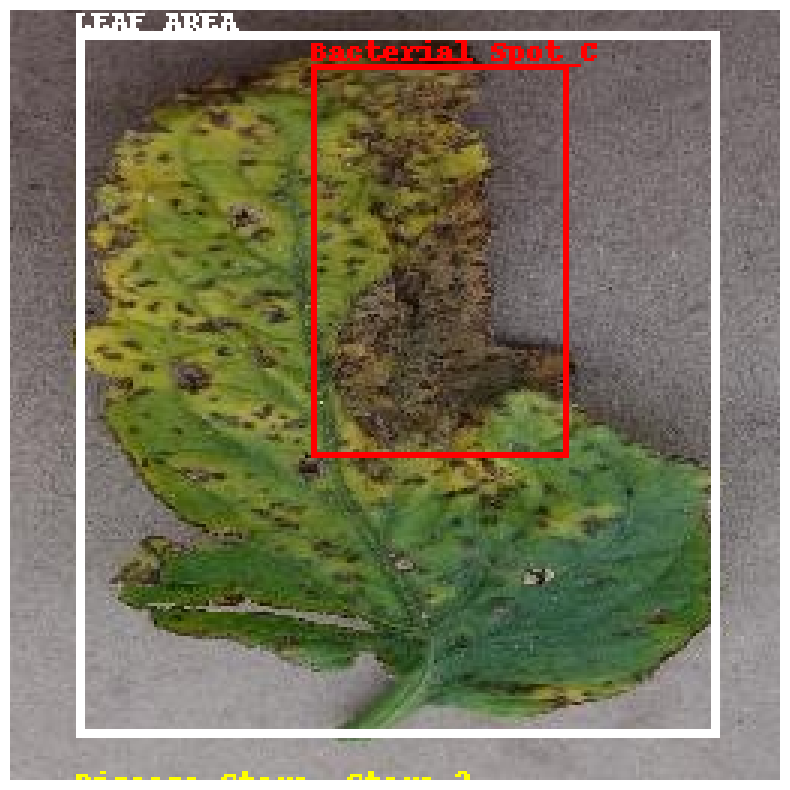

Processing Tomato_Bacterial_spot9.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot9.jpg: 256x256 1 Tomato_Leaf, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Bacterial Spot_As, 123.0ms
Speed: 1.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


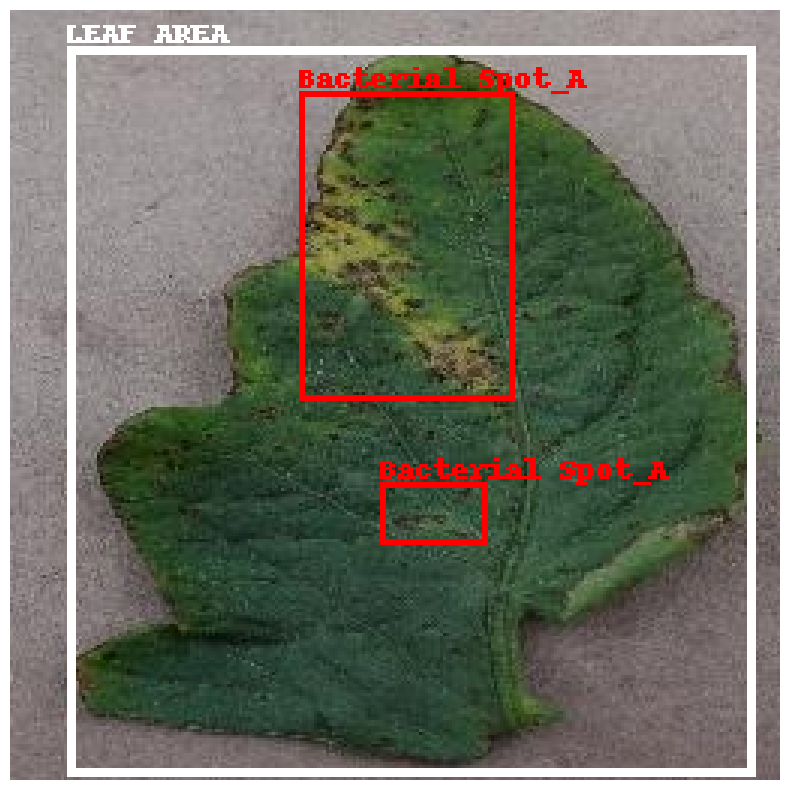

Processing Tomato_Early_blight175.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight175.jpg: 256x256 1 Tomato_Leaf, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Early Blight_As, 125.5ms
Speed: 3.0ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


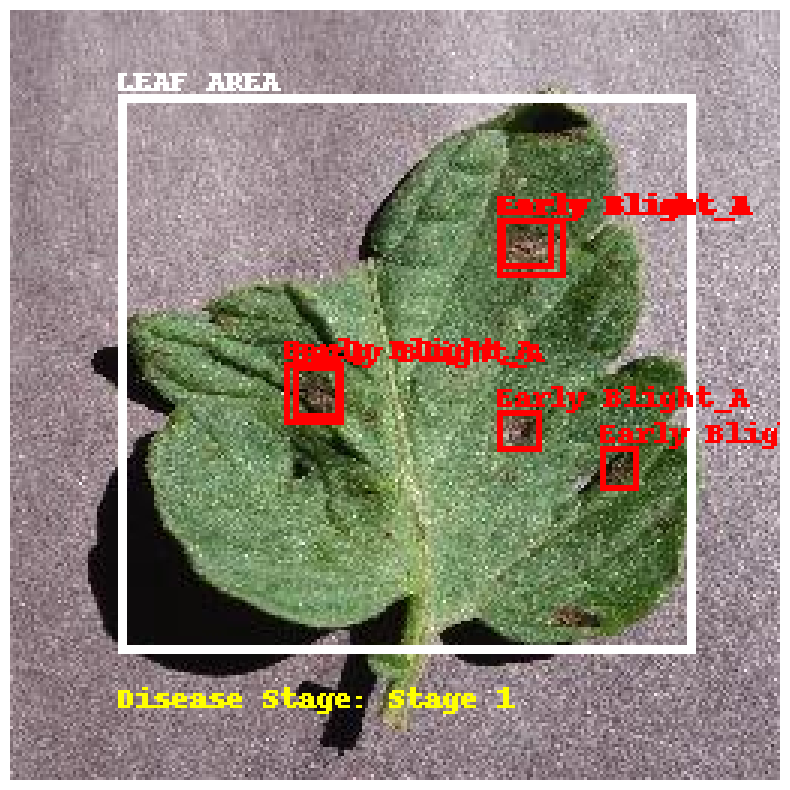

Processing Tomato_Septoria_leaf_spot862.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot862.jpg: 256x256 1 Tomato_Leaf, 188.3ms
Speed: 0.8ms preprocess, 188.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Septoria Spot_C, 192.7ms
Speed: 1.5ms preprocess, 192.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


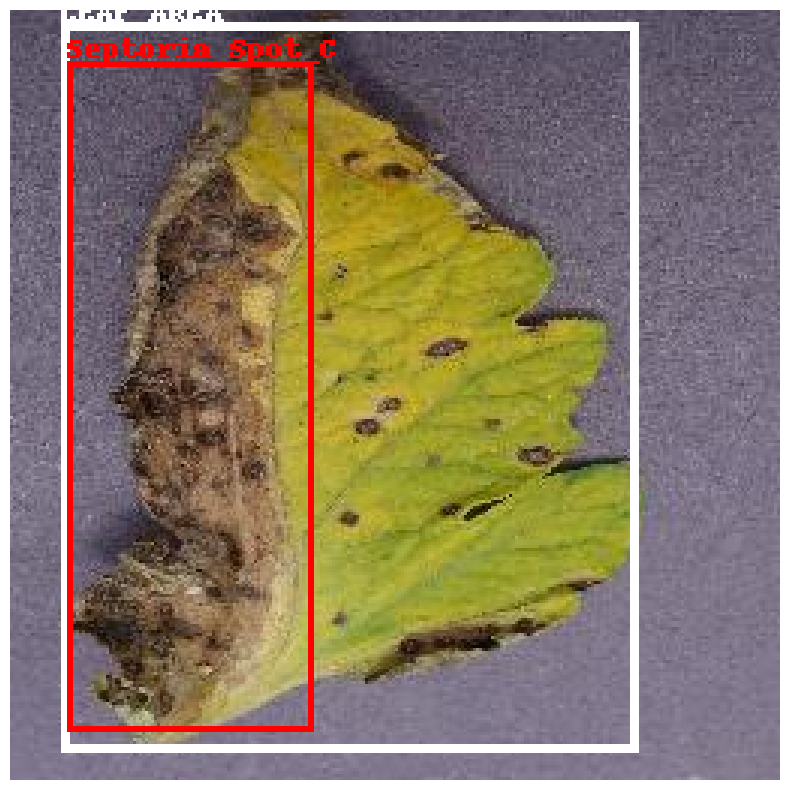

Processing Tomato_Bacterial_spot193.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot193.jpg: 256x256 1 Tomato_Leaf, 143.1ms
Speed: 0.8ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 (no detections), 131.7ms
Speed: 2.1ms preprocess, 131.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)
No disease detected in this leaf.


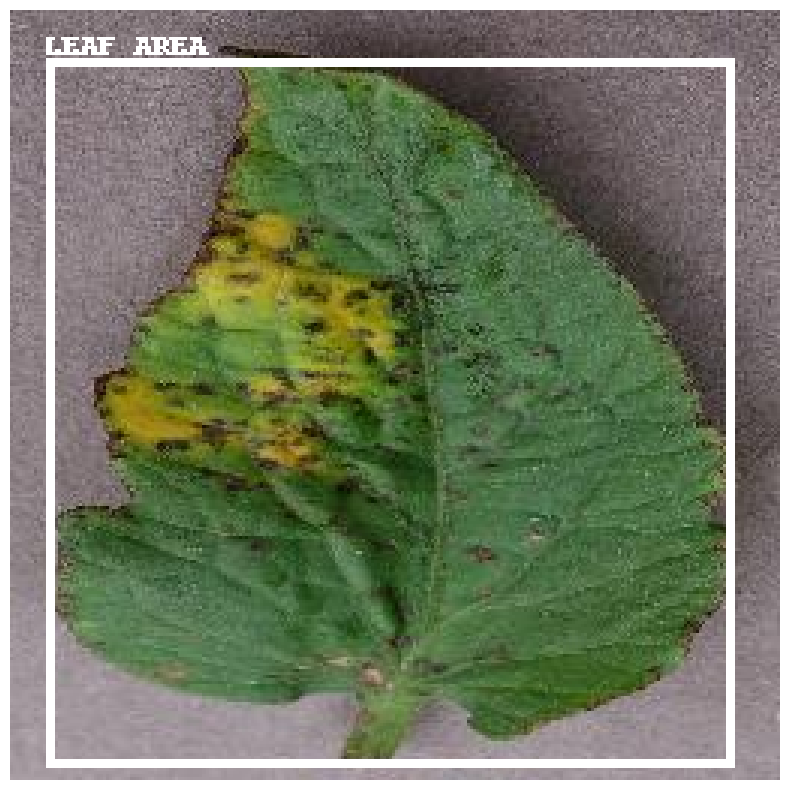

Processing Tomato_Septoria_leaf_spot1077.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot1077.jpg: 256x256 1 Tomato_Leaf, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Septoria Spot_C, 129.0ms
Speed: 1.3ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


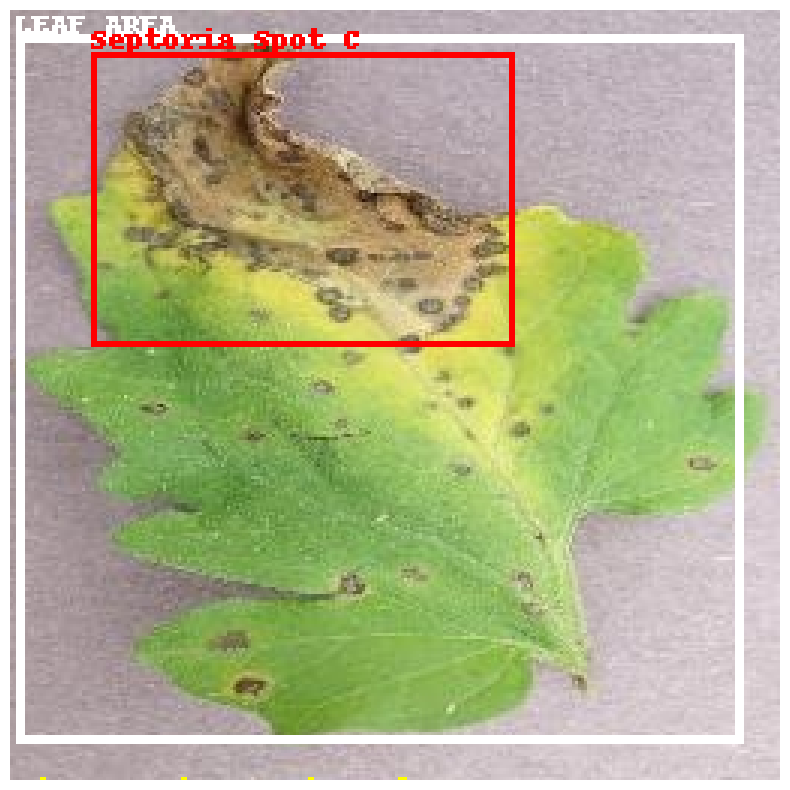

Processing Tomato_Bacterial_spot1031.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot1031.jpg: 256x256 1 Tomato_Leaf, 128.8ms
Speed: 0.8ms preprocess, 128.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_B, 187.6ms
Speed: 1.1ms preprocess, 187.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


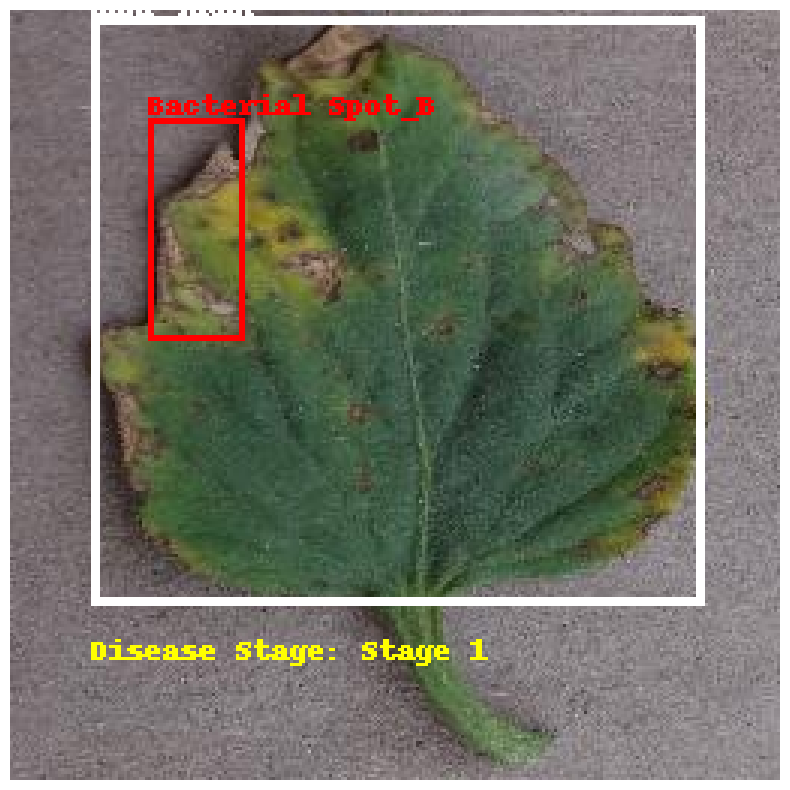

Processing Tomato_Early_blight14.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight14.jpg: 256x256 1 Tomato_Leaf, 172.9ms
Speed: 0.9ms preprocess, 172.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 171.5ms
Speed: 1.1ms preprocess, 171.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


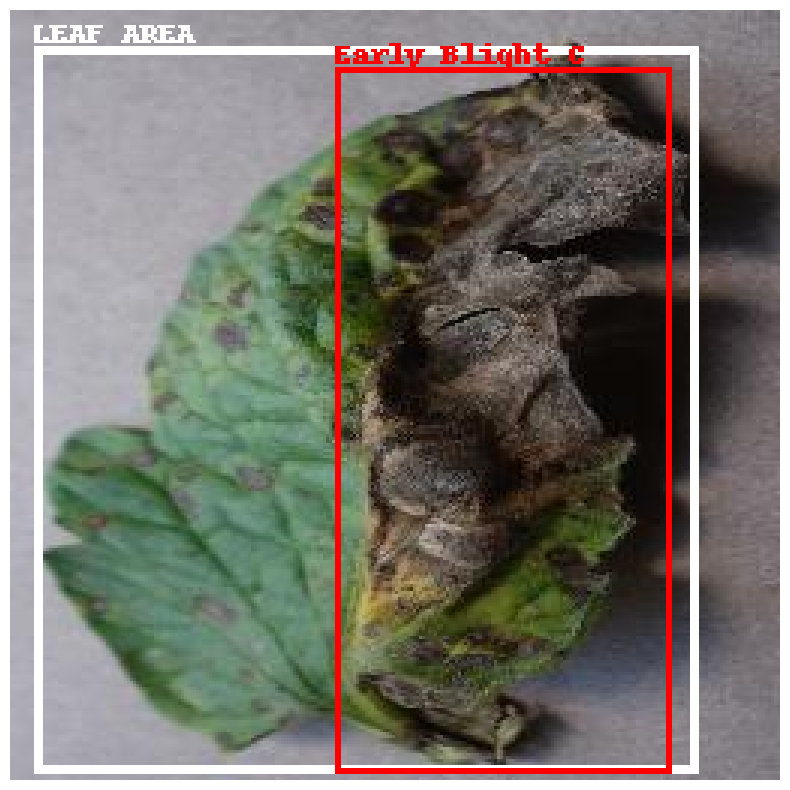

Processing Tomato_Septoria_leaf_spot1324.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot1324.jpg: 256x256 1 Tomato_Leaf, 124.5ms
Speed: 0.8ms preprocess, 124.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 12 Septoria Spot_Bs, 131.0ms
Speed: 1.1ms preprocess, 131.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


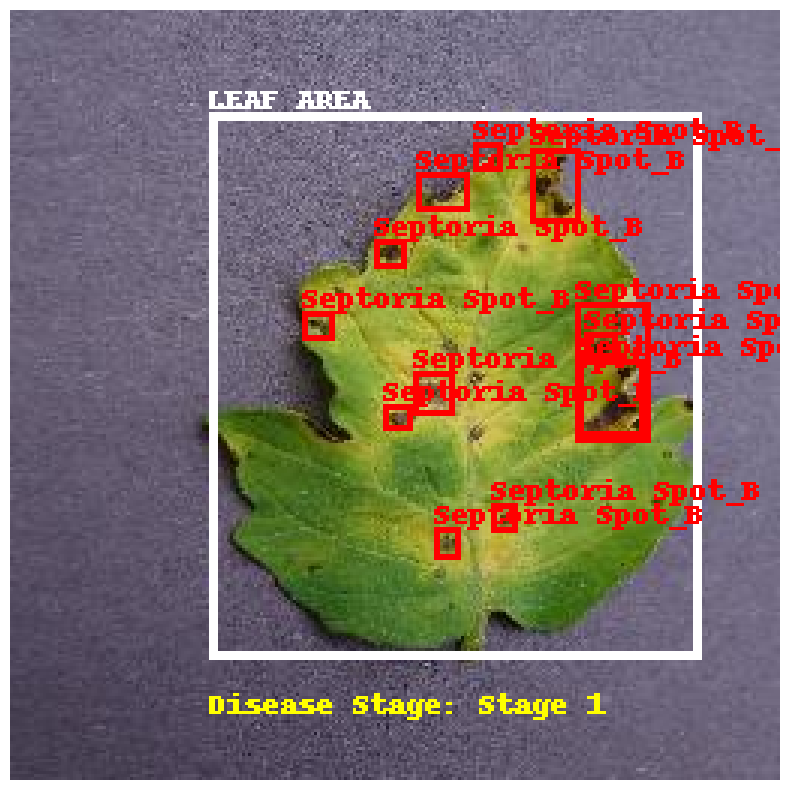

Processing Tomato_Septoria_leaf_spot327.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot327.jpg: 256x256 1 Tomato_Leaf, 130.5ms
Speed: 1.1ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 13 Septoria Spot_Bs, 150.1ms
Speed: 1.4ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


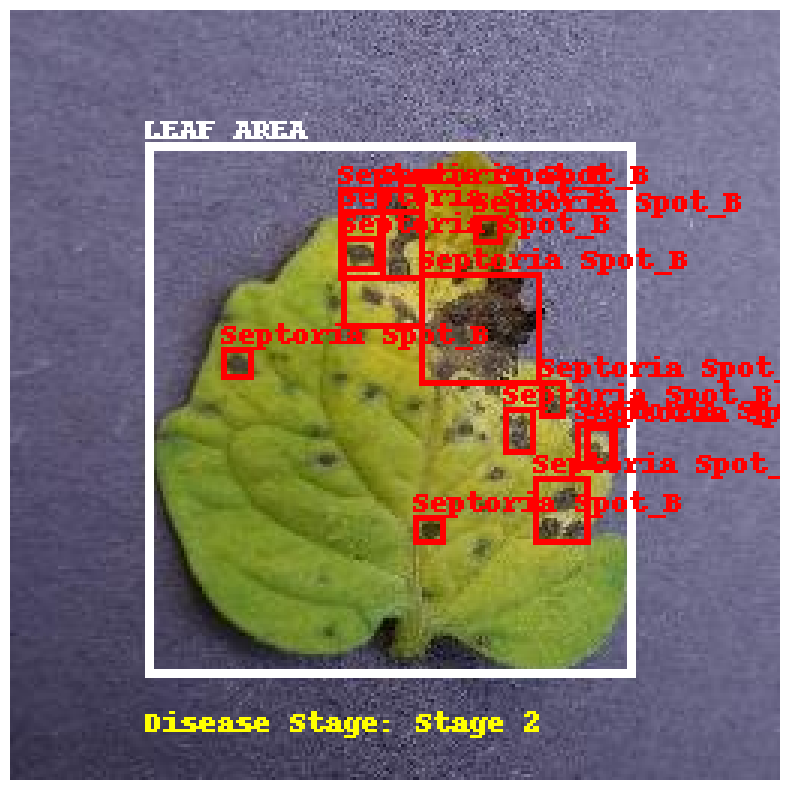

Processing Tomato_Septoria_leaf_spot49.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot49.jpg: 256x256 1 Tomato_Leaf, 193.6ms
Speed: 1.8ms preprocess, 193.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Septoria Spot_C, 203.1ms
Speed: 1.2ms preprocess, 203.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


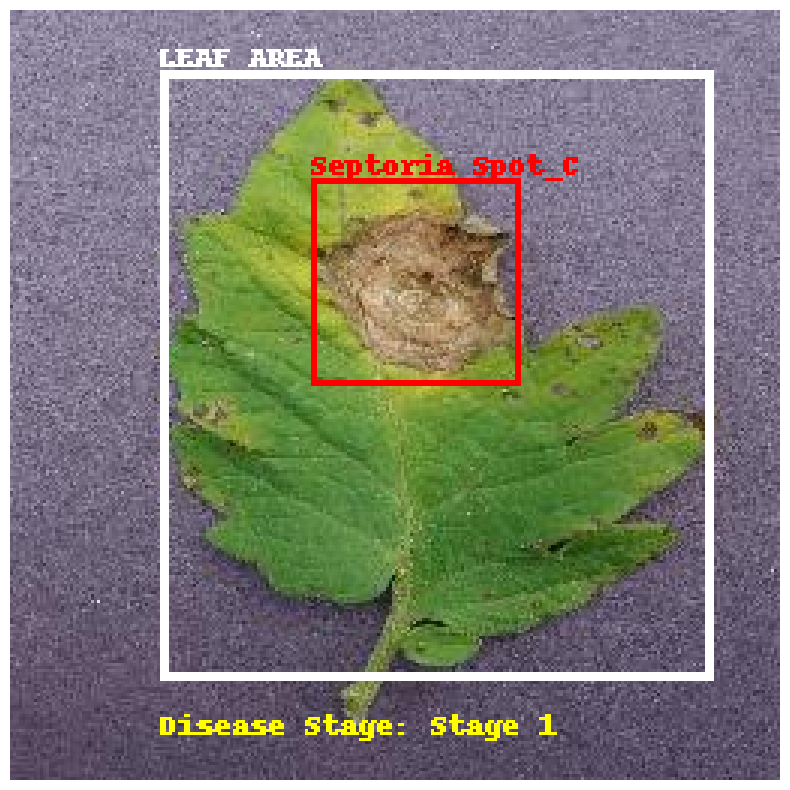

Processing Tomato_Late_blight108.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight108.jpg: 256x256 1 Tomato_Leaf, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_A, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


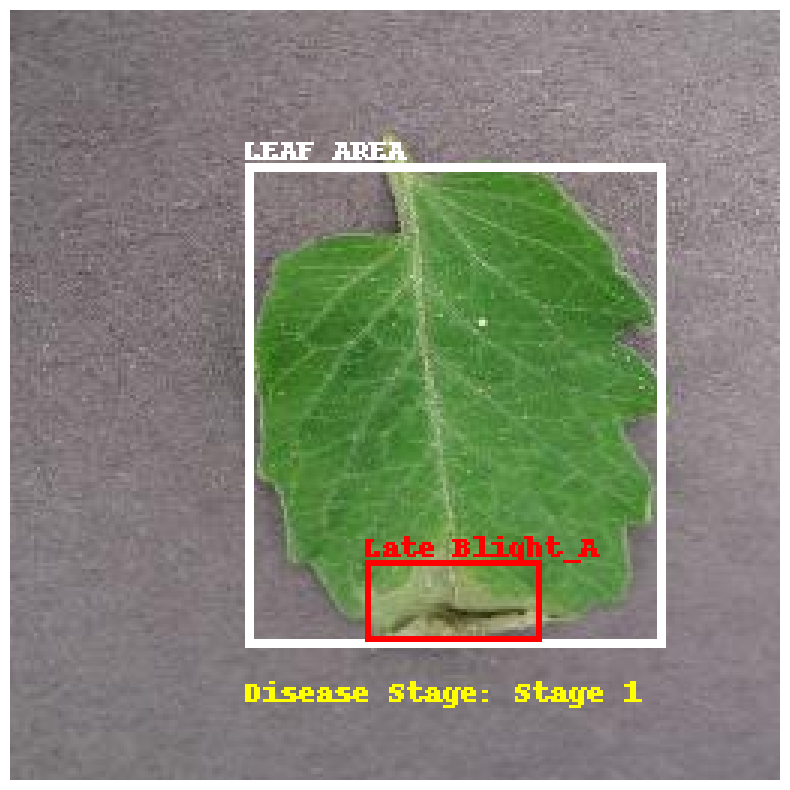

Processing Tomato_Late_blight170.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight170.jpg: 256x256 1 Tomato_Leaf, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_B, 128.0ms
Speed: 2.8ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


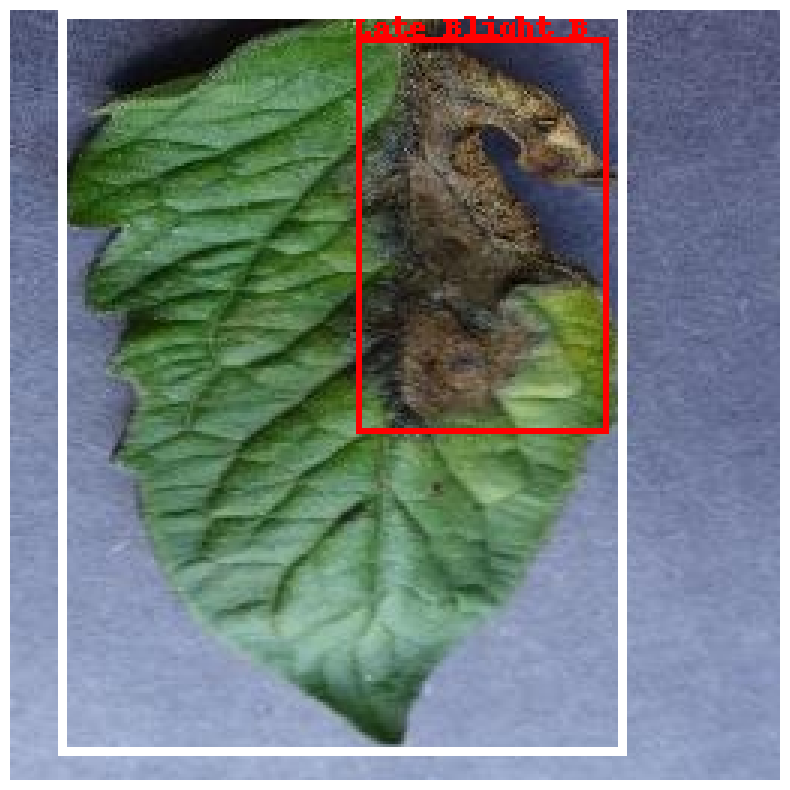

Processing Tomato_Septoria_leaf_spot45.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot45.jpg: 256x256 1 Tomato_Leaf, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 12 Septoria Spot_Bs, 173.3ms
Speed: 1.4ms preprocess, 173.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


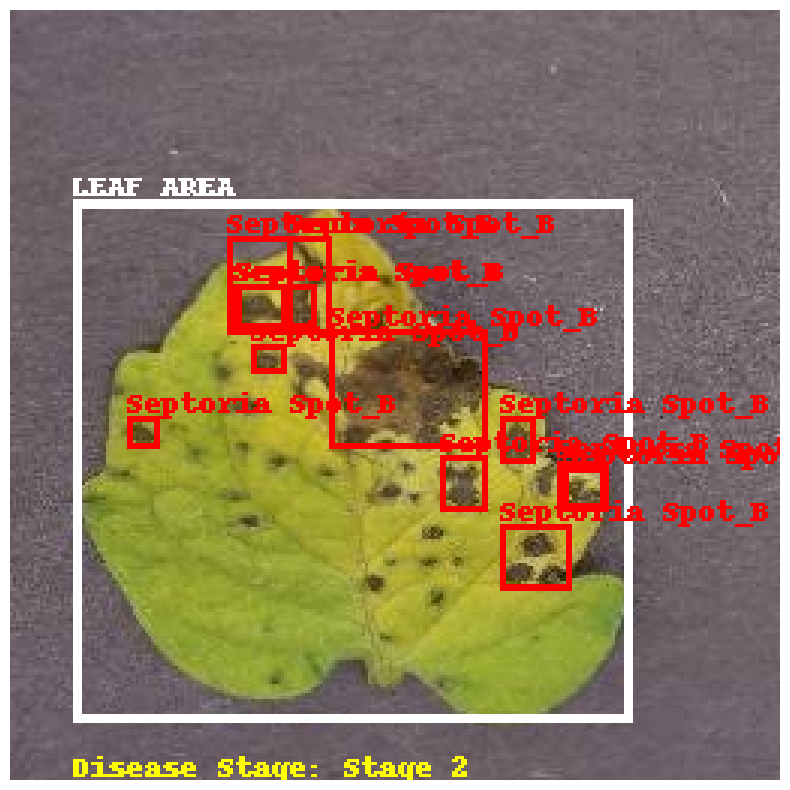

Processing Tomato_Septoria_leaf_spot248.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot248.jpg: 256x256 1 Tomato_Leaf, 206.7ms
Speed: 0.9ms preprocess, 206.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 200.7ms
Speed: 1.1ms preprocess, 200.7ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 1


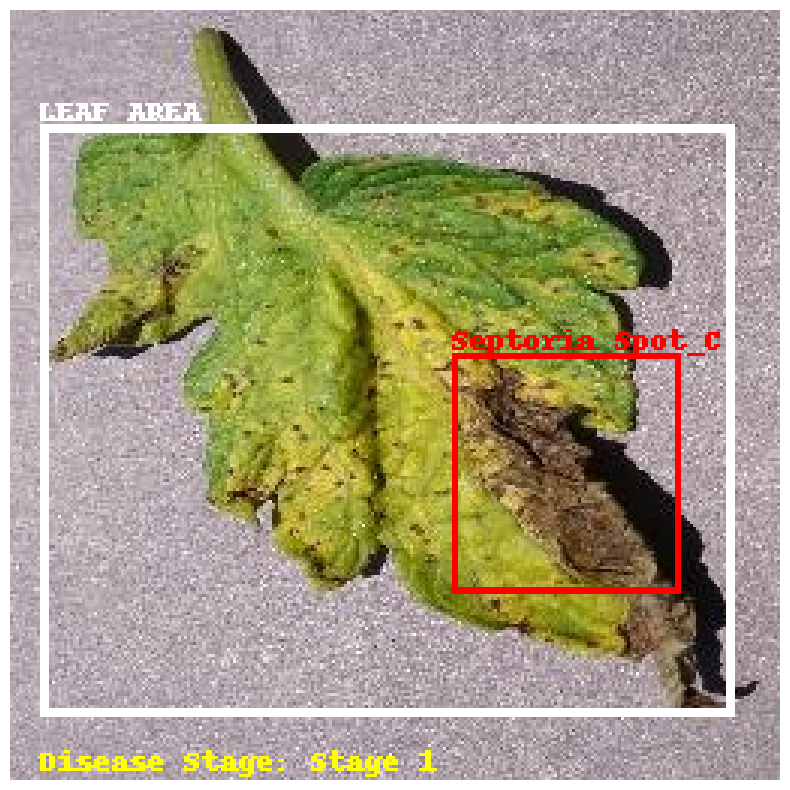

Processing Tomato_Early_blight180.jpg_Horizontally_flip.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight180.jpg_Horizontally_flip.jpg: 256x256 1 Tomato_Leaf, 135.5ms
Speed: 0.8ms preprocess, 135.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Early Blight_B, 125.9ms
Speed: 2.0ms preprocess, 125.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


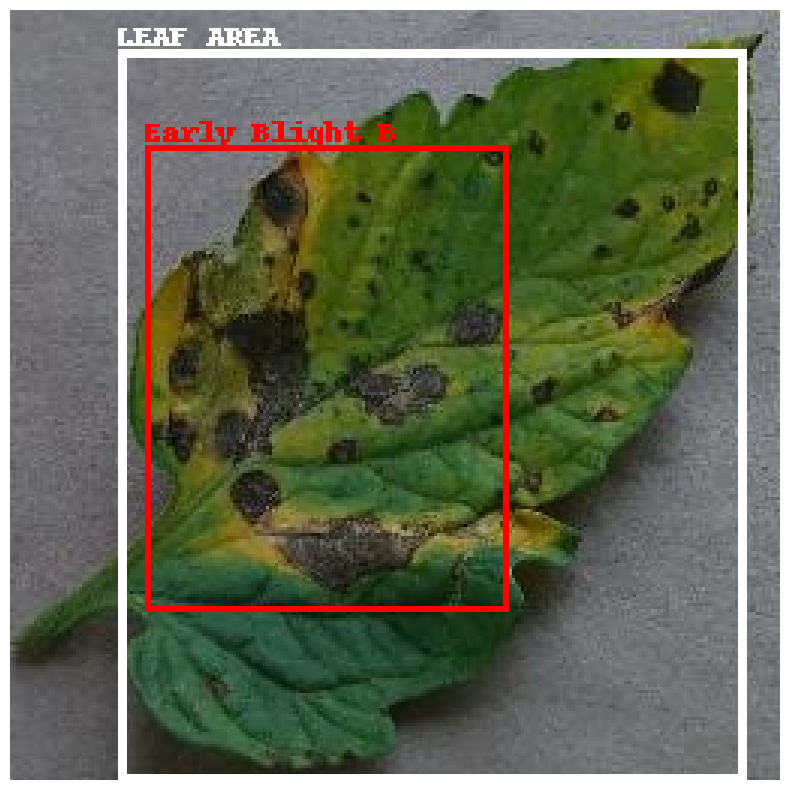

Processing Tomato_Late_blight34.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight34.jpg: 256x256 1 Tomato_Leaf, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 142.3ms
Speed: 1.2ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


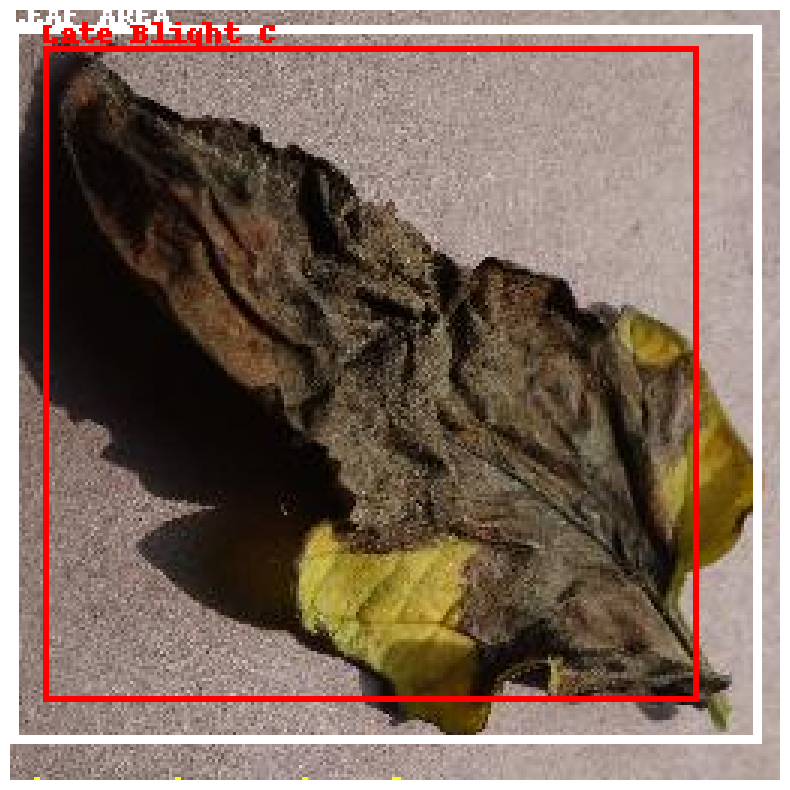

Processing Tomato_Early_blight187.jpg_Flip_Horizontally_and_Vertically.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight187.jpg_Flip_Horizontally_and_Vertically.jpg: 256x256 1 Tomato_Leaf, 193.5ms
Speed: 0.9ms preprocess, 193.5ms inference, 4.4ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 228.2ms
Speed: 1.3ms preprocess, 228.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


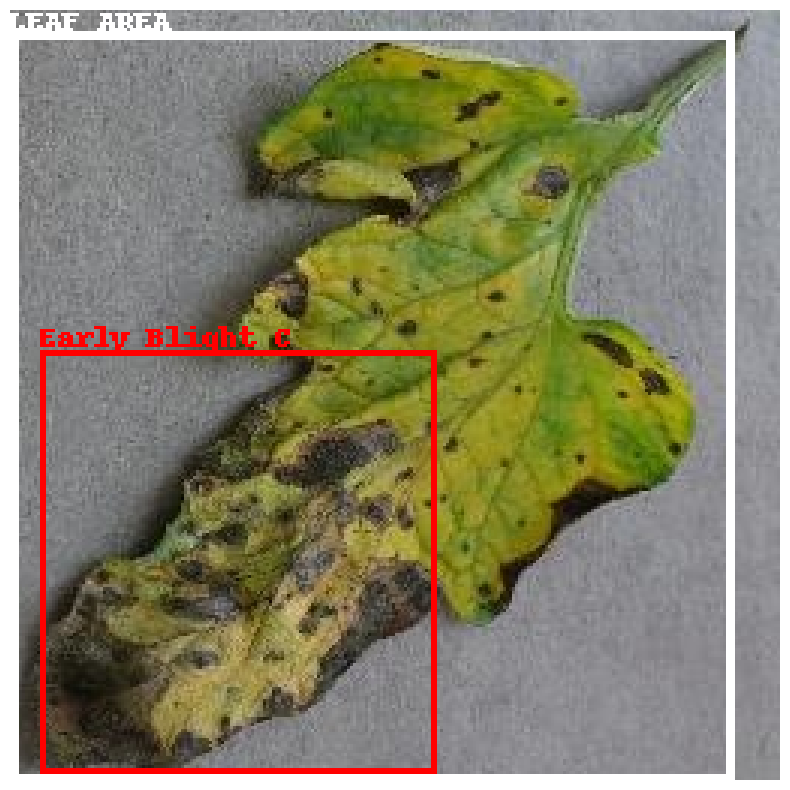

Accuracy: 0.6551724137931034
Confusion Matrix:
[[6 0 0]
 [2 6 0]
 [2 6 7]]
Classification Report:
              precision    recall  f1-score   support

     Stage 1       0.60      1.00      0.75         6
     Stage 2       0.50      0.75      0.60         8
     Stage 3       1.00      0.47      0.64        15

    accuracy                           0.66        29
   macro avg       0.70      0.74      0.66        29
weighted avg       0.78      0.66      0.65        29



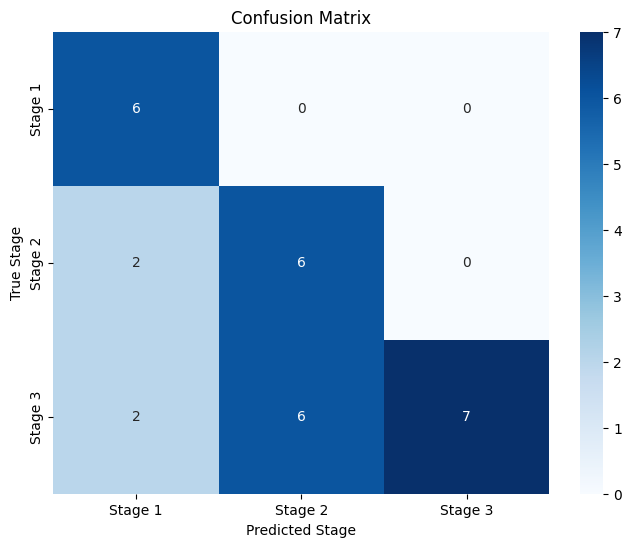

In [ ]:
evaluate_pipeline_on_test_images(test_folder)

Processing Tomato_Septoria_leaf_spot72.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot72.jpg: 256x256 1 Tomato_Leaf, 109.5ms
Speed: 1.0ms preprocess, 109.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_Cs, 104.1ms
Speed: 1.3ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-33-16562969b4d8>:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


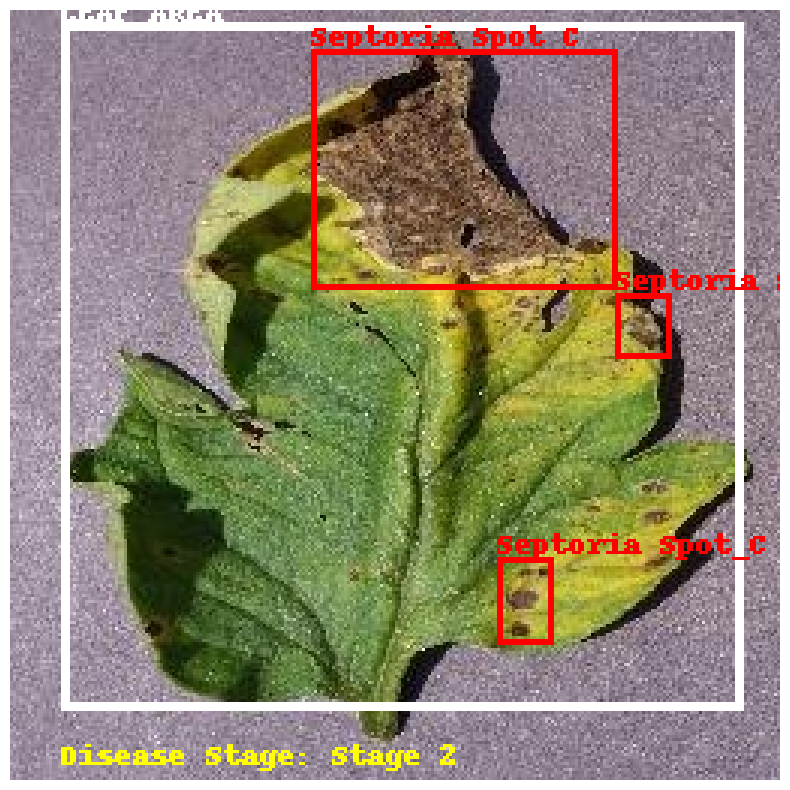

Processing Tomato_Late_blight81.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight81.jpg: 256x256 1 Tomato_Leaf, 111.1ms
Speed: 0.7ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_B, 167.3ms
Speed: 1.3ms preprocess, 167.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


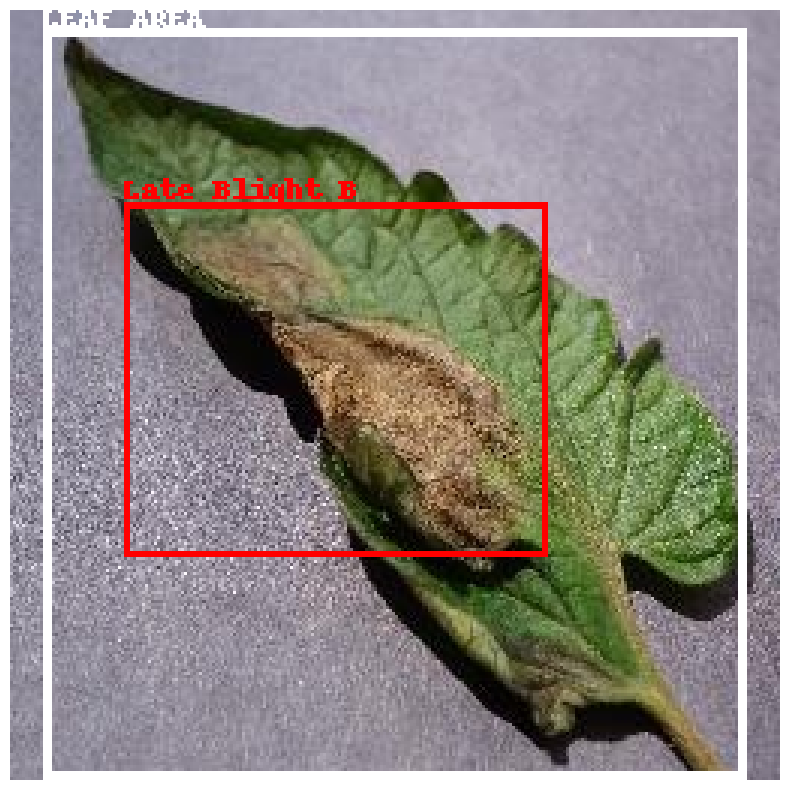

Processing Tomato_Septoria_leaf_spot16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot16.jpg: 256x256 1 Tomato_Leaf, 182.8ms
Speed: 0.8ms preprocess, 182.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_As, 112.5ms
Speed: 1.2ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


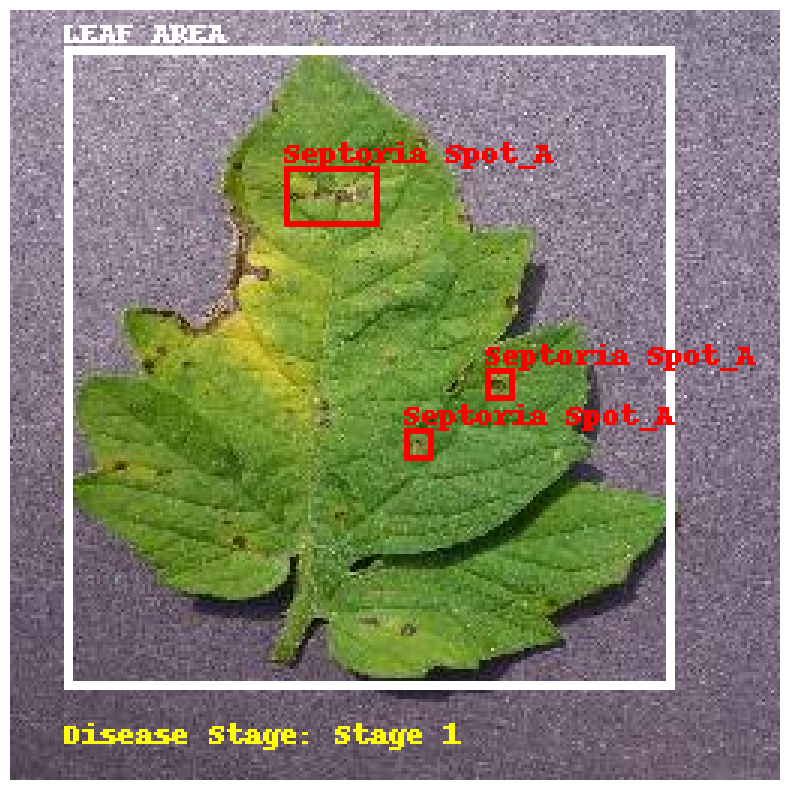

Processing Tomato_Septoria_leaf_spot53.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot53.jpg: 256x256 1 Tomato_Leaf, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Septoria Spot_As, 102.5ms
Speed: 1.1ms preprocess, 102.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


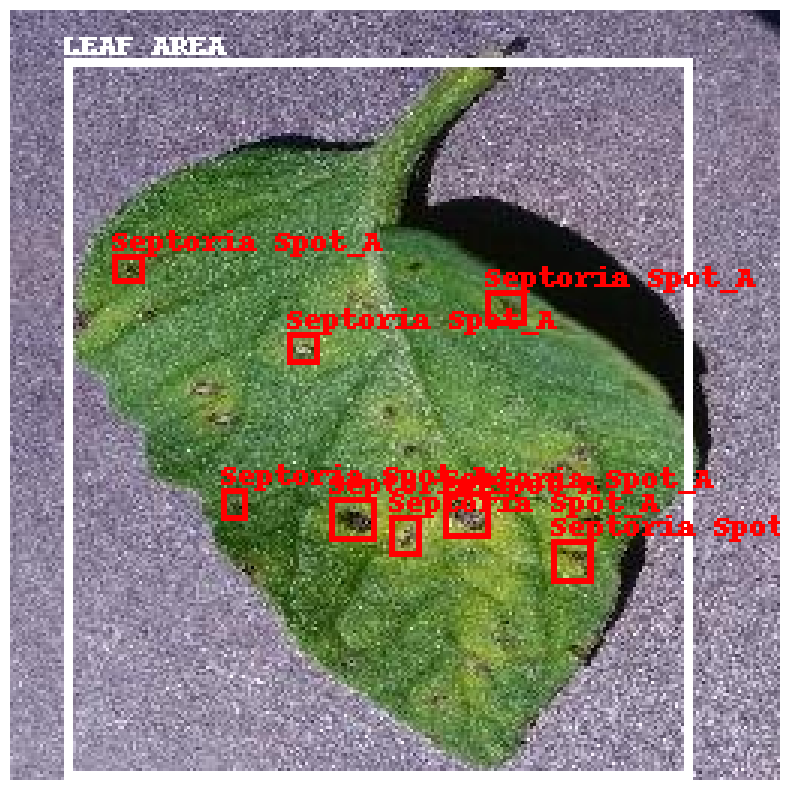

Processing Tomato_Septoria_leaf_spot432.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot432.jpg: 256x256 1 Tomato_Leaf, 115.9ms
Speed: 1.0ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 102.5ms
Speed: 1.2ms preprocess, 102.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 3


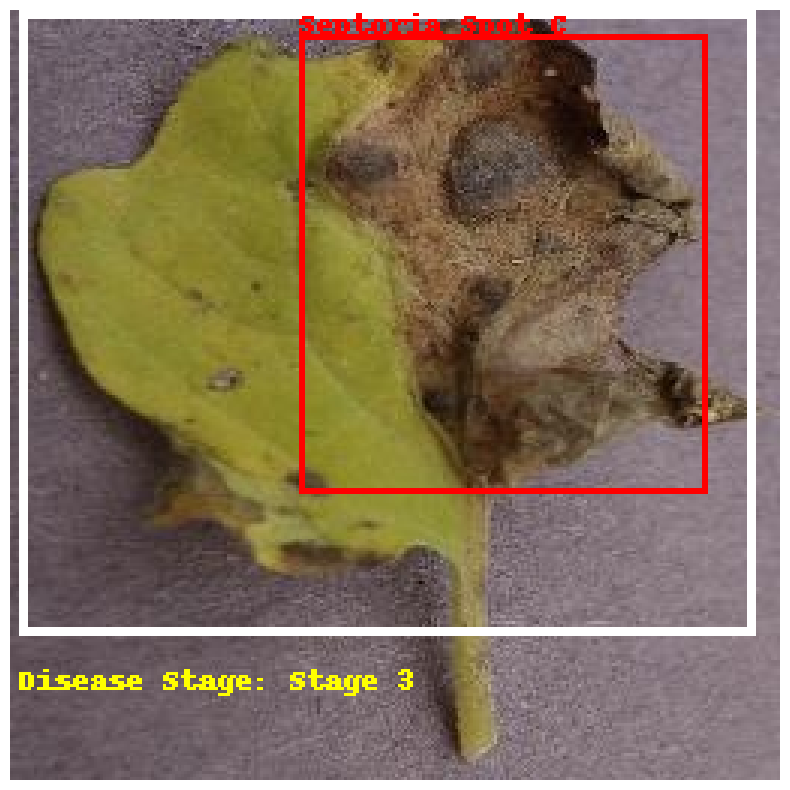

Processing Tomato_Late_blight571.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight571.jpg: 256x256 1 Tomato_Leaf, 163.9ms
Speed: 1.1ms preprocess, 163.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 186.7ms
Speed: 1.2ms preprocess, 186.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


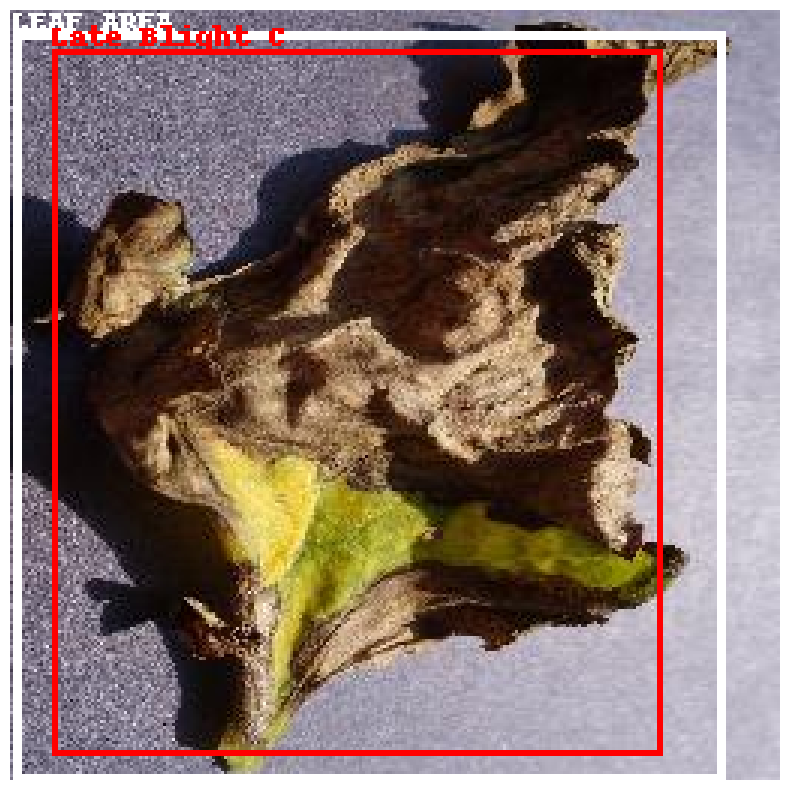

Processing Tomato_Late_blight155.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight155.jpg: 256x256 1 Tomato_Leaf, 196.4ms
Speed: 0.8ms preprocess, 196.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 118.6ms
Speed: 3.0ms preprocess, 118.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


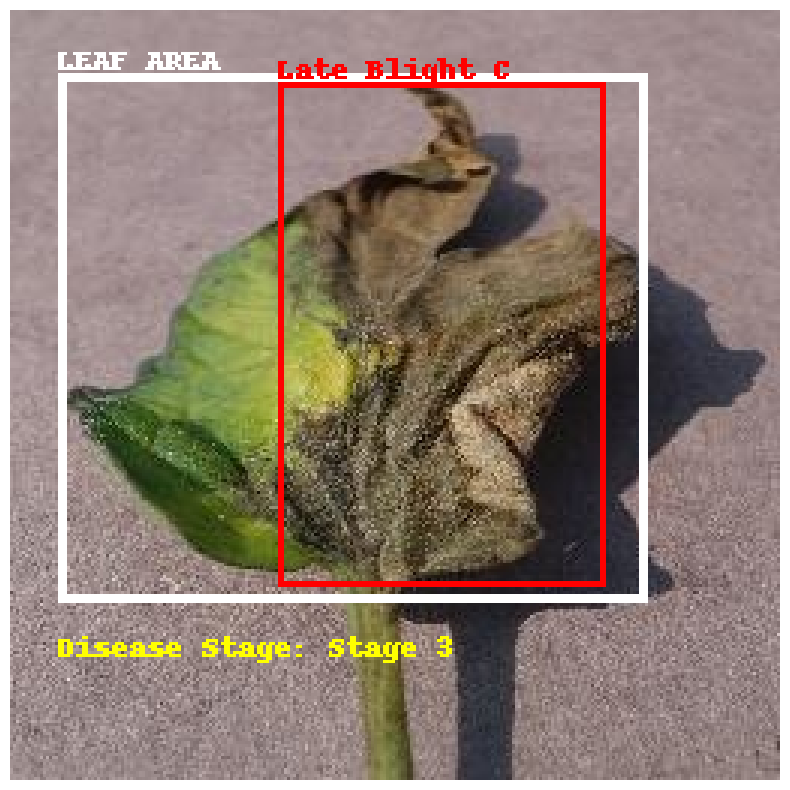

Processing Tomato_Early_blight37.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight37.jpg: 256x256 1 Tomato_Leaf, 115.3ms
Speed: 1.2ms preprocess, 115.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 5 Early Blight_As, 110.8ms
Speed: 1.4ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


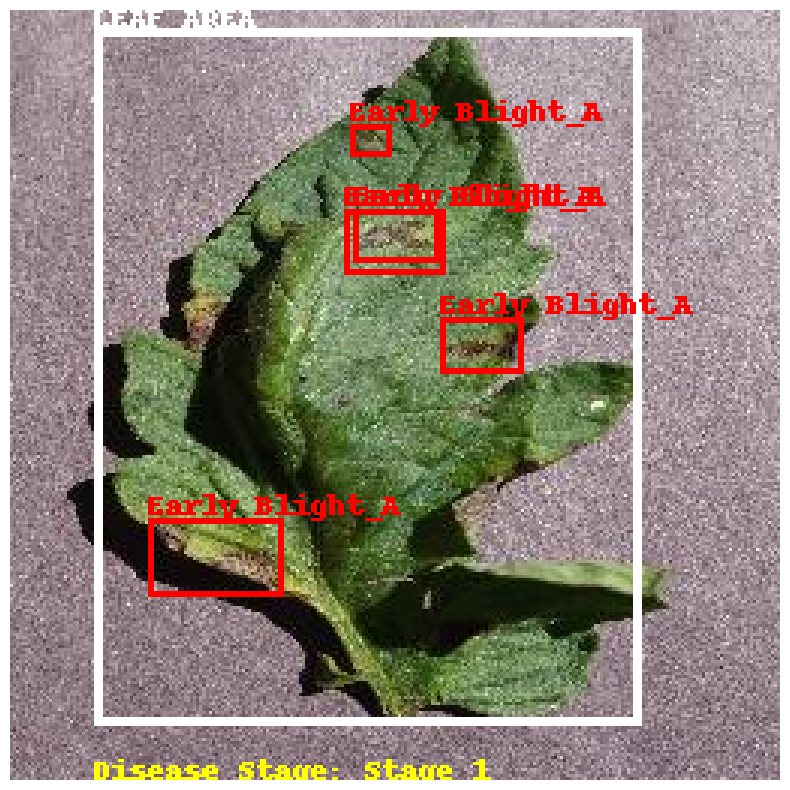

Processing Tomato_Early_blight228.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight228.jpg: 256x256 1 Tomato_Leaf, 116.0ms
Speed: 0.8ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Cs, 120.7ms
Speed: 1.5ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


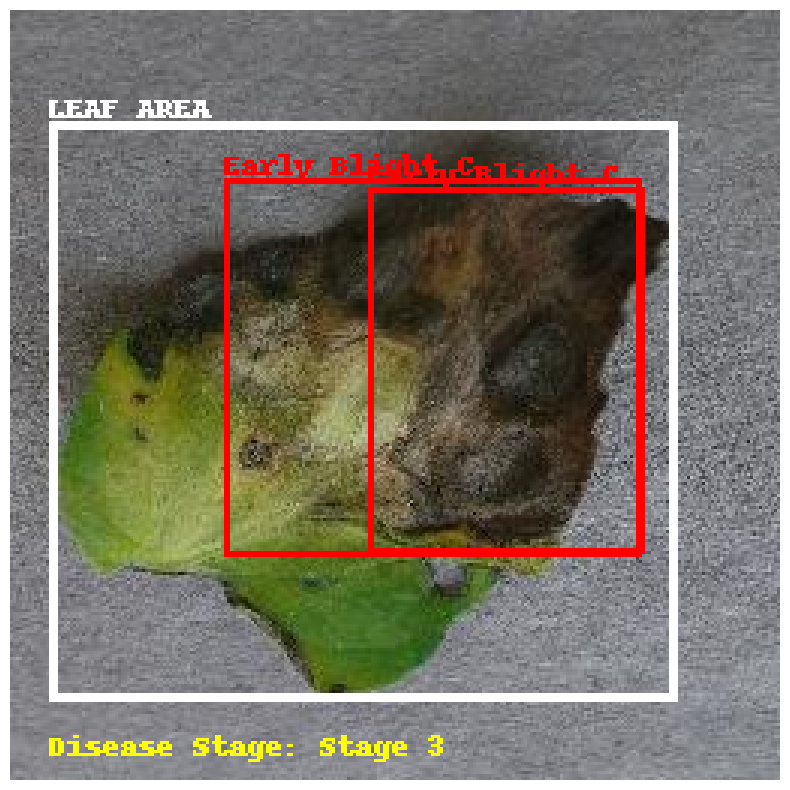

Processing Tomato_Early_blight62.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight62.jpg: 256x256 1 Tomato_Leaf, 189.8ms
Speed: 0.9ms preprocess, 189.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Early Blight_Bs, 207.0ms
Speed: 1.2ms preprocess, 207.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


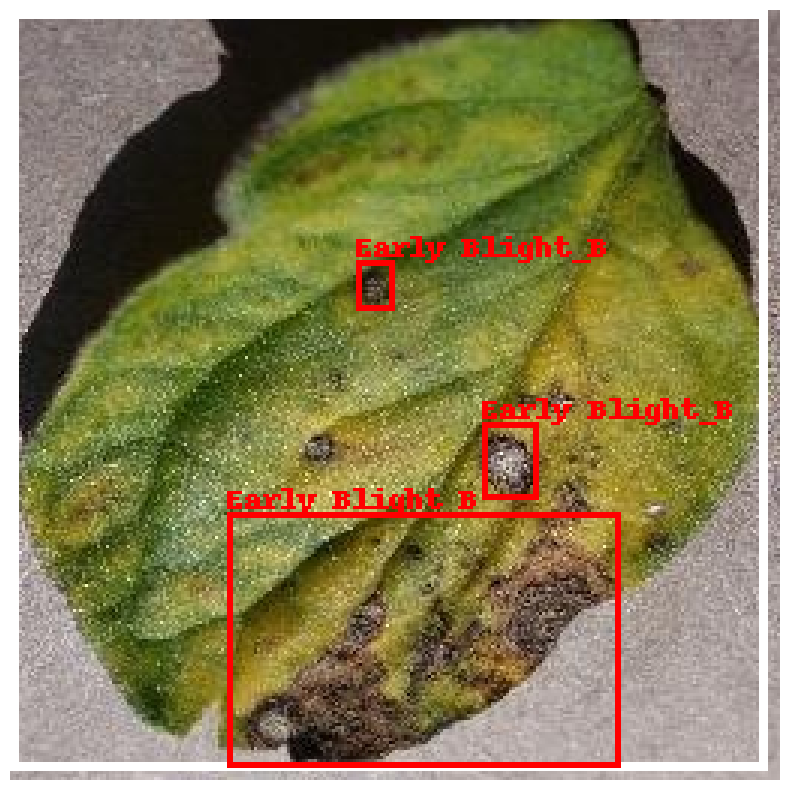

Processing Tomato_Bacterial_spot895.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot895.jpg: 256x256 1 Tomato_Leaf, 185.5ms
Speed: 1.0ms preprocess, 185.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 131.6ms
Speed: 1.2ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


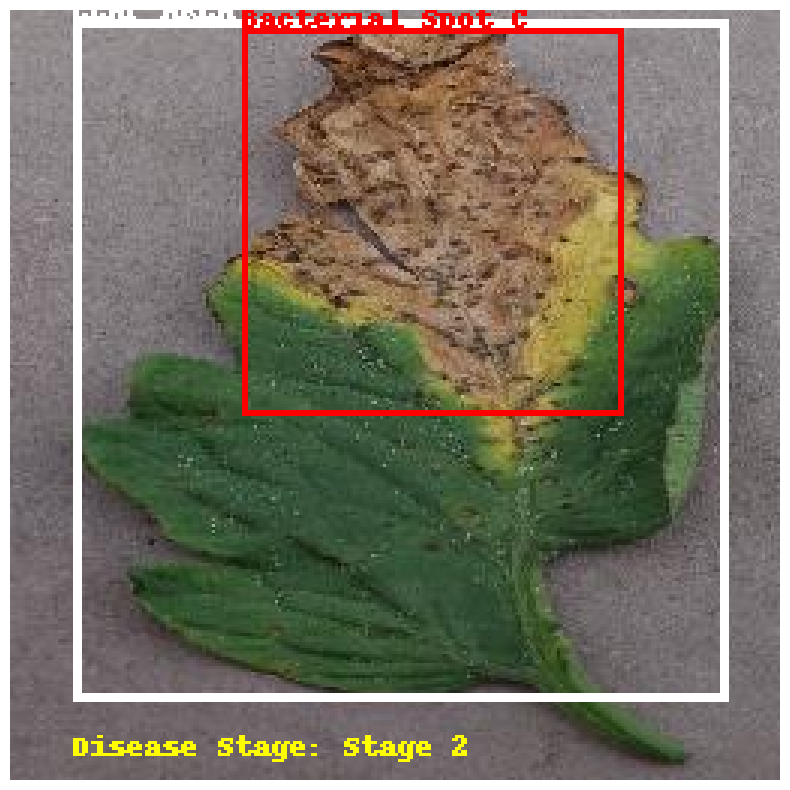

Processing Tomato_Early_blight16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight16.jpg: 256x256 1 Tomato_Leaf, 129.2ms
Speed: 0.8ms preprocess, 129.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 123.3ms
Speed: 1.3ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


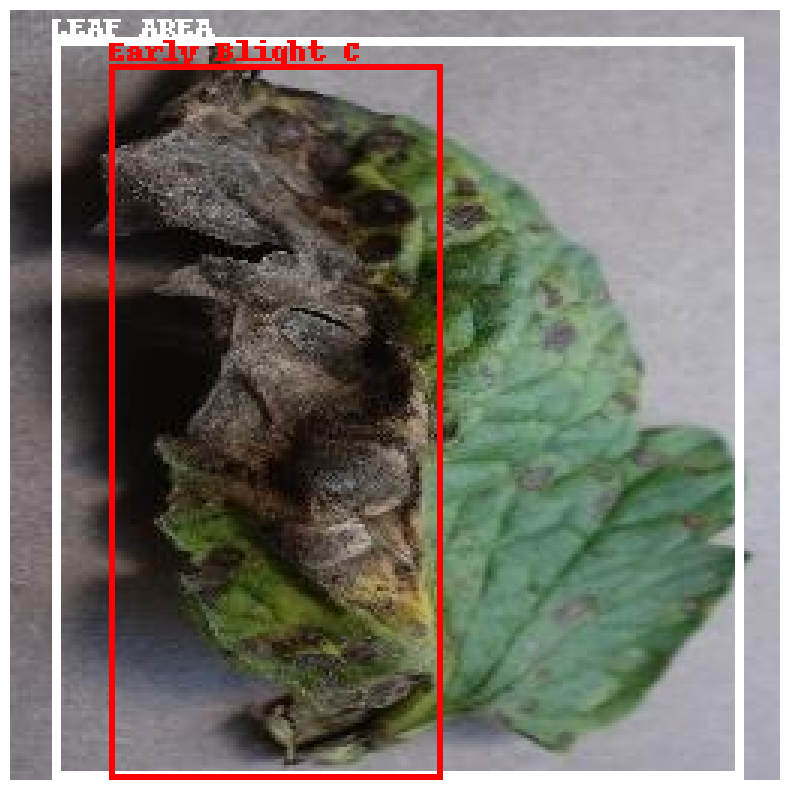

Processing Tomato_Bacterial_spot9.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot9.jpg: 256x256 1 Tomato_Leaf, 127.9ms
Speed: 1.2ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Bacterial Spot_As, 163.9ms
Speed: 1.5ms preprocess, 163.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


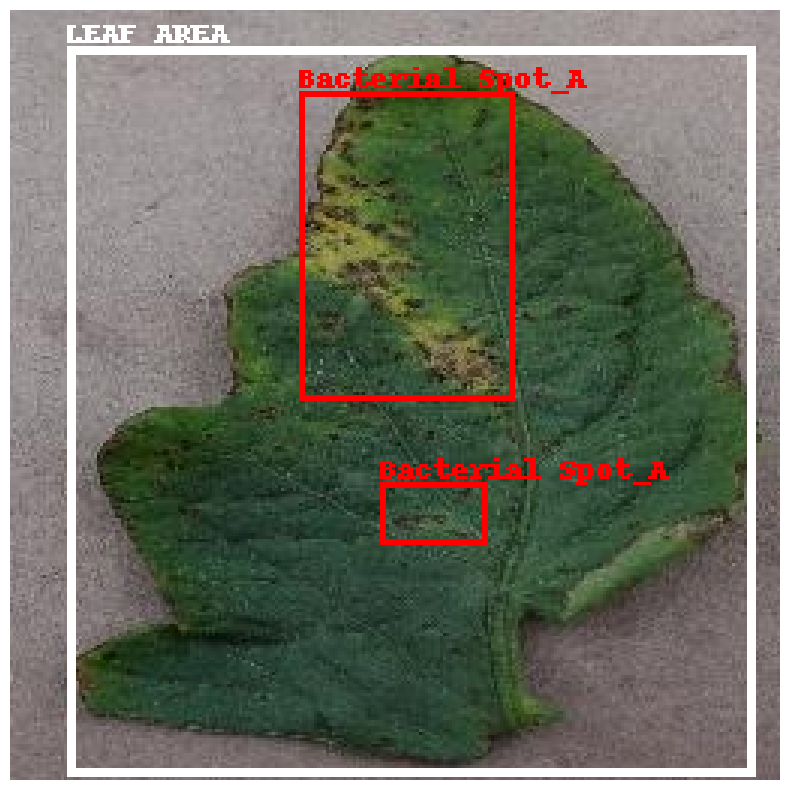

Processing Tomato_Early_blight175.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight175.jpg: 256x256 1 Tomato_Leaf, 183.2ms
Speed: 0.9ms preprocess, 183.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Early Blight_As, 195.8ms
Speed: 1.1ms preprocess, 195.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


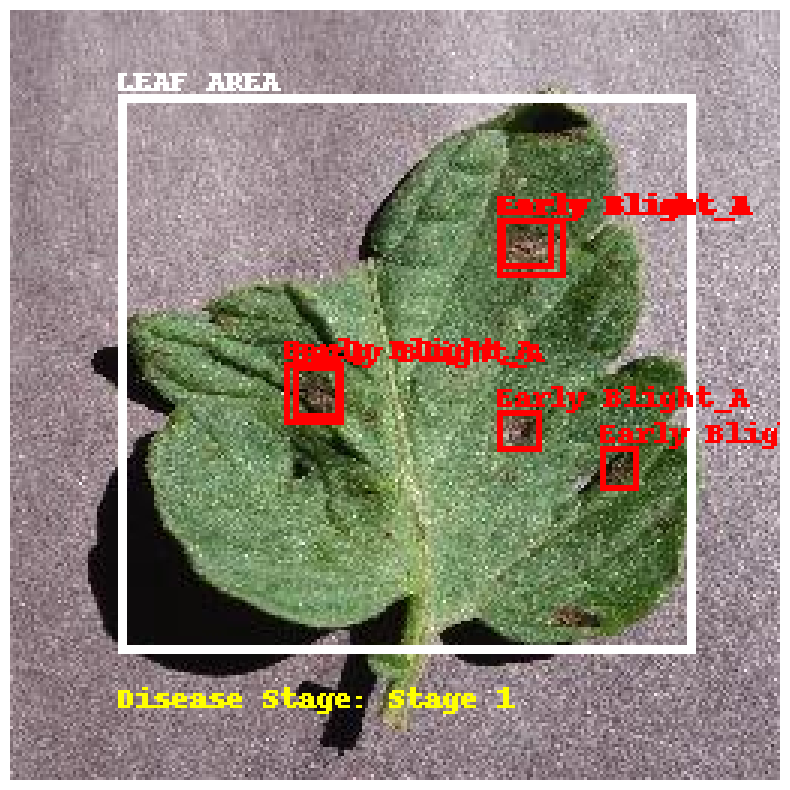

Processing Tomato_Bacterial_spot1031.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot1031.jpg: 256x256 1 Tomato_Leaf, 184.7ms
Speed: 0.8ms preprocess, 184.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_B, 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


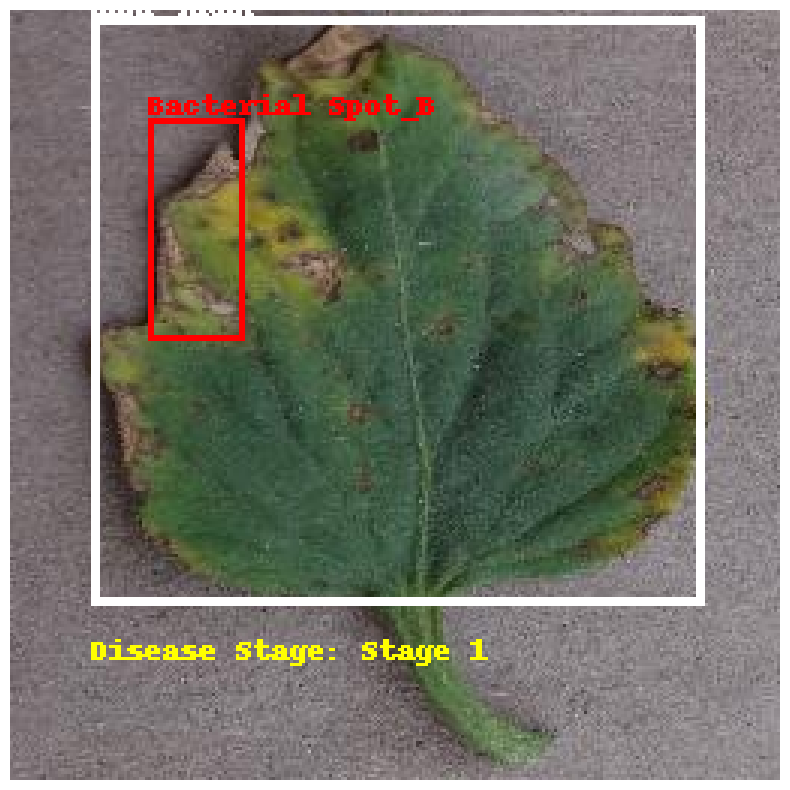

Processing Tomato_Early_blight14.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight14.jpg: 256x256 1 Tomato_Leaf, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 130.0ms
Speed: 7.0ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


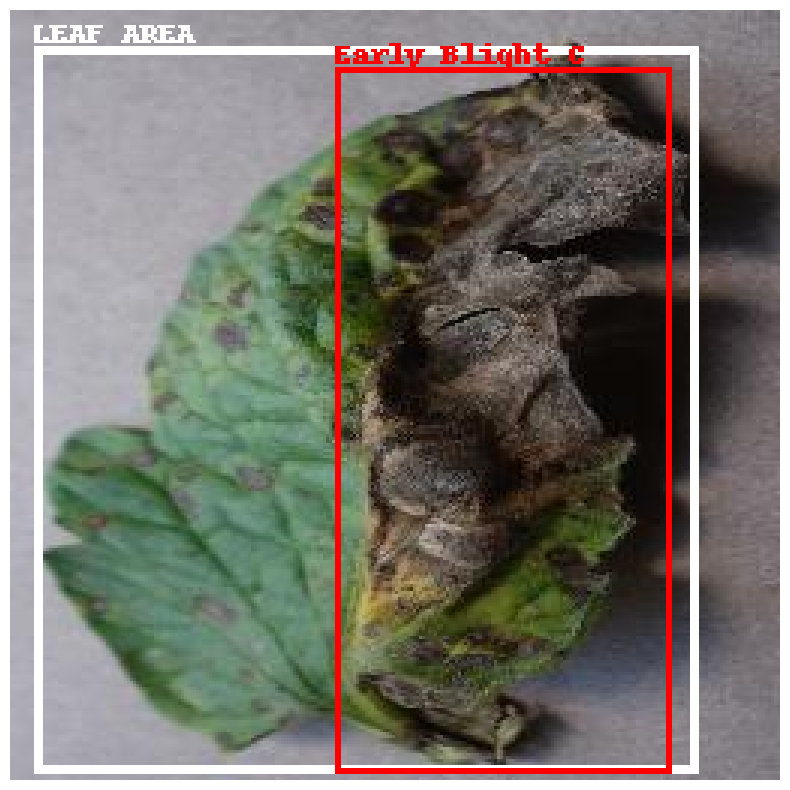

Processing Tomato_Septoria_leaf_spot1324.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot1324.jpg: 256x256 1 Tomato_Leaf, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 12 Septoria Spot_Bs, 132.0ms
Speed: 1.1ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


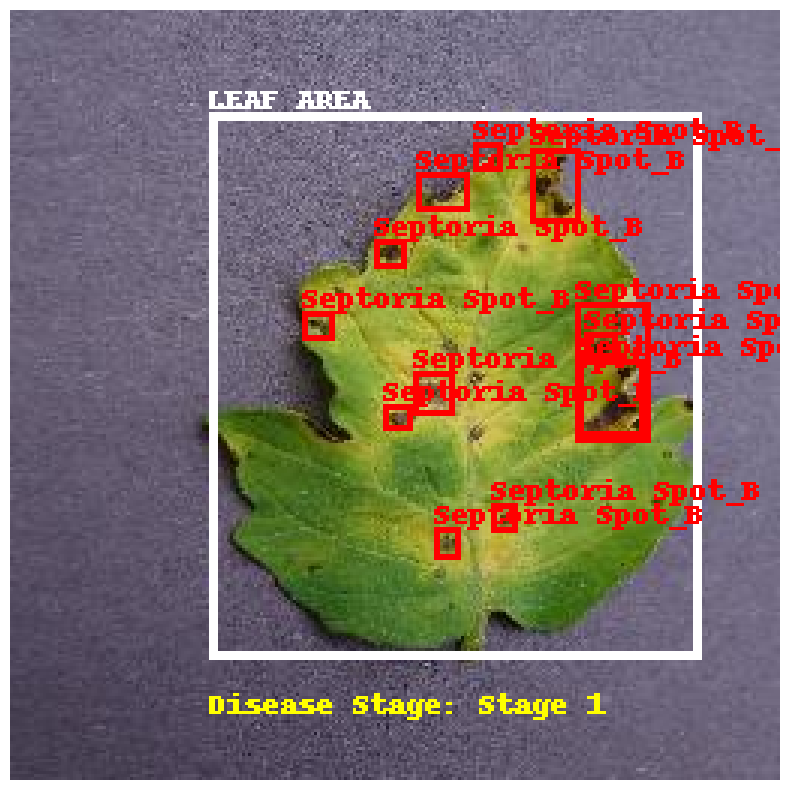

Processing Tomato_Septoria_leaf_spot327.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot327.jpg: 256x256 1 Tomato_Leaf, 203.6ms
Speed: 0.9ms preprocess, 203.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 13 Septoria Spot_Bs, 189.9ms
Speed: 1.5ms preprocess, 189.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


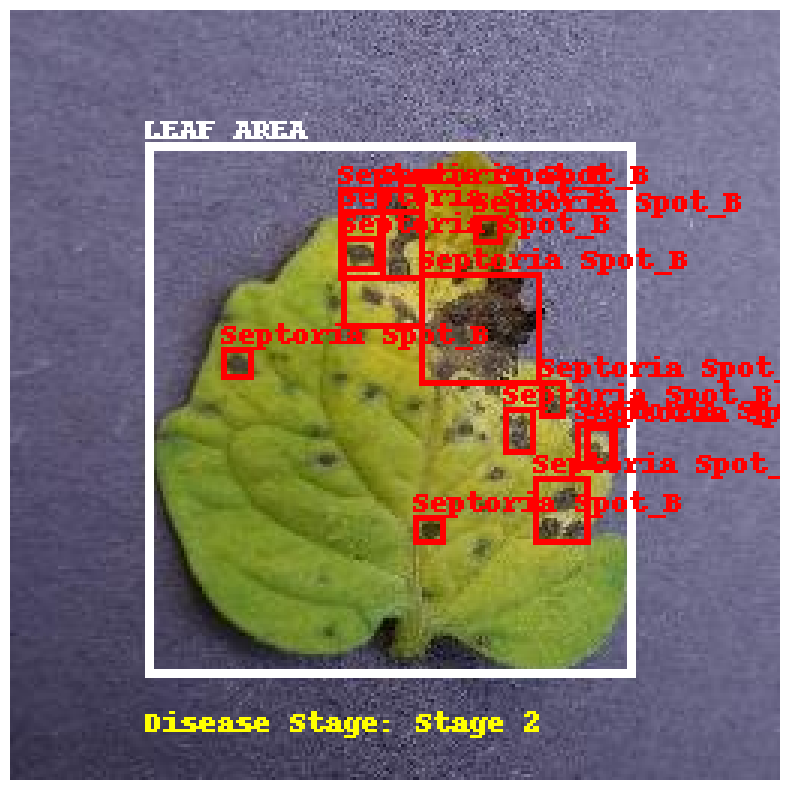

Processing Tomato_Late_blight108.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight108.jpg: 256x256 1 Tomato_Leaf, 171.6ms
Speed: 1.0ms preprocess, 171.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_A, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


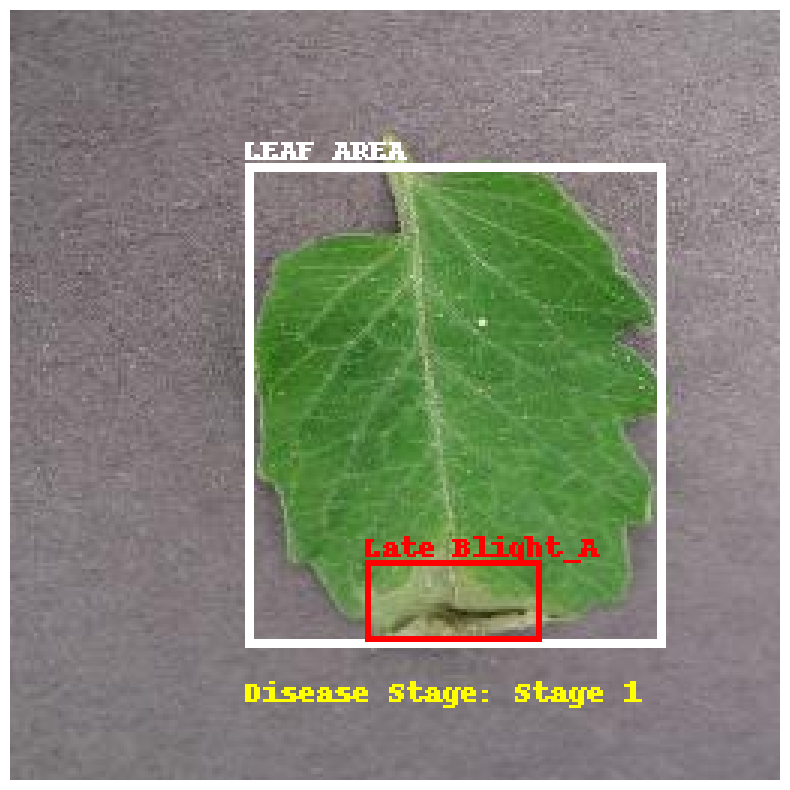

Processing Tomato_Late_blight170.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight170.jpg: 256x256 1 Tomato_Leaf, 136.6ms
Speed: 2.1ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_B, 124.3ms
Speed: 1.1ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


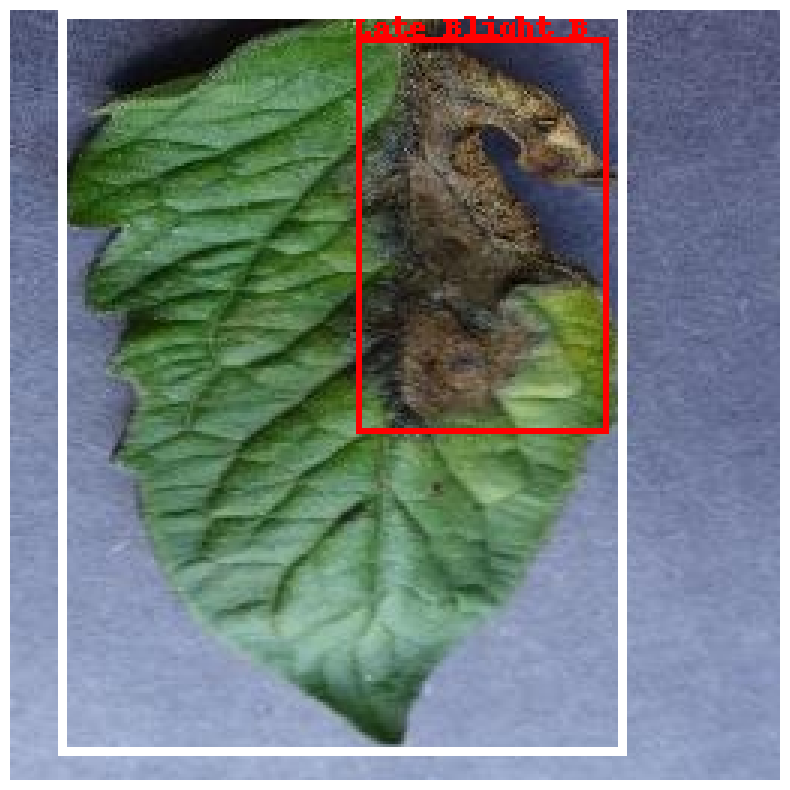

Processing Tomato_Septoria_leaf_spot45.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot45.jpg: 256x256 1 Tomato_Leaf, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 12 Septoria Spot_Bs, 138.9ms
Speed: 1.5ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


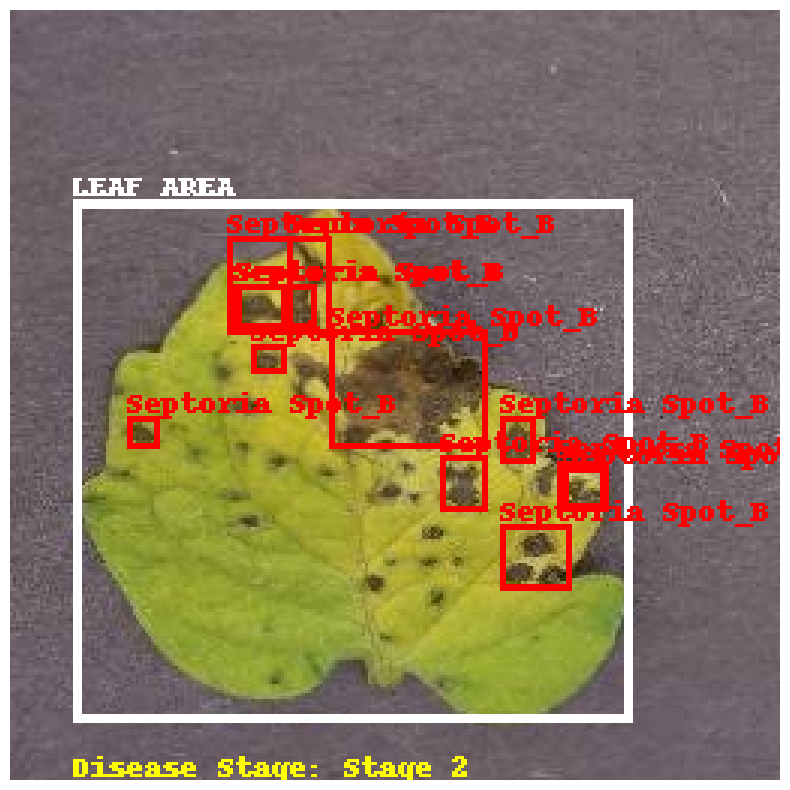

Processing Tomato_Septoria_leaf_spot248.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot248.jpg: 256x256 1 Tomato_Leaf, 218.0ms
Speed: 0.9ms preprocess, 218.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 212.4ms
Speed: 1.1ms preprocess, 212.4ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 1


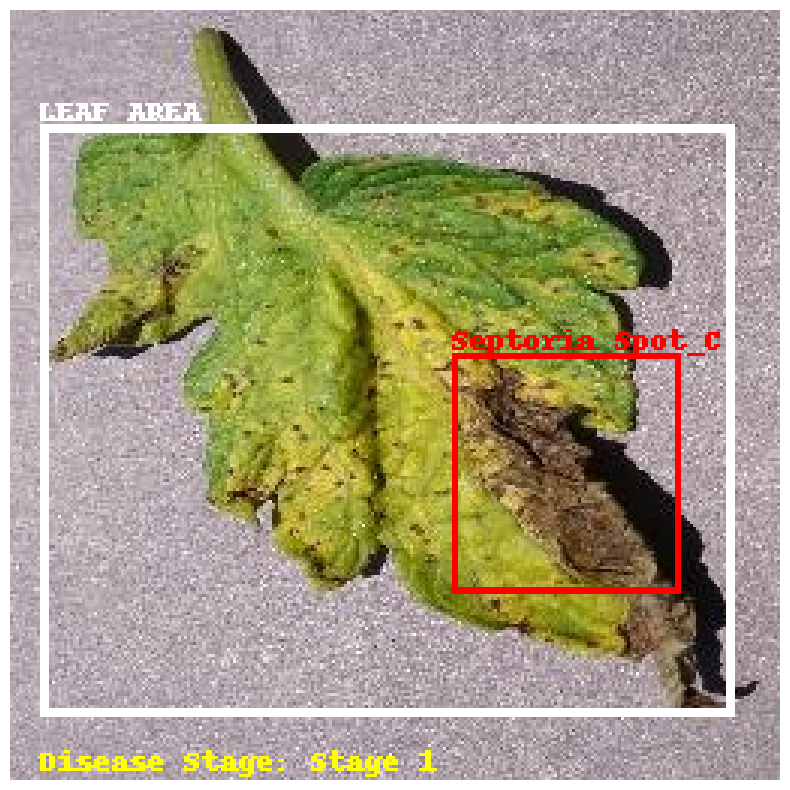

Processing Tomato_Early_blight180.jpg_Horizontally_flip.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight180.jpg_Horizontally_flip.jpg: 256x256 1 Tomato_Leaf, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Early Blight_B, 144.7ms
Speed: 1.2ms preprocess, 144.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


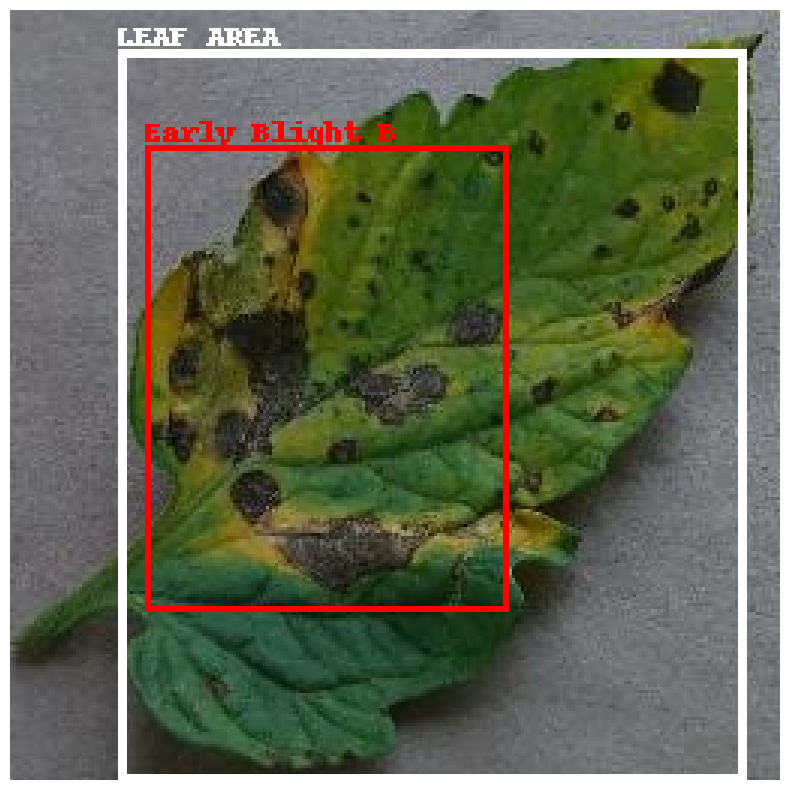

Processing Tomato_Late_blight34.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight34.jpg: 256x256 1 Tomato_Leaf, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 143.9ms
Speed: 1.5ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


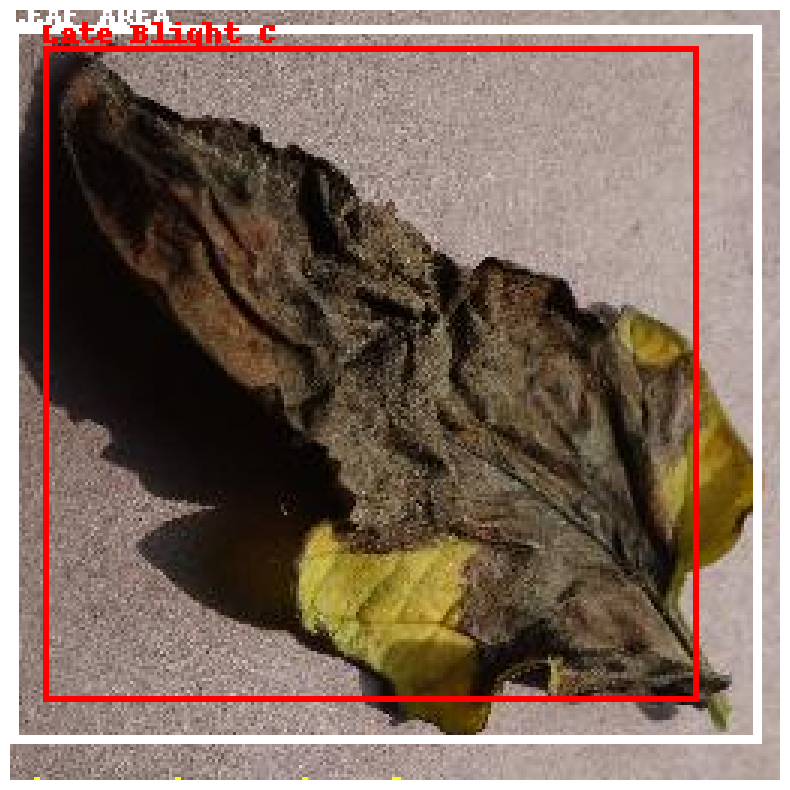

Accuracy: 0.7916666666666666
Confusion Matrix:
[[6 0 0]
 [2 6 0]
 [1 2 7]]
Classification Report:
              precision    recall  f1-score   support

     Stage 1       0.67      1.00      0.80         6
     Stage 2       0.75      0.75      0.75         8
     Stage 3       1.00      0.70      0.82        10

    accuracy                           0.79        24
   macro avg       0.81      0.82      0.79        24
weighted avg       0.83      0.79      0.79        24



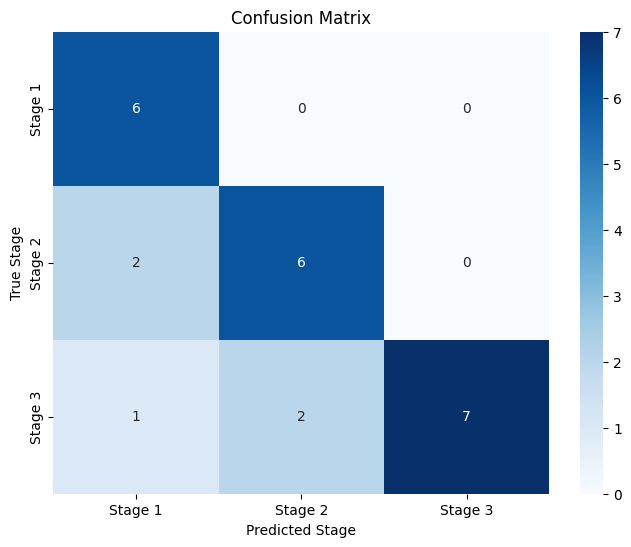

In [ ]:
evaluate_pipeline_on_test_images(test_folder)

Processing Tomato_Septoria_leaf_spot72.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot72.jpg: 256x256 1 Tomato_Leaf, 210.2ms
Speed: 2.5ms preprocess, 210.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_Cs, 104.8ms
Speed: 1.1ms preprocess, 104.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


<ipython-input-33-16562969b4d8>:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  disease_name = disease_model.names[int(disease_label)]  # Get the disease name from class label


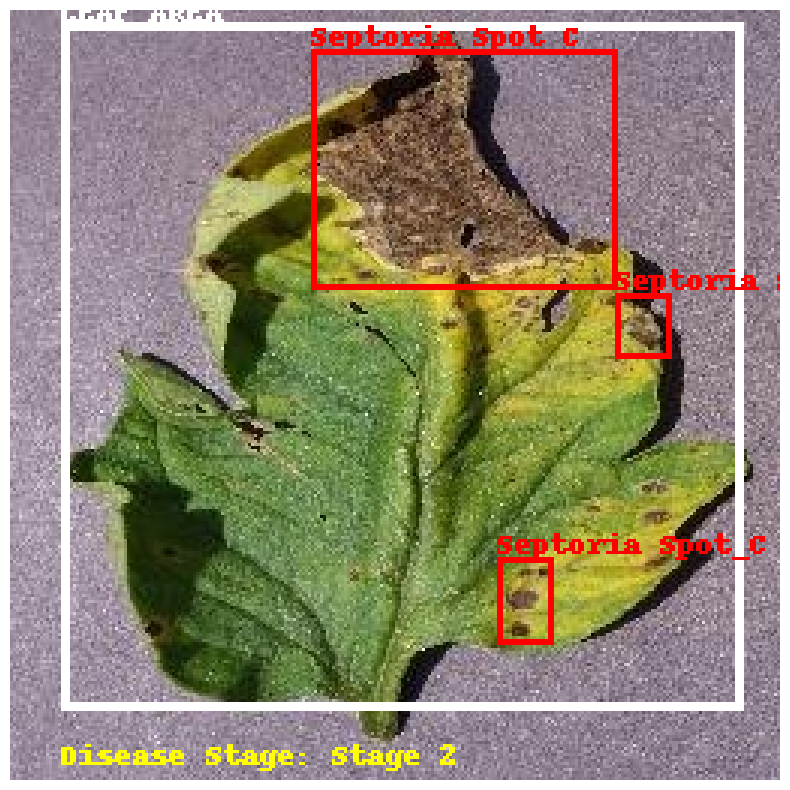

Processing Tomato_Late_blight81.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight81.jpg: 256x256 1 Tomato_Leaf, 108.8ms
Speed: 0.7ms preprocess, 108.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_B, 109.3ms
Speed: 1.2ms preprocess, 109.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


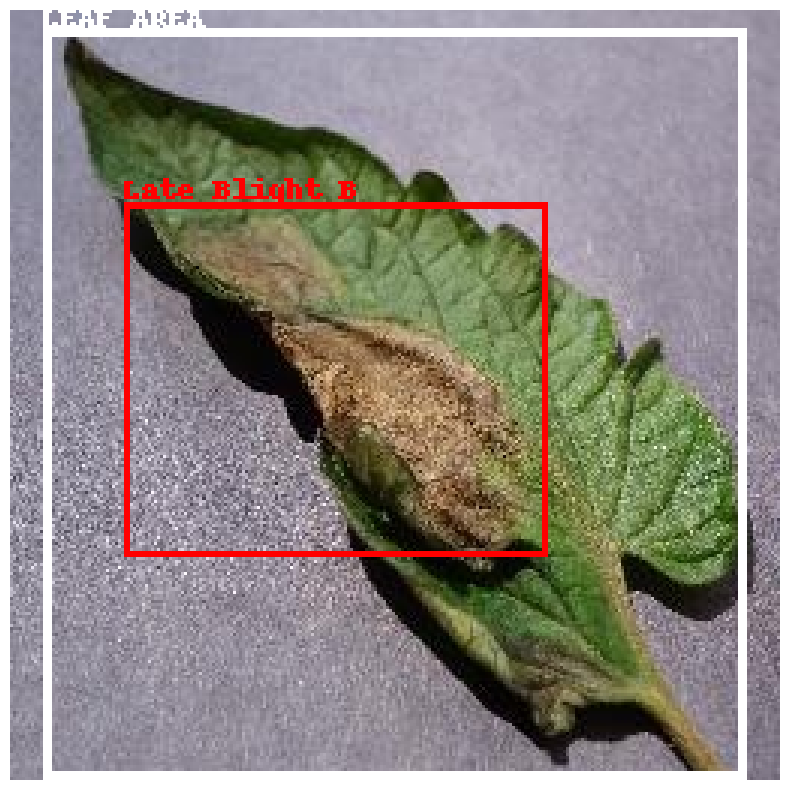

Processing Tomato_Septoria_leaf_spot16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot16.jpg: 256x256 1 Tomato_Leaf, 110.8ms
Speed: 1.1ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Septoria Spot_As, 115.4ms
Speed: 1.4ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


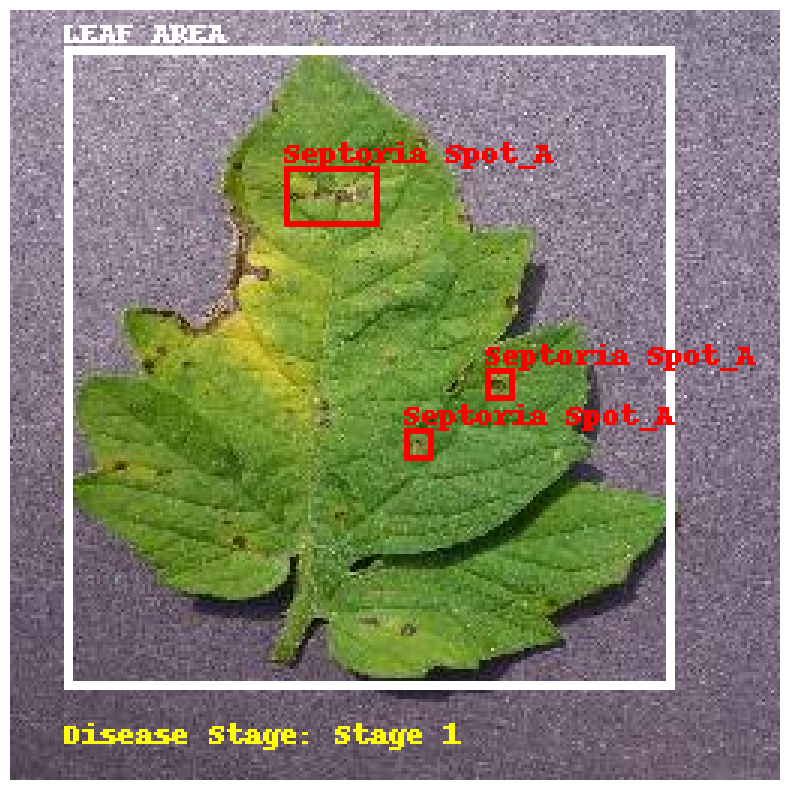

Processing Tomato_Septoria_leaf_spot53.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot53.jpg: 256x256 1 Tomato_Leaf, 171.9ms
Speed: 0.9ms preprocess, 171.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Septoria Spot_As, 163.0ms
Speed: 1.1ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


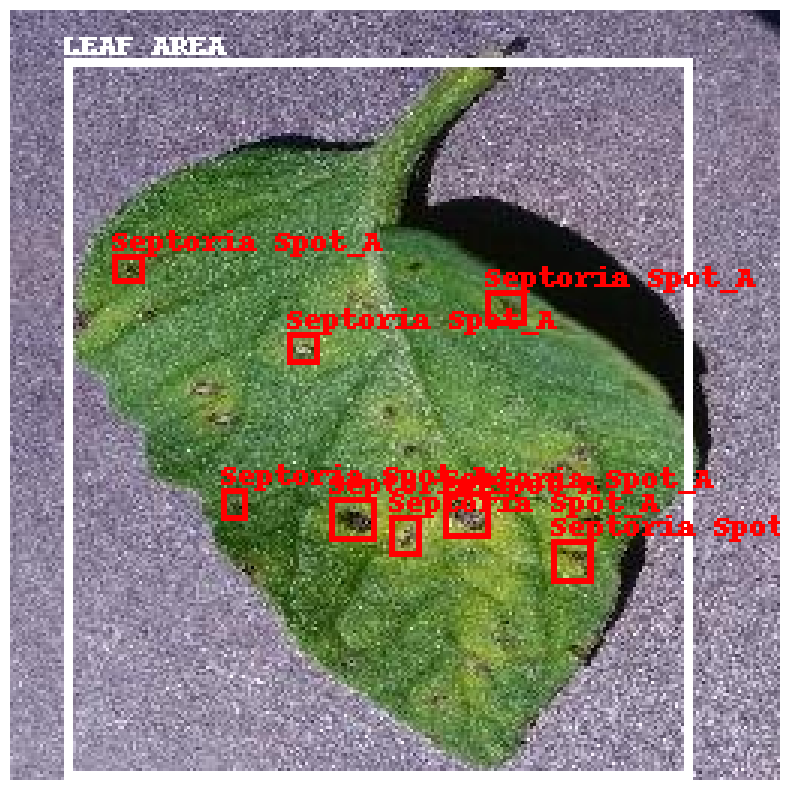

Processing Tomato_Septoria_leaf_spot432.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot432.jpg: 256x256 1 Tomato_Leaf, 192.9ms
Speed: 1.2ms preprocess, 192.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 103.8ms
Speed: 1.2ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 3


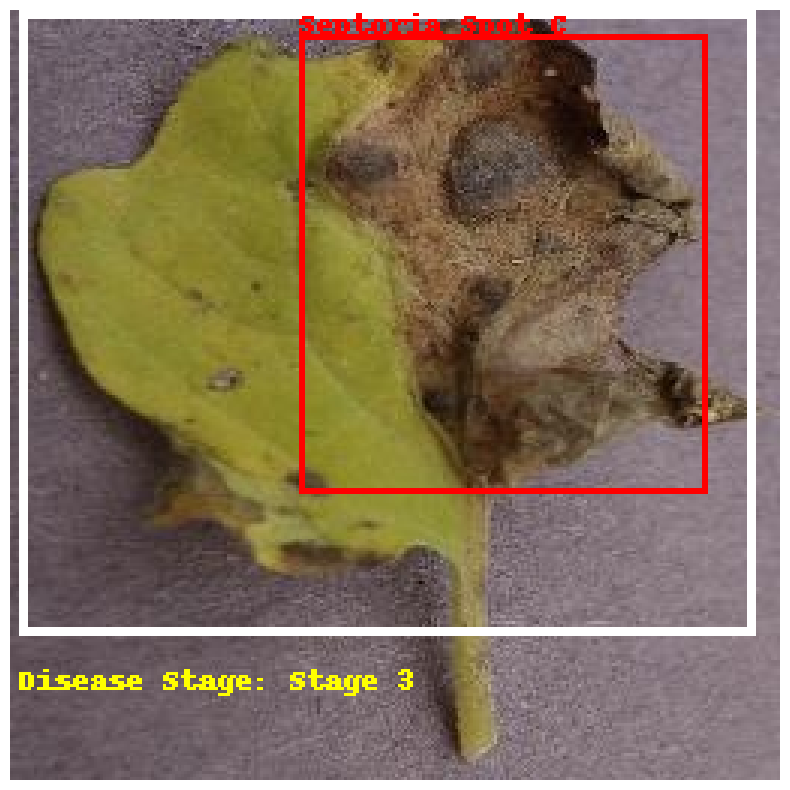

Processing Tomato_Late_blight571.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight571.jpg: 256x256 1 Tomato_Leaf, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 118.8ms
Speed: 2.1ms preprocess, 118.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


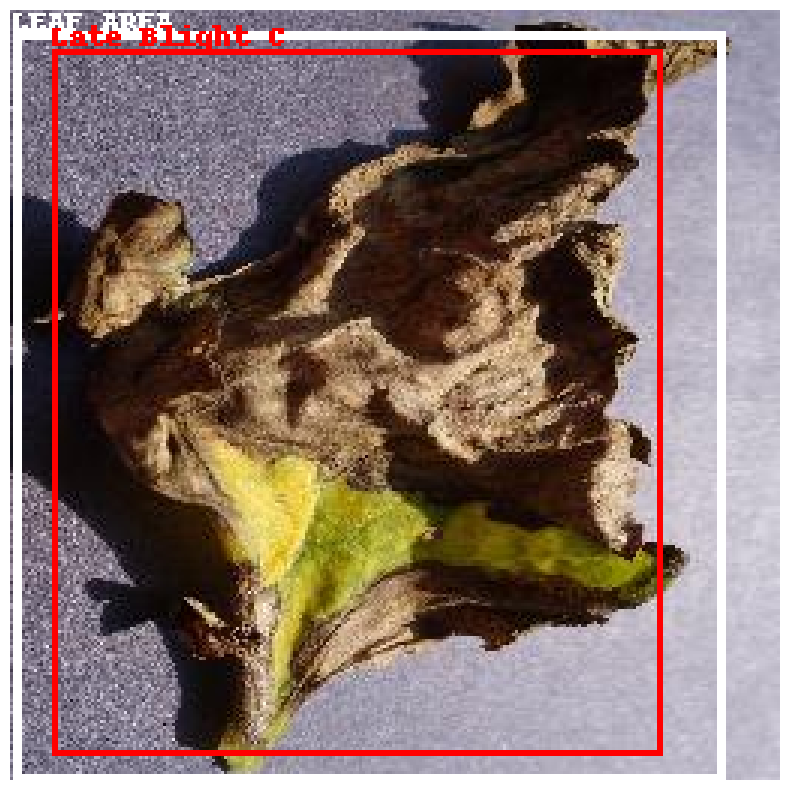

Processing Tomato_Late_blight155.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight155.jpg: 256x256 1 Tomato_Leaf, 116.6ms
Speed: 1.0ms preprocess, 116.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 121.5ms
Speed: 1.1ms preprocess, 121.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


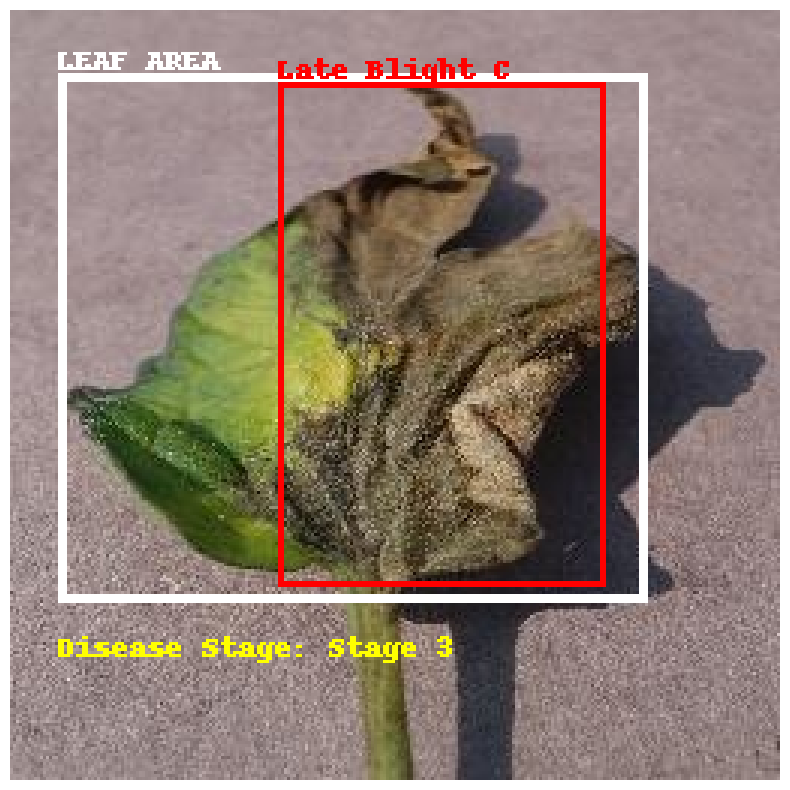

Processing Tomato_Early_blight37.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight37.jpg: 256x256 1 Tomato_Leaf, 173.2ms
Speed: 0.9ms preprocess, 173.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 5 Early Blight_As, 163.8ms
Speed: 1.1ms preprocess, 163.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


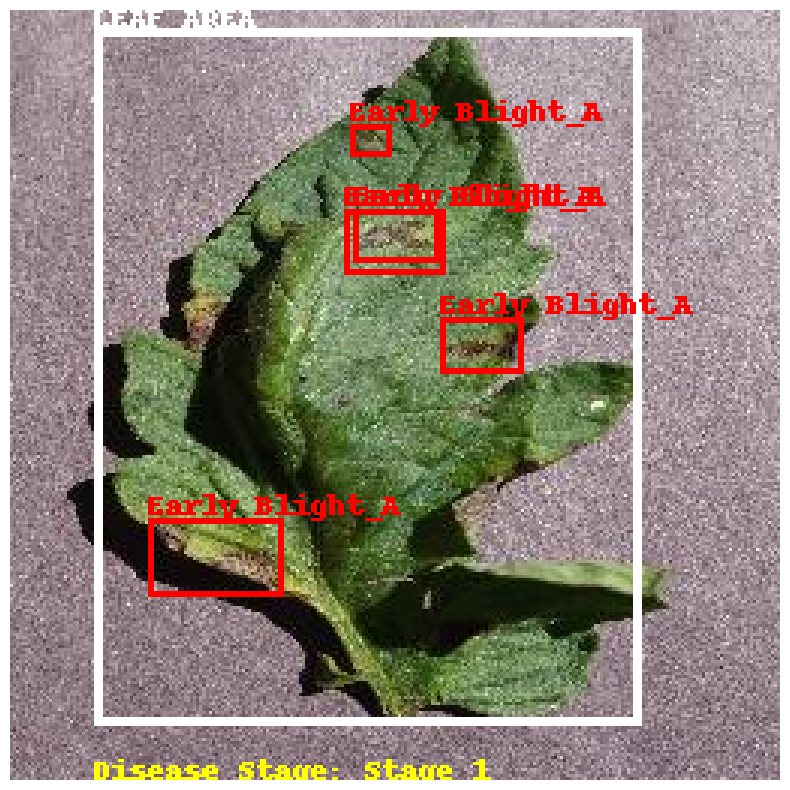

Processing Tomato_Early_blight228.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight228.jpg: 256x256 1 Tomato_Leaf, 196.4ms
Speed: 1.1ms preprocess, 196.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Cs, 118.8ms
Speed: 2.5ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


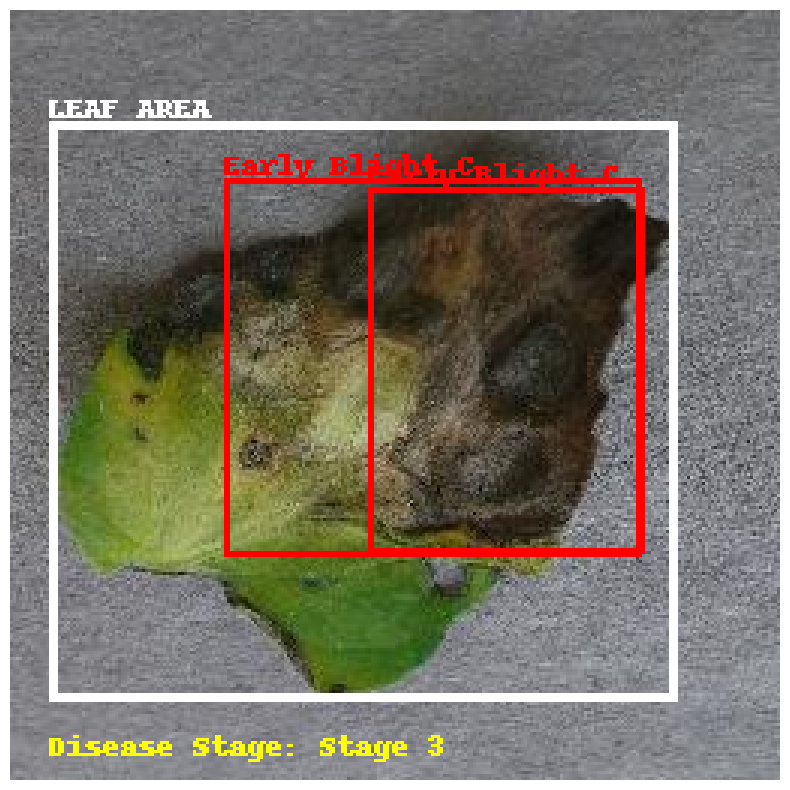

Processing Tomato_Early_blight62.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight62.jpg: 256x256 1 Tomato_Leaf, 133.7ms
Speed: 0.8ms preprocess, 133.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 3 Early Blight_Bs, 116.8ms
Speed: 1.2ms preprocess, 116.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


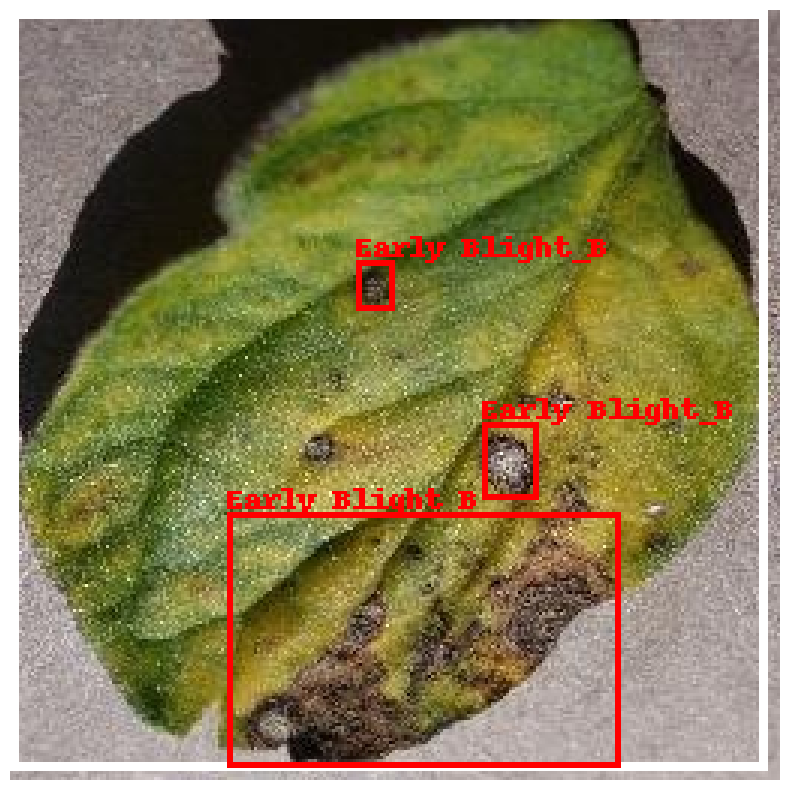

Processing Tomato_Bacterial_spot895.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot895.jpg: 256x256 1 Tomato_Leaf, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_C, 130.3ms
Speed: 1.5ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


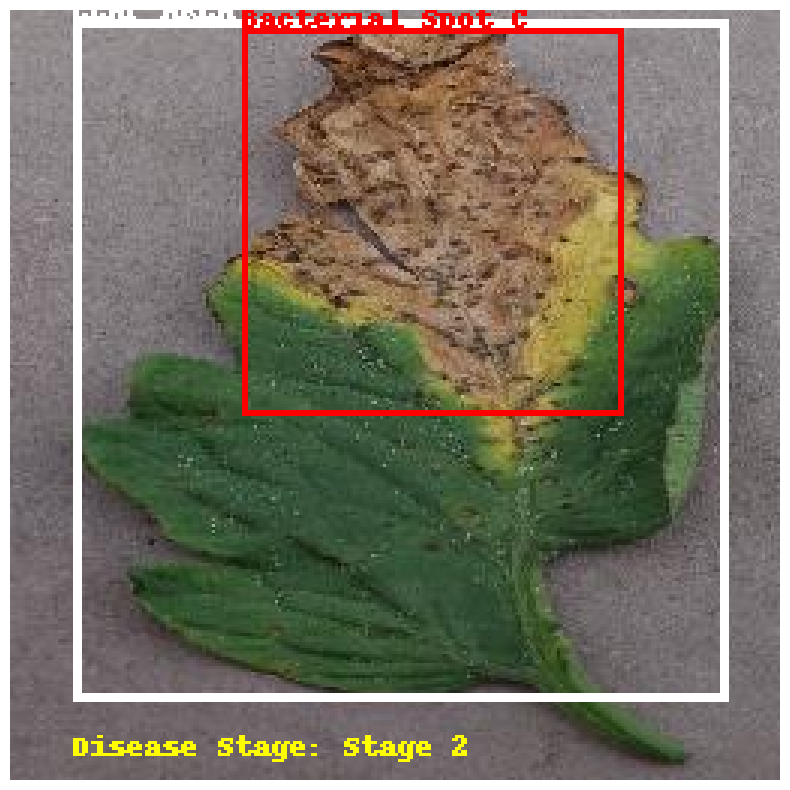

Processing Tomato_Early_blight16.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight16.jpg: 256x256 1 Tomato_Leaf, 182.1ms
Speed: 0.9ms preprocess, 182.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 190.7ms
Speed: 1.3ms preprocess, 190.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


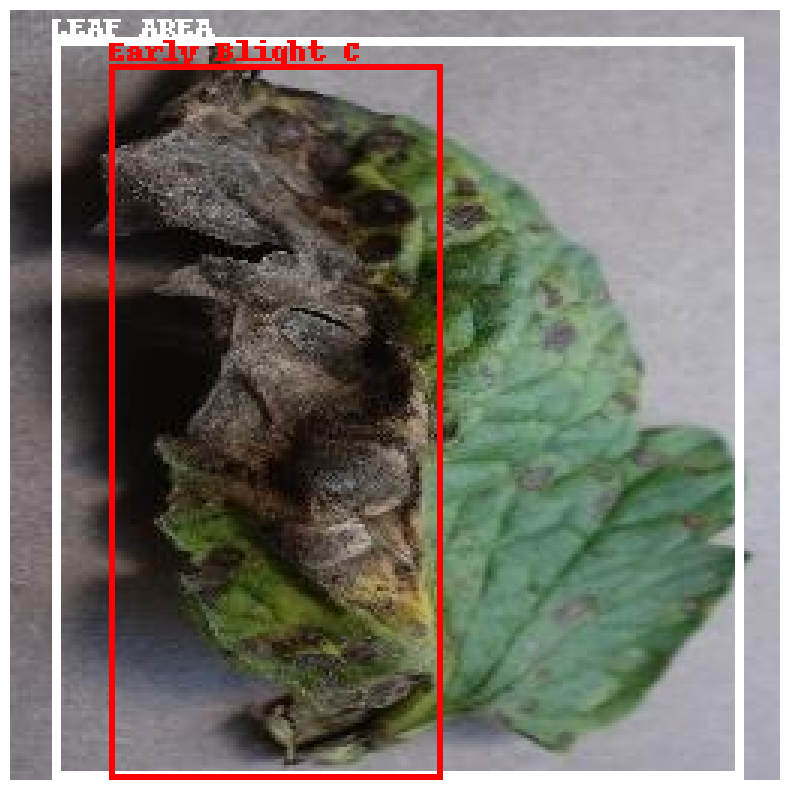

Processing Tomato_Bacterial_spot9.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot9.jpg: 256x256 1 Tomato_Leaf, 195.7ms
Speed: 0.9ms preprocess, 195.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Bacterial Spot_As, 121.8ms
Speed: 1.2ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


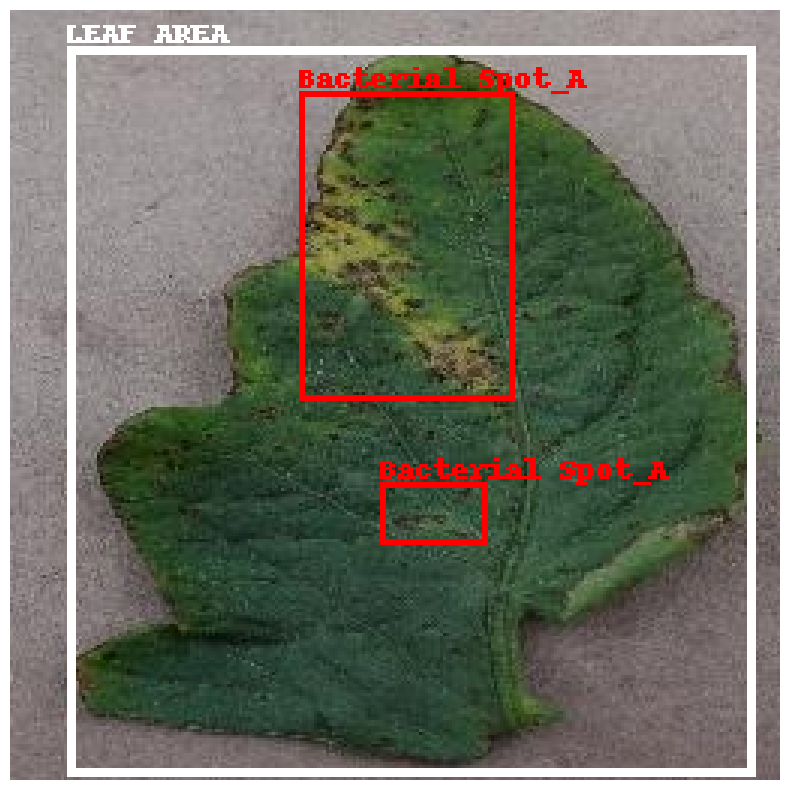

Processing Tomato_Early_blight175.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight175.jpg: 256x256 1 Tomato_Leaf, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 6 Early Blight_As, 125.4ms
Speed: 2.2ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


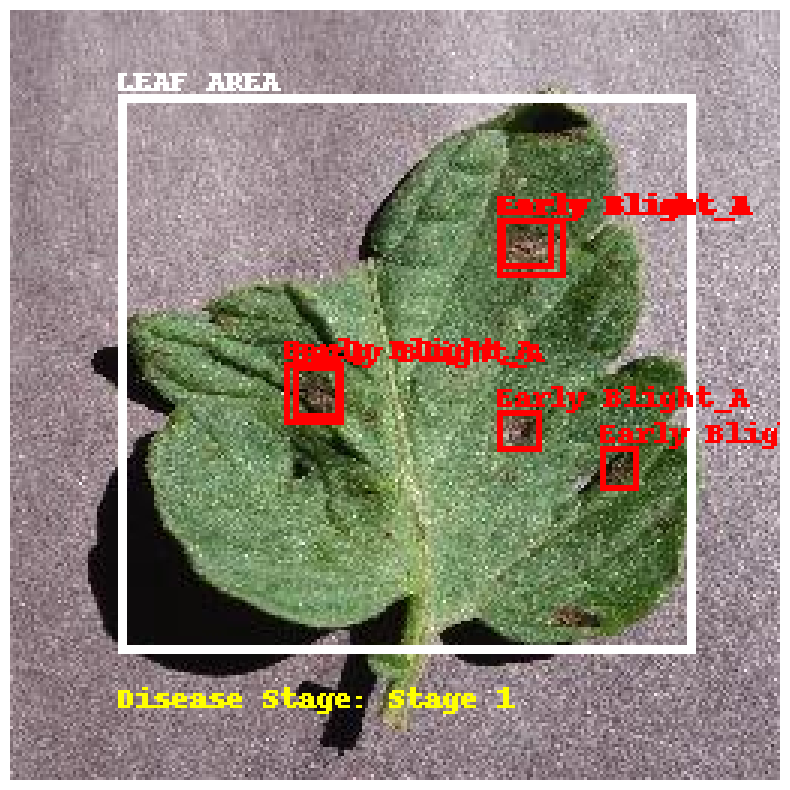

Processing Tomato_Bacterial_spot1031.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot1031.jpg: 256x256 1 Tomato_Leaf, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_B, 125.0ms
Speed: 1.4ms preprocess, 125.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


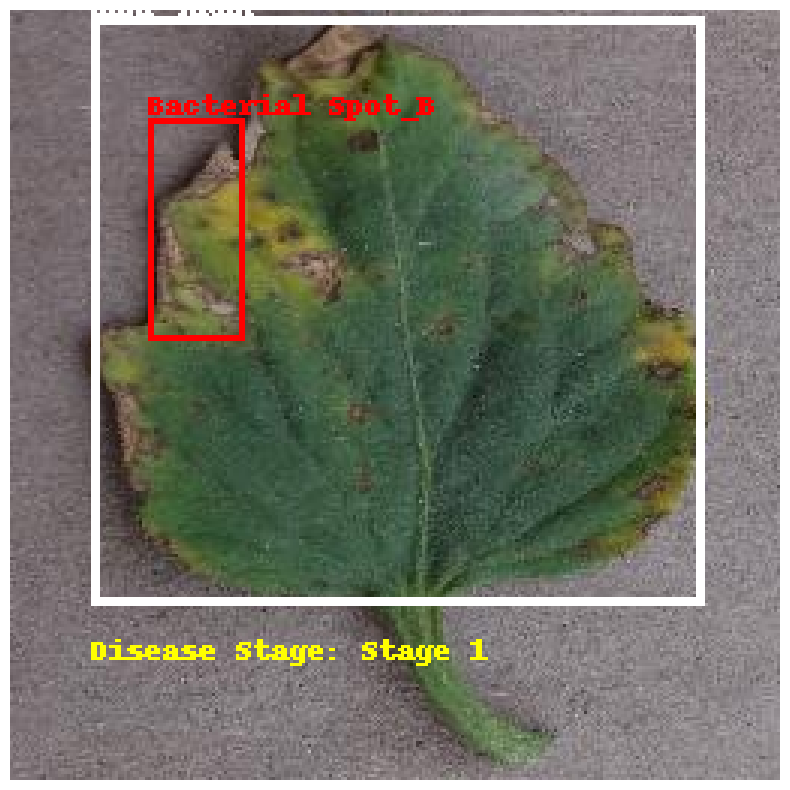

Processing Tomato_Early_blight14.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight14.jpg: 256x256 1 Tomato_Leaf, 196.1ms
Speed: 1.0ms preprocess, 196.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 160.2ms
Speed: 1.9ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


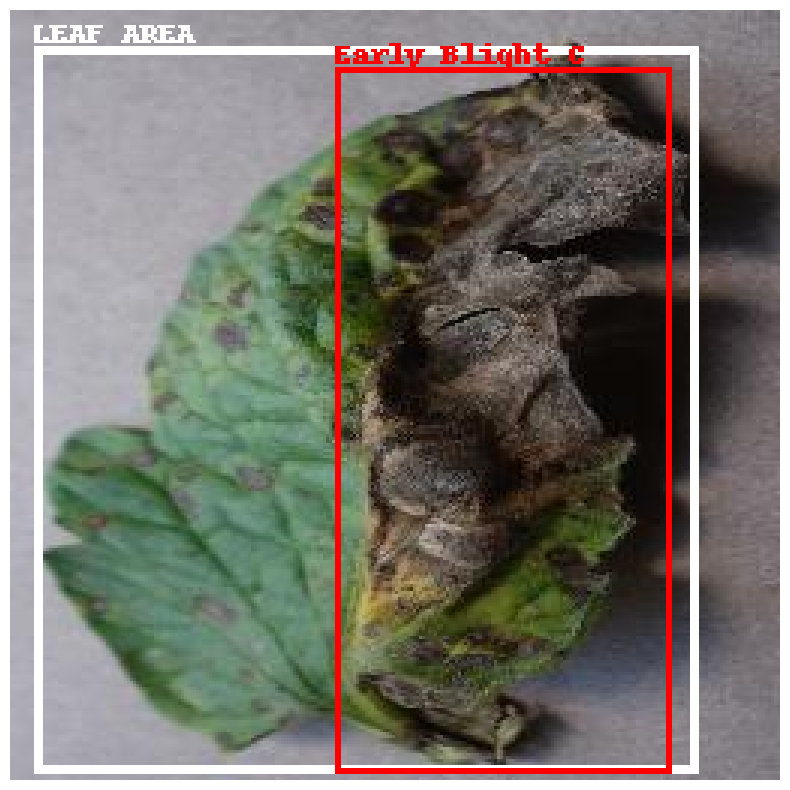

Processing Tomato_Septoria_leaf_spot327.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot327.jpg: 256x256 1 Tomato_Leaf, 197.4ms
Speed: 0.9ms preprocess, 197.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 13 Septoria Spot_Bs, 129.7ms
Speed: 1.2ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 2


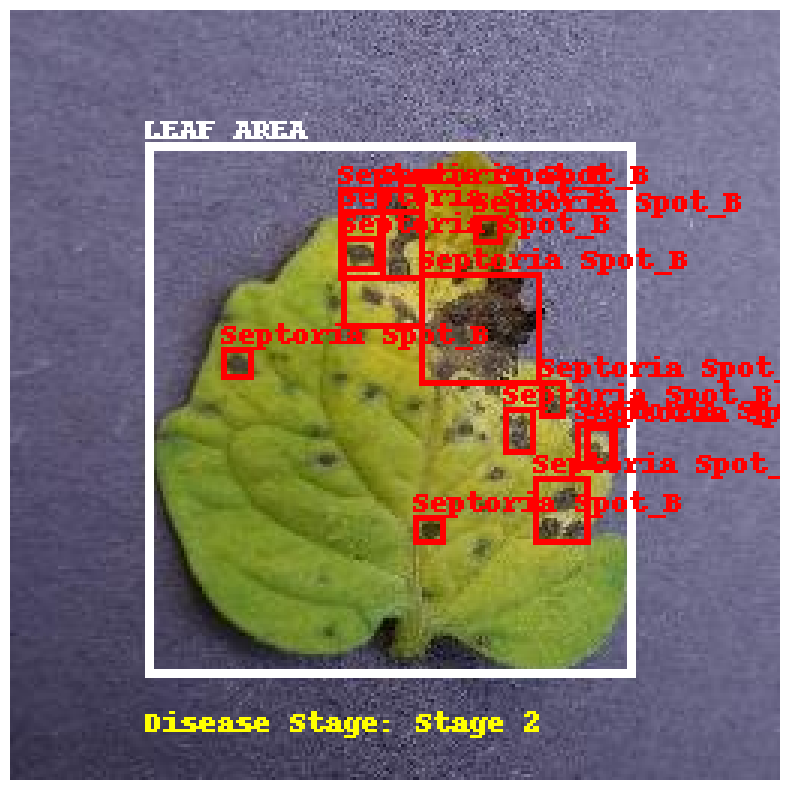

Processing Tomato_Late_blight108.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight108.jpg: 256x256 1 Tomato_Leaf, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_A, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


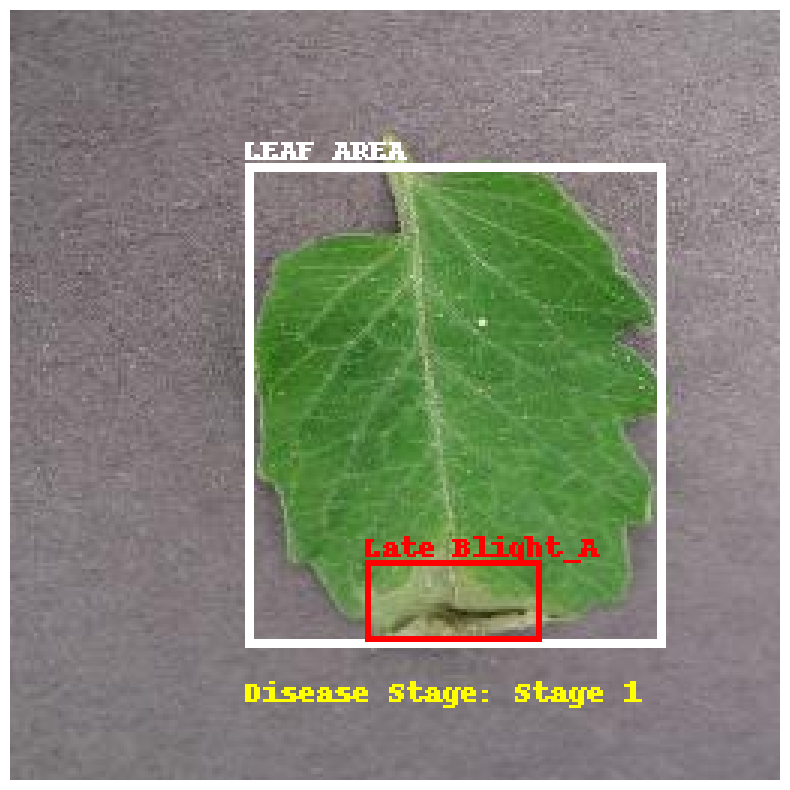

Processing Tomato_Late_blight170.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight170.jpg: 256x256 1 Tomato_Leaf, 122.7ms
Speed: 0.8ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_B, 115.0ms
Speed: 2.5ms preprocess, 115.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


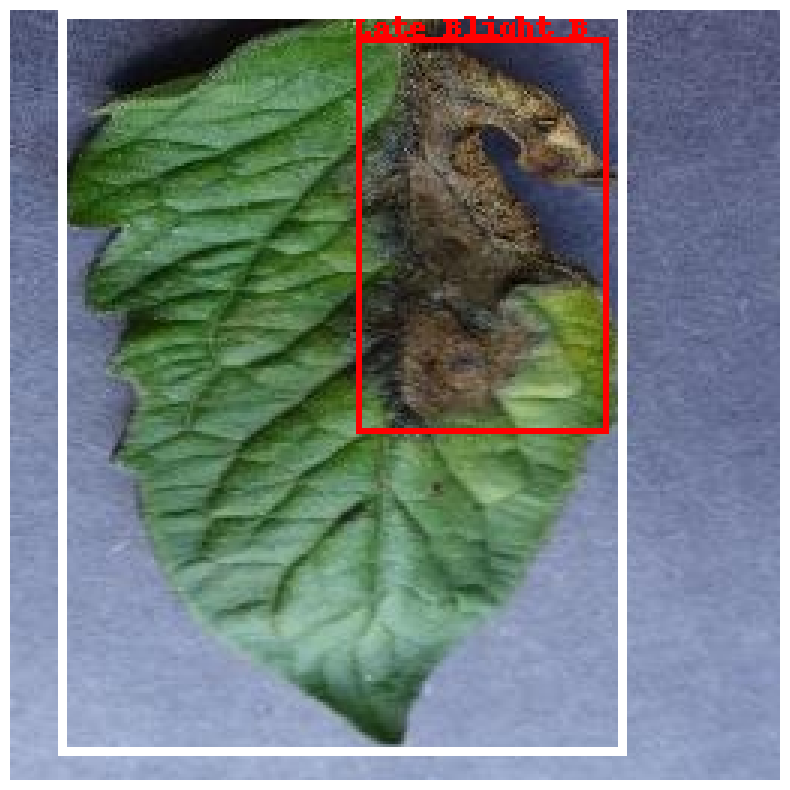

Processing Tomato_Septoria_leaf_spot248.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Septoria_leaf_spot248.jpg: 256x256 1 Tomato_Leaf, 186.3ms
Speed: 0.8ms preprocess, 186.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 224x256 1 Septoria Spot_C, 185.8ms
Speed: 1.1ms preprocess, 185.8ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)
Detected leaf with disease stage: Stage 1


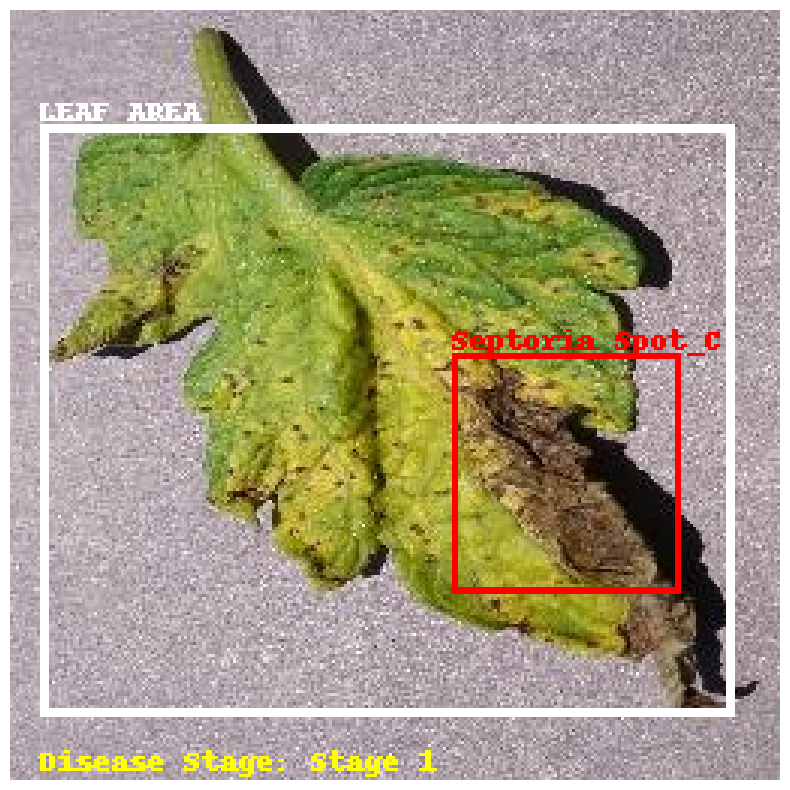

Processing Tomato_Early_blight180.jpg_Horizontally_flip.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight180.jpg_Horizontally_flip.jpg: 256x256 1 Tomato_Leaf, 195.9ms
Speed: 0.9ms preprocess, 195.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Early Blight_B, 125.0ms
Speed: 1.1ms preprocess, 125.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


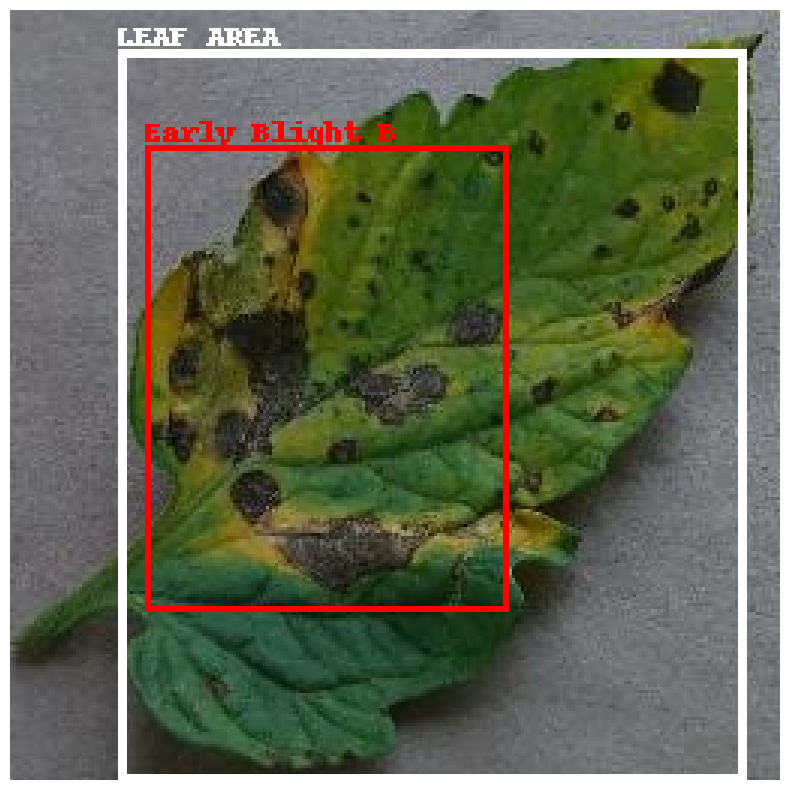

Processing Tomato_Late_blight34.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight34.jpg: 256x256 1 Tomato_Leaf, 142.5ms
Speed: 0.8ms preprocess, 142.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 129.4ms
Speed: 2.3ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


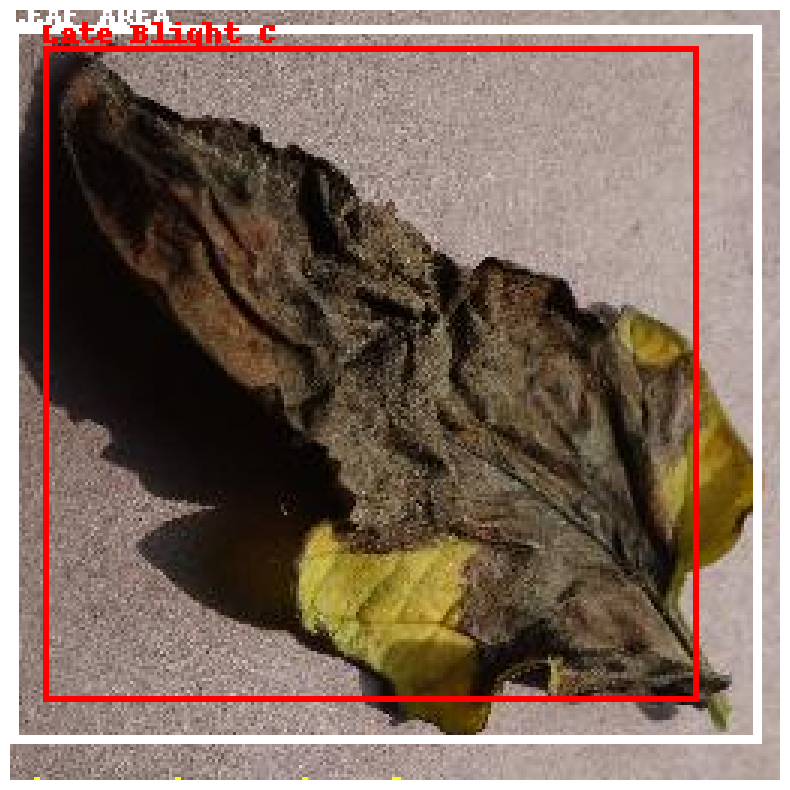

Processing Tomato_Bacterial_spot3.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot3.jpg: 256x256 1 Tomato_Leaf, 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 8 Bacterial Spot_As, 135.9ms
Speed: 1.1ms preprocess, 135.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


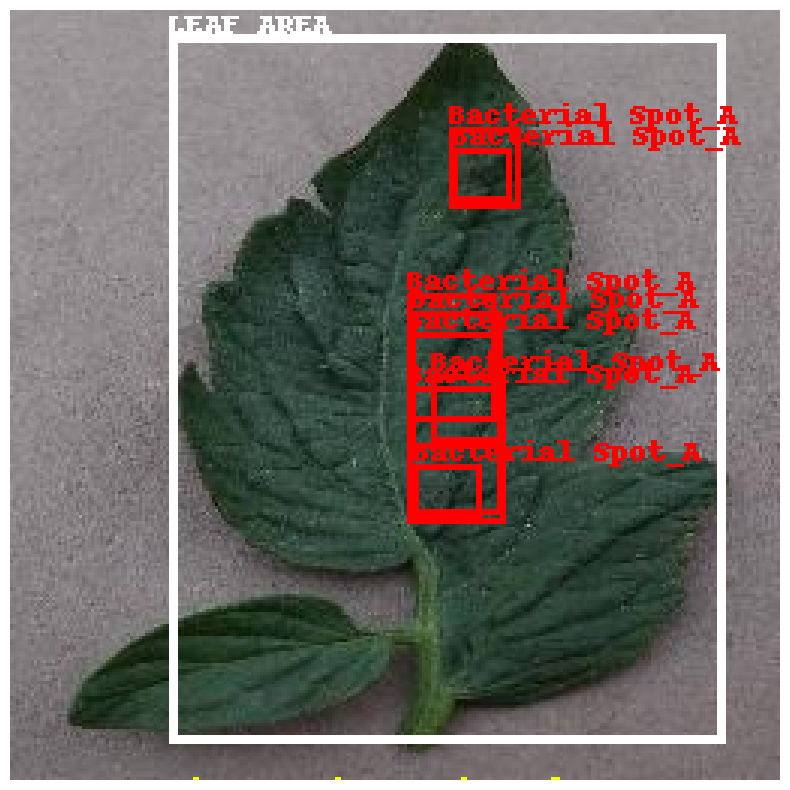

Processing Tomato_Late_blight51.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight51.jpg: 256x256 1 Tomato_Leaf, 191.2ms
Speed: 0.9ms preprocess, 191.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 181.2ms
Speed: 1.5ms preprocess, 181.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


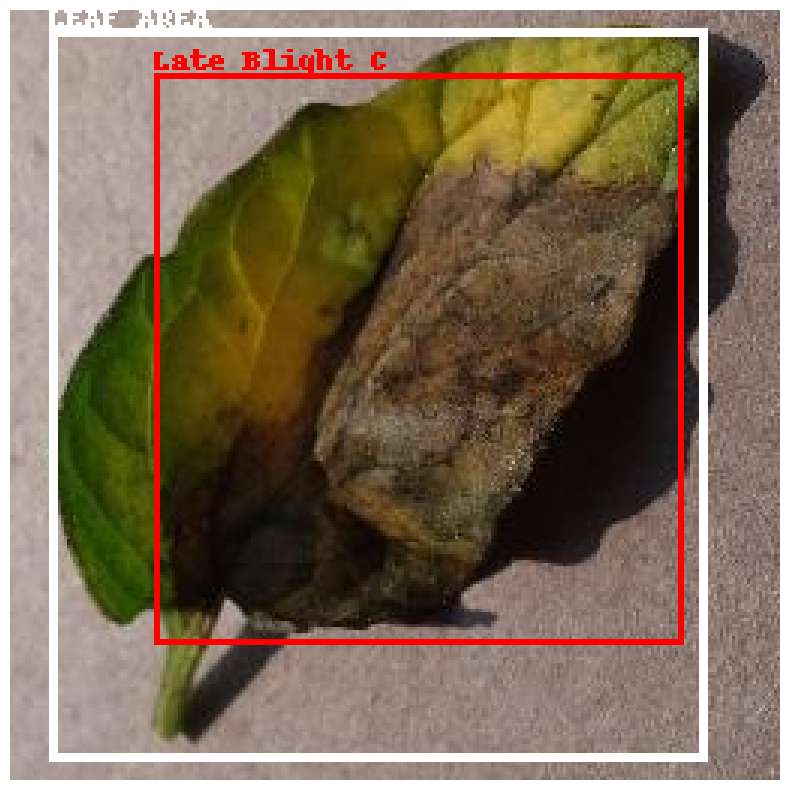

Processing Tomato_Early_blight221.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight221.jpg: 256x256 1 Tomato_Leaf, 221.7ms
Speed: 1.0ms preprocess, 221.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Early Blight_C, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


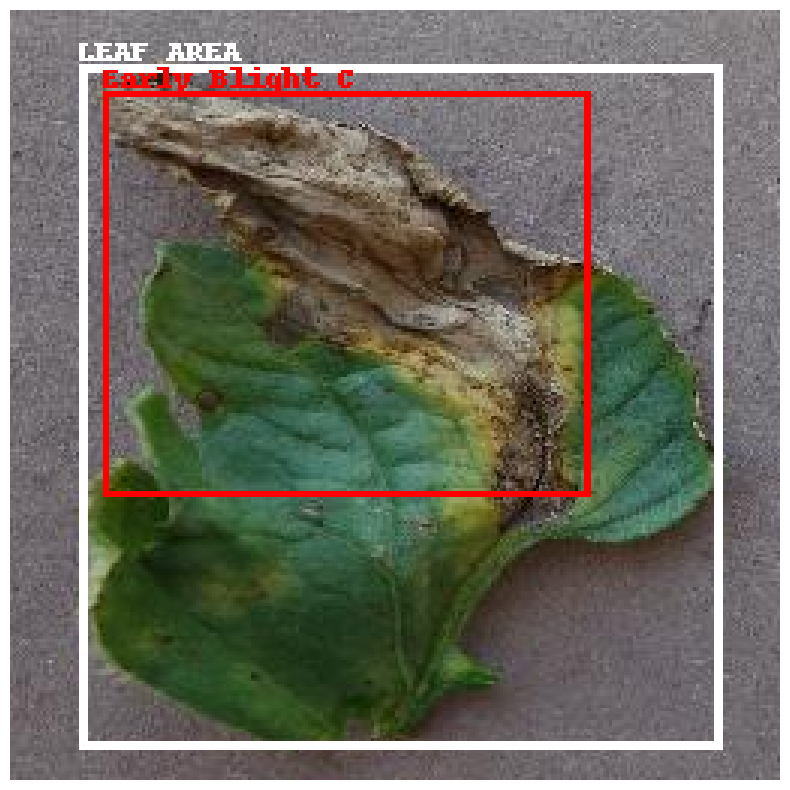

Processing Tomato_Late_blight169.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight169.jpg: 256x256 1 Tomato_Leaf, 137.5ms
Speed: 0.8ms preprocess, 137.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 1 Late Blight_B, 128.2ms
Speed: 1.4ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 2


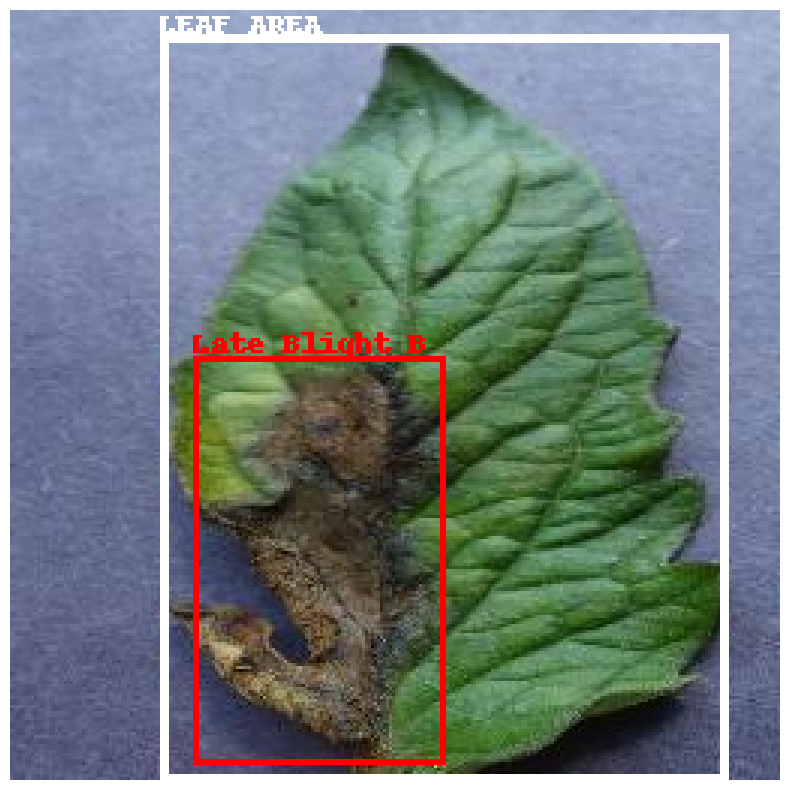

Processing Tomato_Late_blight363.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Late_blight363.jpg: 256x256 1 Tomato_Leaf, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Late Blight_C, 140.5ms
Speed: 1.5ms preprocess, 140.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


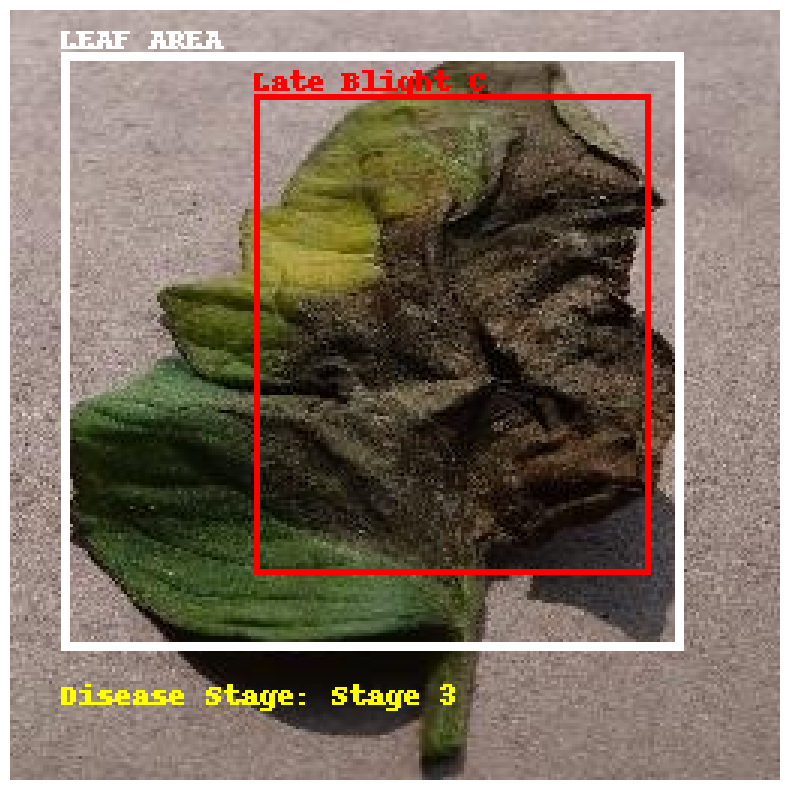

Processing Tomato_Bacterial_spot11.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot11.jpg: 256x256 1 Tomato_Leaf, 221.1ms
Speed: 1.0ms preprocess, 221.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 1 Bacterial Spot_A, 212.1ms
Speed: 1.2ms preprocess, 212.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 1


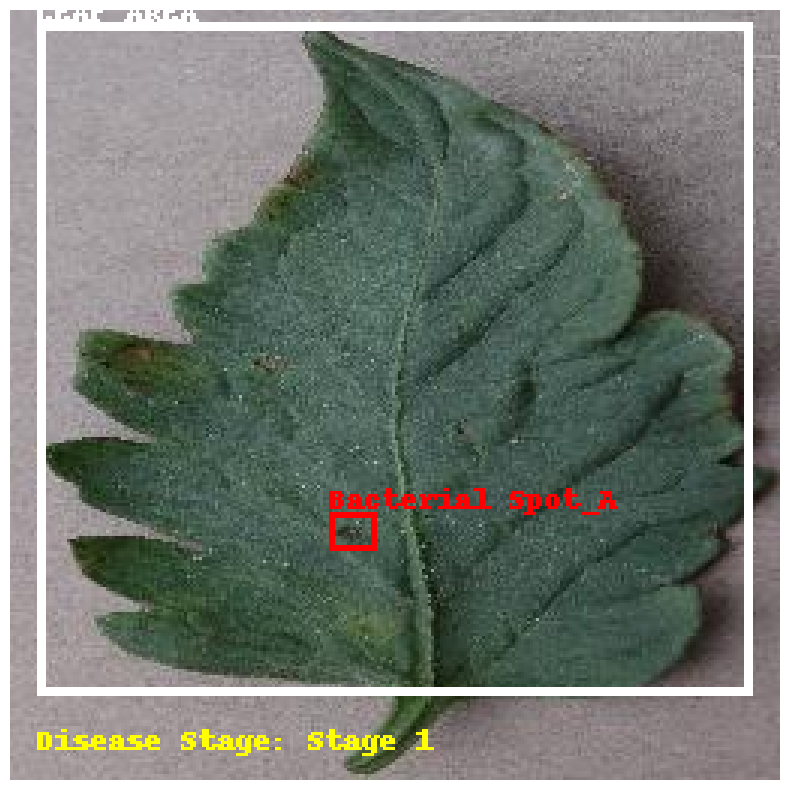

Processing Tomato_Bacterial_spot1.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Bacterial_spot1.jpg: 256x256 1 Tomato_Leaf, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)

0: 256x224 7 Bacterial Spot_As, 134.5ms
Speed: 1.2ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)
Detected leaf with disease stage: Stage 1


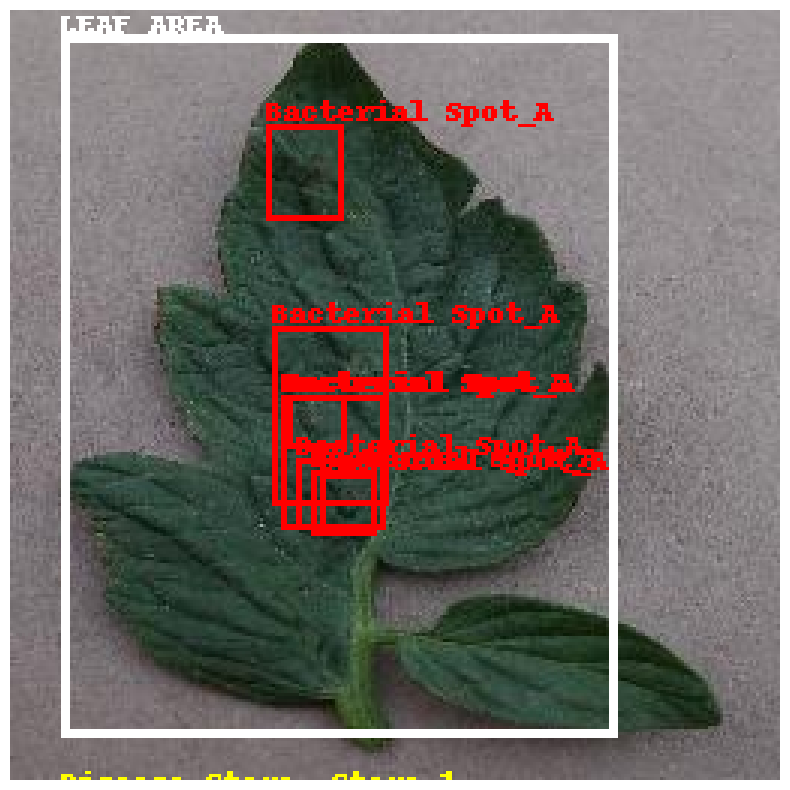

Processing Tomato_Early_blight63.jpg...

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Yv8 - TEST/STAGE TEST IMAGES/Tomato_Early_blight63.jpg: 256x256 1 Tomato_Leaf, 137.8ms
Speed: 0.8ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)

0: 256x256 2 Early Blight_Bs, 142.5ms
Speed: 1.2ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)
Detected leaf with disease stage: Stage 3


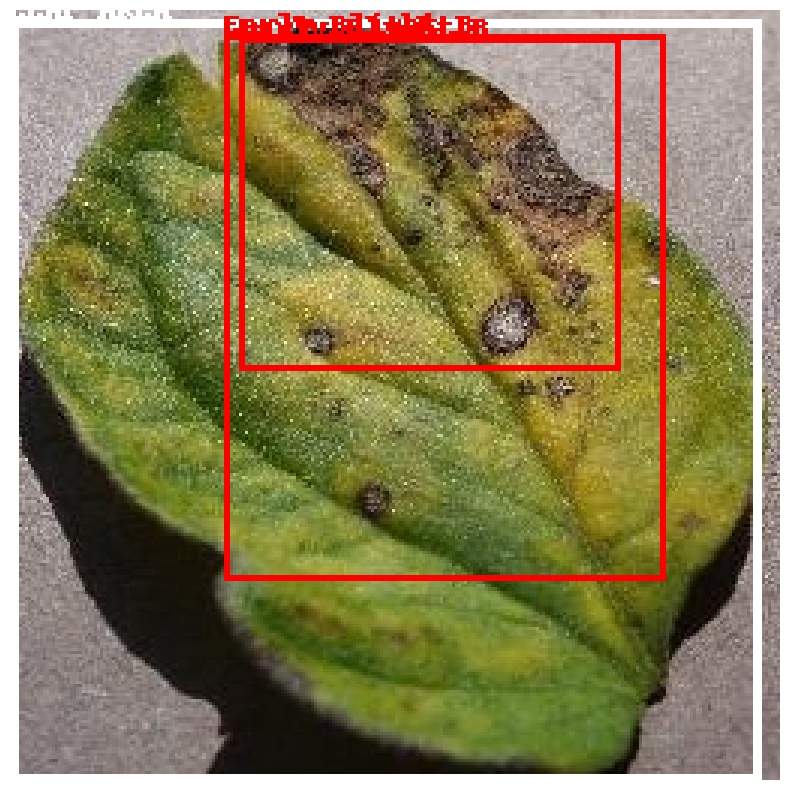

Accuracy: 0.8
Confusion Matrix:
[[ 8  1  0]
 [ 1  6  1]
 [ 1  2 10]]
Classification Report:
              precision    recall  f1-score   support

     Stage 1       0.80      0.89      0.84         9
     Stage 2       0.67      0.75      0.71         8
     Stage 3       0.91      0.77      0.83        13

    accuracy                           0.80        30
   macro avg       0.79      0.80      0.79        30
weighted avg       0.81      0.80      0.80        30



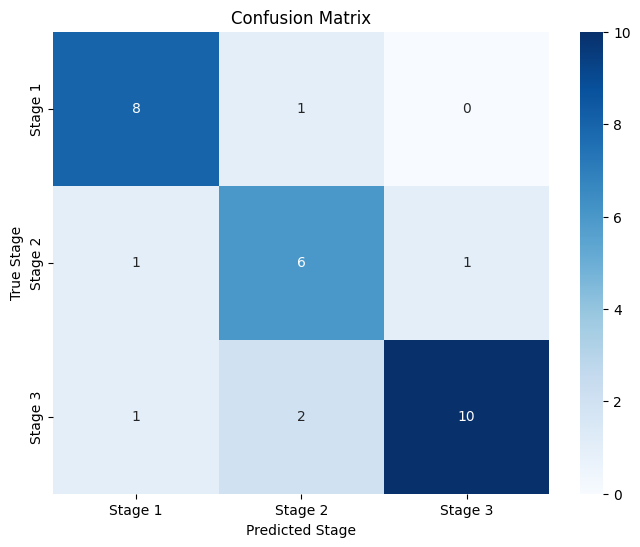

In [ ]:
evaluate_pipeline_on_test_images(test_folder)

1/1 [==============================] - 1s 1s/step
[[          1  4.1894e-08   3.629e-13]]
0
Tomato_Diseased
DISEASED LEAF DETECTED: ACTIVATING STAGE II : DISEASE STAGE DETECTION

image 1/1 /content/drive/MyDrive/ACPS PROJECT - MSDS/DATASETS/MSDS-Iv3/test/Tomato_Early_blight186.jpg_Horizontally_flip.jpg: 256x256 2 Early Blight_Stage-3s, 11.4ms
Speed: 4.8ms preprocess, 11.4ms inference, 3811.2ms postprocess per image at shape (1, 3, 256, 256)


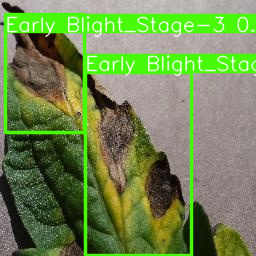

In [ ]:
from PIL import Image
tomato_analysis_pipeline(image_path)